In [8]:
import pylab as plt
import matplotlib.pyplot as plt
import numpy as np
import h5py
import shutil
import pdb
import datetime
import os
from operator import truediv
import operator
from scipy.optimize import curve_fit
import matplotlib.cm as cm
from scipy.optimize import leastsq

%pylab
%matplotlib inline
%load_ext autoreload
%autoreload 2



Using matplotlib backend: Qt4Agg
Populating the interactive namespace from numpy and matplotlib
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


`%matplotlib` prevents importing * from pylab and numpy


In [9]:
corr_list = [4,11,17,22,27,28,29]
freq_phase = np.linspace(400,800,1024)
colors=['r','g','b','k','c','y','m']
legend_crosscorr = ["(0,4) A63","(1,4) A00","(2,4) A48","(3,4) A31","(5,4) B00","(6,4) B63","(7,4) B48"]

freq=462
num =14

In [10]:
def mag(tot_frames,corr_files):
        tot_magnitude = np.zeros((tot_frames, len(corr_list), len(freq_phase[50:990])))
        tot_magnitude_ref = np.zeros((tot_frames, 2, len(freq_phase[50:990])))
        x=0
        for corr_file in corr_files:
                for i in range(len(corr_list)):
                        frames =  corr_file['vis'][:].shape[0]
                        tot_magnitude[x:x+frames,i,:] = (np.sqrt(corr_file['vis'][:][:,corr_list[i],50:990]['imag'].astype(np.float)**2 + corr_file['vis'][:][:,corr_list[i],50:990]['real'].astype(np.float)**2))
                tot_magnitude_ref[x:x+frames,0,:] = np.sqrt(corr_file['vis'][:][:,26,50:990]['imag'].astype(np.float)**2 + corr_file['vis'][:][:,27,50:990]['real'].astype(np.float)**2)
                tot_magnitude_ref[x:x+frames,1,:] = corr_file['vis'][:][:,27,50:990]
                x = x + frames

        return tot_magnitude,tot_magnitude_ref

In [11]:
def gain_freq(corr_files,tot_frames,visibility, visibility_ref):
        x=0
        gain_1 = np.zeros((tot_frames, len(corr_list), len(freq_phase[50:990])))
        for corr_file in corr_files:
                frames = corr_file['vis'][:].shape[0]
                gain = np.zeros((frames, len(corr_list), len(freq_phase[50:990])))
                for i in range(len(corr_list)):
                        gain_1[x:frames+x,i,:] = 20*np.log10(np.sqrt(corr_file['vis'][:][:,corr_list[i],50:990]['imag'].astype(np.float)**2 + corr_file['vis'][:][:,corr_list[i],50:990]['real'].astype(np.float)**2)/(np.sqrt(corr_file['vis'][:][:,26,50:990]['imag'].astype(np.float)**2 + corr_file['vis'][:][:,26,50:990]['real'].astype(np.float)**2)))
                x=frames+x

        return gain_1[:,:,::-1]

In [12]:
def delay_unwrap(tot_frames,corr_files):
        delay = np.zeros((tot_frames,len(corr_list)))
        #phi = np.zeros((frames, len(corr_list), len(freq_phase[20:990])))# not taking some frequency bins
        kk=0
        delay_freq_bad_frame = np.zeros((len(corr_list),len(freq_phase[50:990])))
        for corr_file in corr_files:
                vis = corr_file['vis'][:][:,corr_list,50:990]
                frames = corr_file['vis'][:].shape[0]
                vis_abs =  np.sqrt((vis['imag']).astype(np.float)**2+(vis['real']).astype(np.float)**2)
                vis_abs =  np.sqrt((vis['imag']).astype(np.float)**2+(vis['real']).astype(np.float)**2)
                phi = np.arctan2((vis['imag']),(vis['real']))
                unwrap_phase_1 = np.unwrap(phi)
                unwrap_phase = unwrap_phase_1[:,::-1]/(2*np.pi)
                slope = [[0 for x in range(len(corr_list))] for y in range(frames)]
                for j in range(len(corr_list)):
                        slope_1 = []
                        for i in range(frames):
                                slope[i],b = np.polyfit(freq_phase[50:990]*10**6,unwrap_phase[i][j][:],1)
                                if slope[i]<0:
                                        slope[i] = slope[i]*(-1.0)
                        delay[kk:kk+frames,j] = slope
                kk=kk+frames
                #pdb.set_trace()
        return np.array(delay),unwrap_phase #

In [13]:
def get_timestamp(tot_frames,corr_files):
        cpu_cycle = np.zeros(tot_frames)
        x = 0
        for corr_file in corr_files:
                frame = corr_file['vis'][:].shape[0]
                timestamp = corr_file['timestamp']
                cpu_cycle[x:x+frame] = [time[1] for time in timestamp]
                x=x+frame
        return cpu_cycle


In [14]:
def data(chan):
        number_of_frame = corr_file['vis'][:].shape[0]
        print('Number of frames:' + str(number_of_frame))
        return number_of_frame

In [15]:
para=3
def quadratic(x,*p):
        freq_reqd = freq
        return p[0]*x**2 + p[1]*x+  p[2]

In [16]:
def sinusoidal(x,*p):
        freq_reqd = freq
        return p[0]*x + p[1]*(np.cos(2*np.pi*p[2]))#+ np.cos(2*np.pi*4/(0.84*3*10**2/freq_reqd)))

In [17]:
source_dir = ['C:/Users/sidhant/Desktop/data/20170407T194716Z_stone_corr/', 'C:/Users/sidhant/Desktop/data/20170410T180753Z_stone_corr/','C:/Users/sidhant/Desktop/data/20170414T020912Z_stone_corr/' ,'C:/Users/sidhant/Desktop/data/20170430T010748Z_stone_corr_one_file_deleted/', 'C:/Users/sidhant/Desktop/data/20170519T221539Z_stone_corr/' ,'C:/Users/sidhant/Desktop/data/20170525T174006Z_stone_corr_two_files_delated/'] #Apr 7-apr 10, #Apr 10-APR 13 #Apr 29 - May14
tot_frames = 0
corr_files=[]
for d in range(len(source_dir)):
    source_directory = source_dir[d]
    source_name = os.path.realpath(source_directory).split('/')[-1]
    active_dir = source_dir[d]
    all_file_names = os.listdir(active_dir)
    data_file_names = []
    for file_name in all_file_names:
        if ('.lock' not in file_name) and ('.h5' in file_name):
                data_file_names.append(file_name)
    data_file_names.sort()
    for file_name in data_file_names:
        corr_files.append(h5py.File(active_dir+file_name,'r'))

for corr_file in corr_files:
    frames = data(corr_list)
    tot_frames = tot_frames + frames
    

print(corr_files)
visibility, visibility_ref = mag(tot_frames,corr_files)
delay, unwrap_phase = delay_unwrap(tot_frames,corr_files)
# the return gain is in db/logrithmic
gain_all_db = gain_freq(corr_files,tot_frames,visibility, visibility_ref)

time_stamp = get_timestamp(tot_frames,corr_files)
date_stamp = [datetime.datetime.fromtimestamp(time) + datetime.timedelta(hours = -7) for time in time_stamp]

Number of frames:360
Number of frames:61
Number of frames:360
Number of frames:119
Number of frames:360
Number of frames:360
Number of frames:360
Number of frames:264
Number of frames:360
Number of frames:360
Number of frames:54
Number of frames:360
[<HDF5 file "00000000_0000.h5" (mode r)>, <HDF5 file "00216004_0000.h5" (mode r)>, <HDF5 file "00000000_0000.h5" (mode r)>, <HDF5 file "00216003_0000.h5" (mode r)>, <HDF5 file "00000000_0000.h5" (mode r)>, <HDF5 file "00000000_0000.h5" (mode r)>, <HDF5 file "00648000_0000.h5" (mode r)>, <HDF5 file "00863999_0000.h5" (mode r)>, <HDF5 file "00000000_0000.h5" (mode r)>, <HDF5 file "00216003_0000.h5" (mode r)>, <HDF5 file "00432001_0000.h5" (mode r)>, <HDF5 file "00216003_0000.h5" (mode r)>]


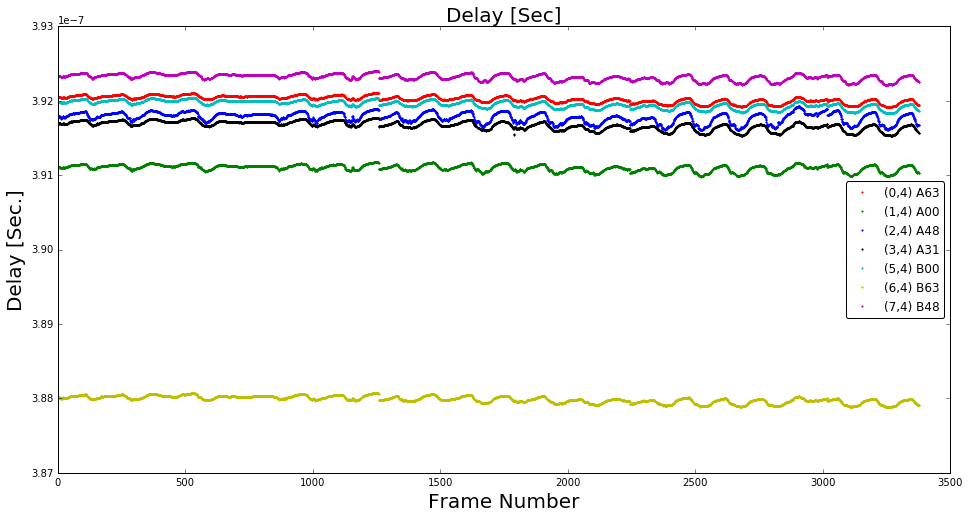

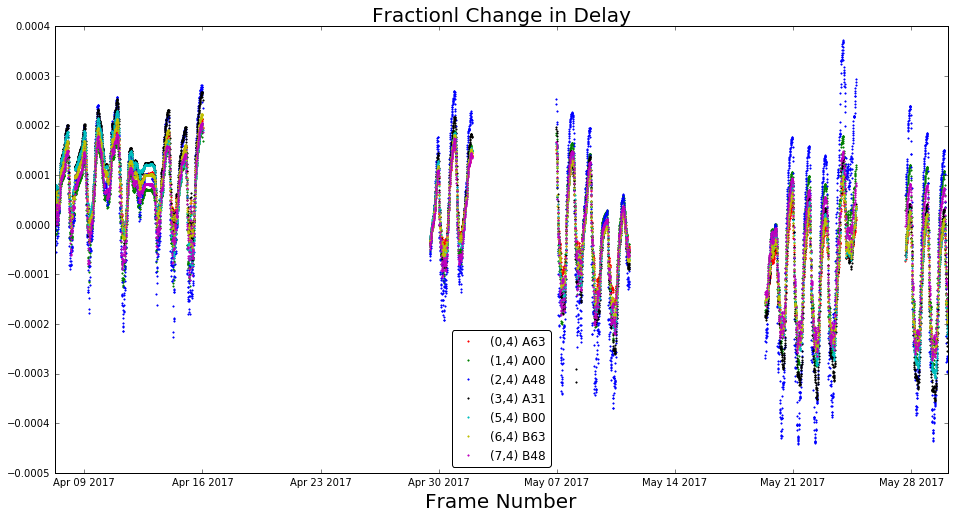

In [18]:
figure(figsize(16,8))
#plt.title('Delay [Sec.]', size=20)
plt.ylabel('Delay [Sec.]', size =20)
plt.xlabel('Frame Number', size=20)
k=1; dd=1; k=0

for i in range (len(corr_list)):  
    #print(i)
    plt.plot(delay[:,i], '.', color = colors[k], label = str(legend_crosscorr[k]), markersize = 3)
    plt.title('Delay [Sec]', size=20)
    legend(loc='best', numpoints=1, fancybox=True)
    k=k+1

figure(figsize(16,8))
k=0
for i in range (len(corr_list)): 
    #print(np.mean(delay[:,i]))
    plt.plot(date_stamp,(delay[:,i] - np.mean(delay[:,i]))/np.mean(delay[:,i]), '.', color = colors[k], label = str(legend_crosscorr[k]), markersize = 3)
    plt.title('Fractionl Change in Delay', size=20)
    plt.xlabel('Frame Number', size=20)
    legend(loc='best', numpoints=1, fancybox=True)
    k=k+1

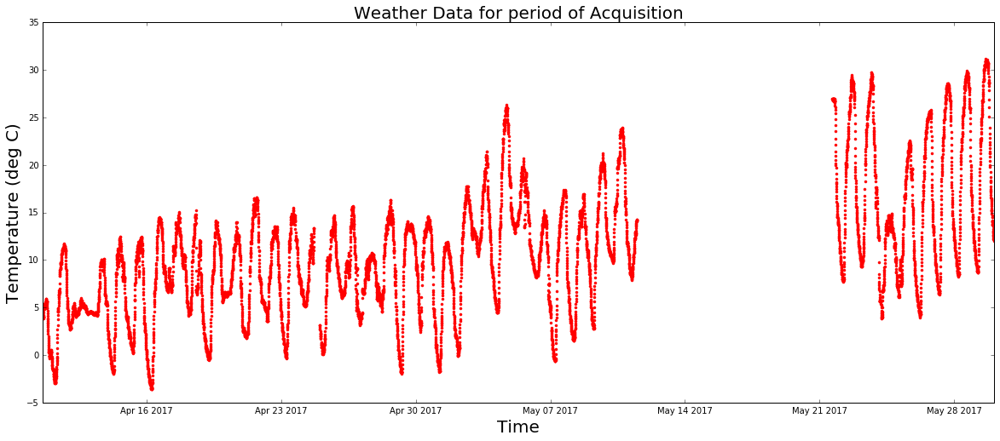

In [19]:
from IPython.display import Image
Image(filename='weather_data.png')

C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\matplotlib\axes\_axes.py:519: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


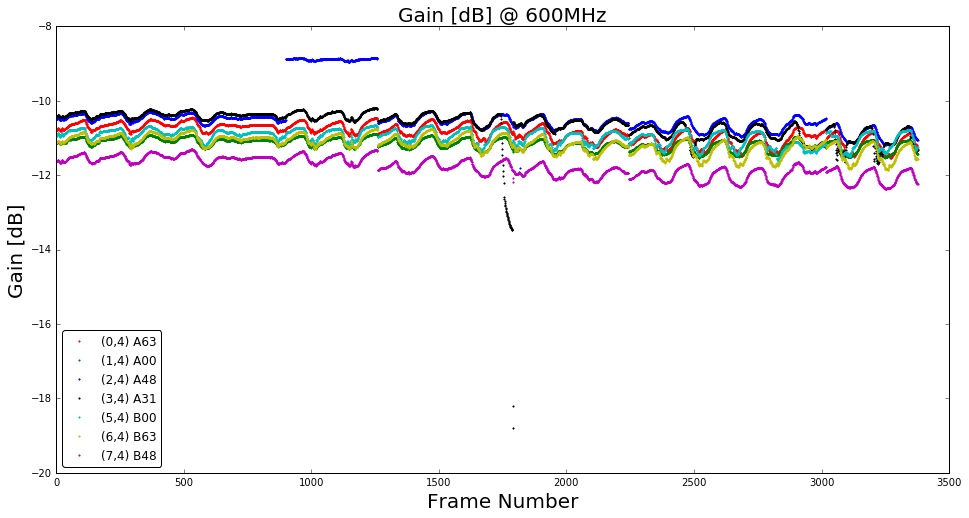

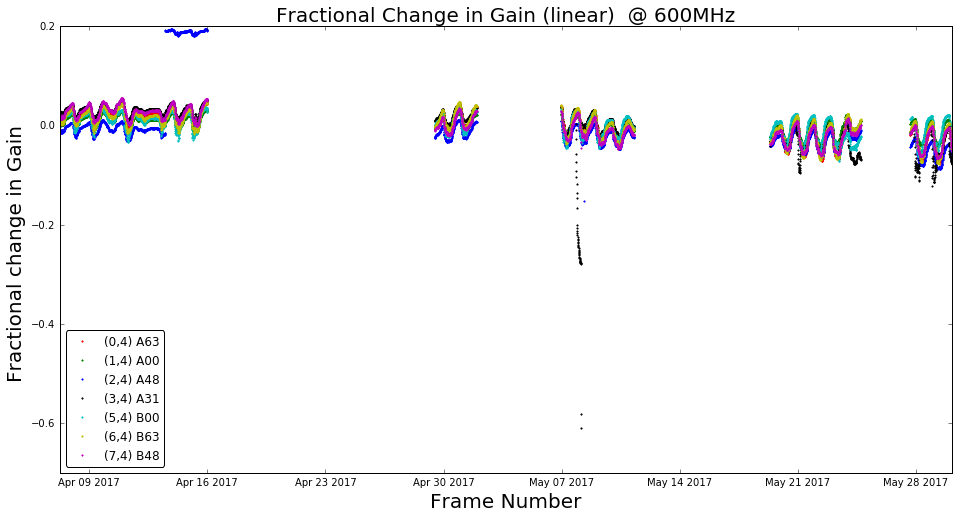

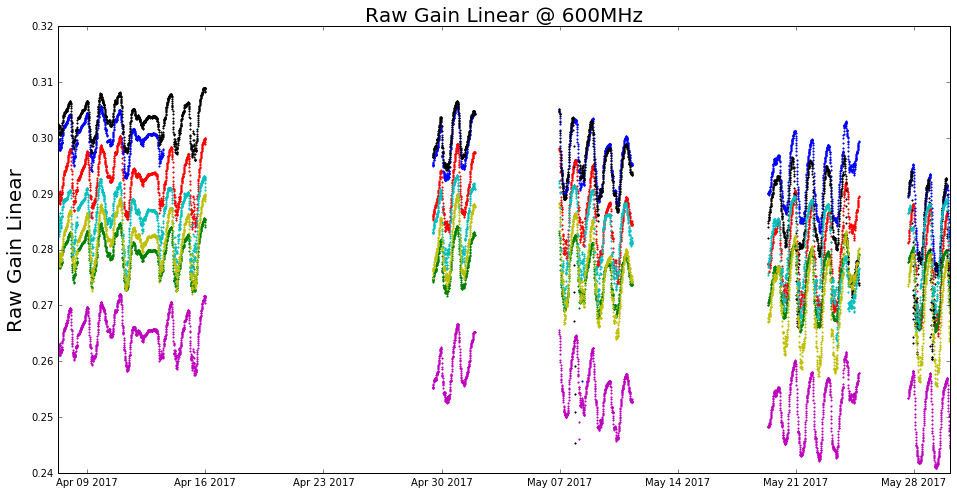

In [20]:
figure(figsize(16,8))
plt.title('Gain [dB] @ 600MHz', size=20)
plt.ylabel('Gain [dB]', size =20)
plt.xlabel('Frame Number', size=20)
dd=1; k=0
for i in range(len(corr_list)):
    plt.plot(gain_all_db[:,i,freq], '.', color = colors[k], label = str(legend_crosscorr[k]), markersize = 3)
    legend(loc='best', numpoints=1, fancybox=True)
    k=k+1

figure(figsize(16,8))
k=0
gain_all = 10**(gain_all_db/20)
for i in range(len(corr_list)):
    plt.plot(date_stamp,(gain_all[:,i,freq] - np.mean(gain_all[:,i,freq]))/np.mean(gain_all[:,i,freq]) , '.', color = colors[k], label = str(legend_crosscorr[k]), markersize = 3)
    legend(loc='best', numpoints=1, fancybox=True)
    plt.title('Fractional Change in Gain (linear)  @ 600MHz', size=20)
    plt.ylabel('Fractional change in Gain ', size =20)
    plt.xlabel('Frame Number', size=20)
    k=k+1

k=0
plt.figure()
for i in range(len(corr_list)):
    plt.plot(date_stamp,gain_all[:,i,freq],'.',color = colors[k] , markersize = 3)
    legend(loc='best', numpoints=1, fancybox=True)
    plt.title('Raw Gain Linear @ 600MHz', size=20)
    plt.ylabel('Raw Gain Linear', size =20)
    #plt.xlabel('Frame Number', size=20)
    
    plt.ylim(0.24,0.32)
    
    
    k=k+1   

In [1]:
# encountering the mean for different acquisitions and different cables

C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\numpy\core\_methods.py:59: RuntimeWarning: Mean of empty slice.
  warnings.warn("Mean of empty slice.", RuntimeWarning)
C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\numpy\core\_methods.py:70: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


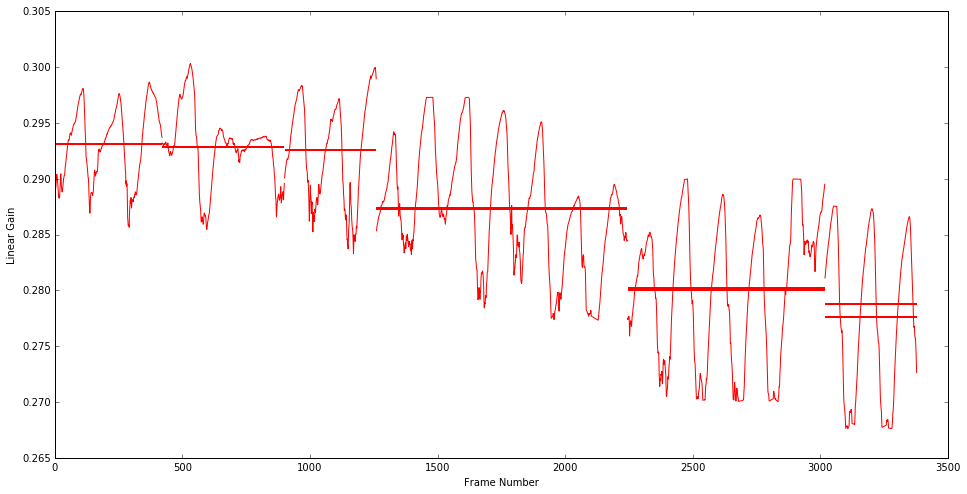

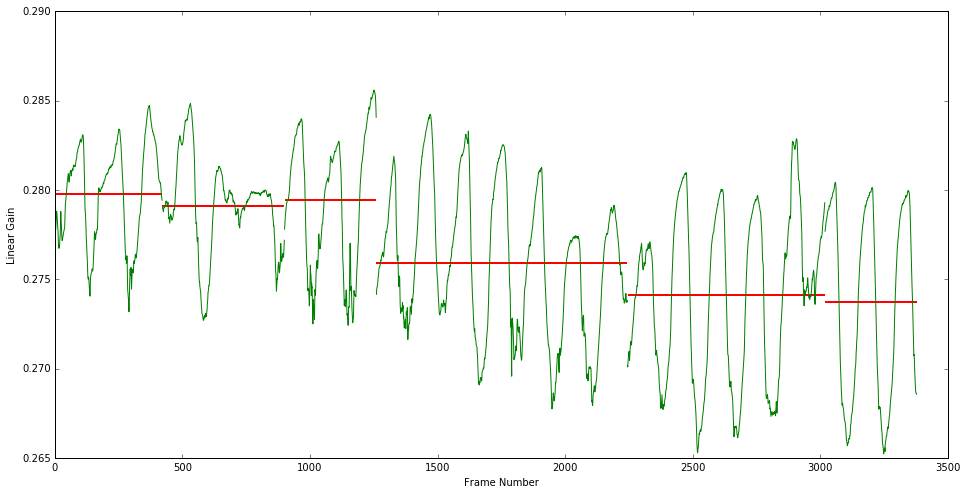

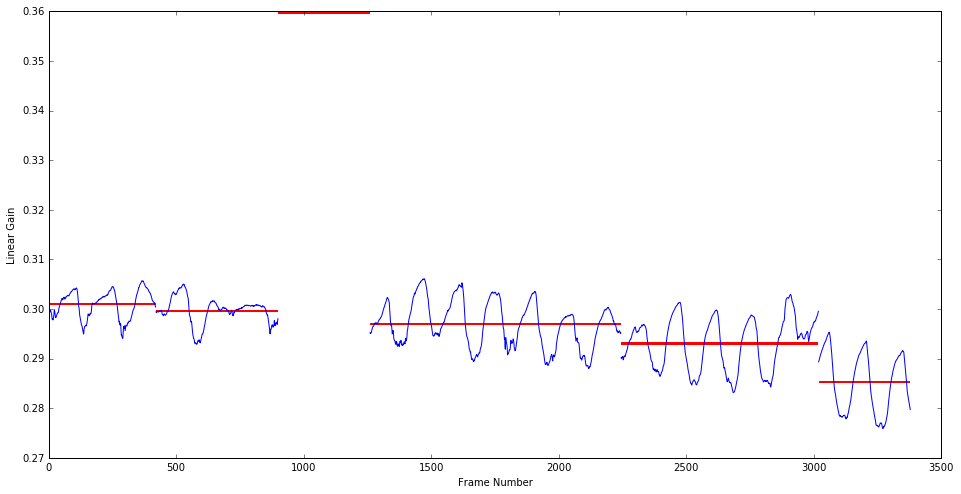

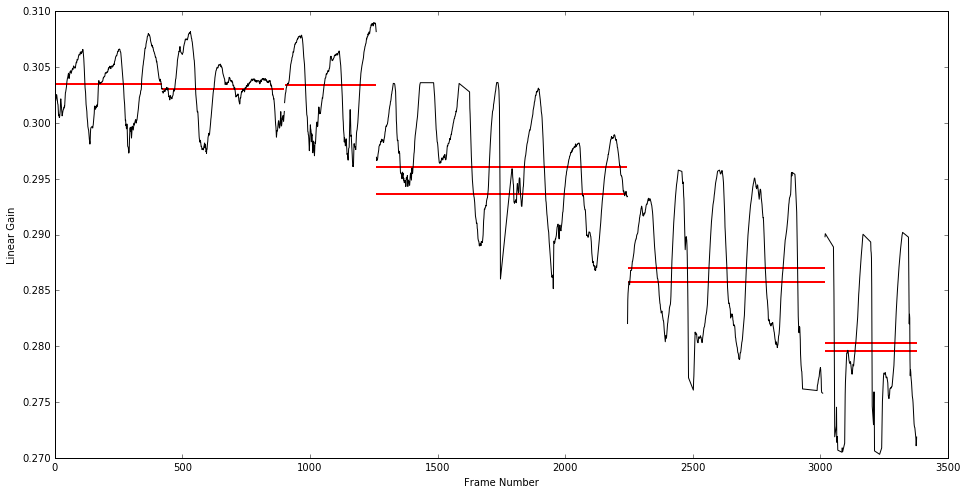

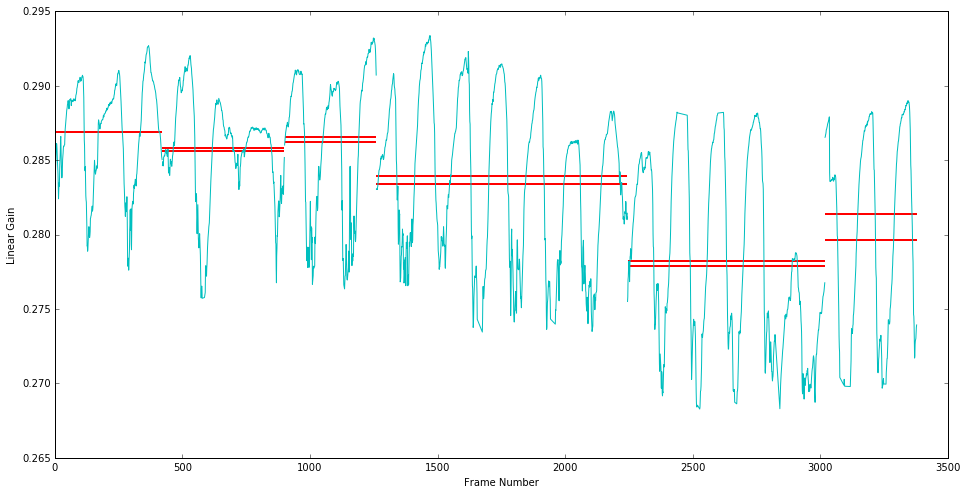

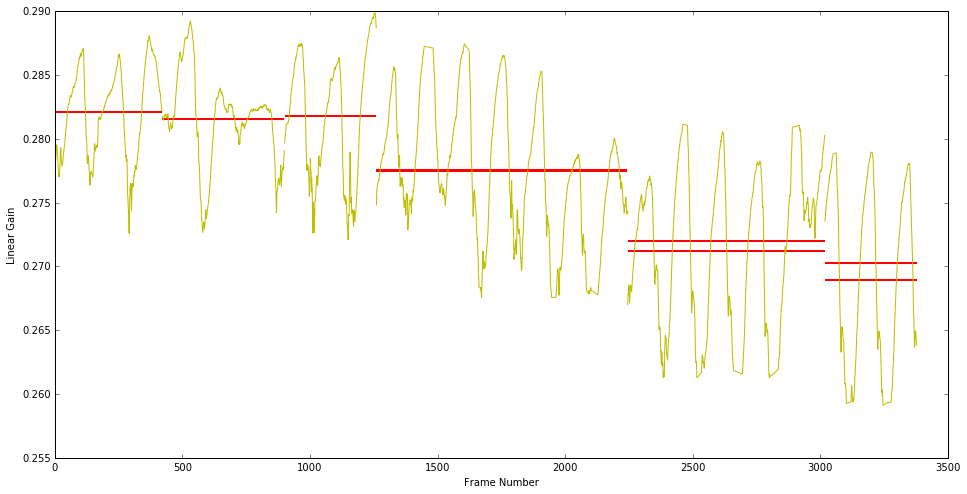

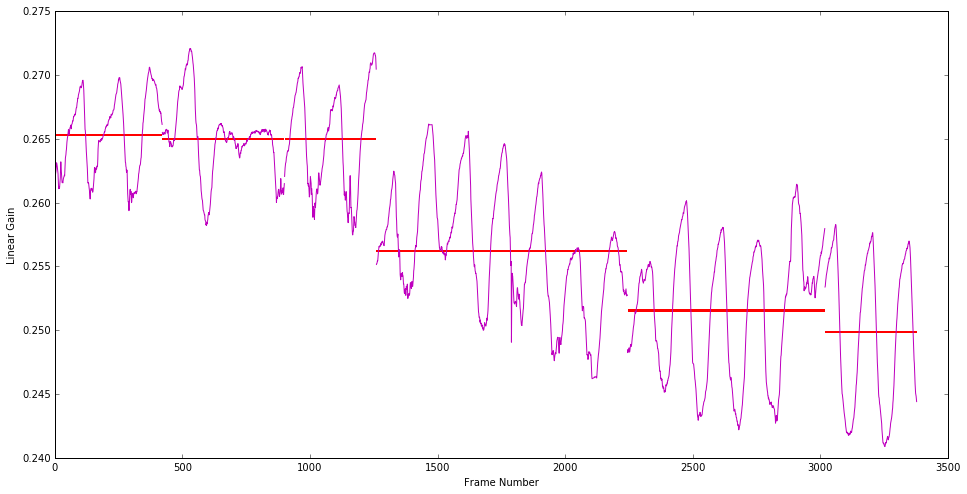

In [21]:
count_date=0
frame = np.linspace(0, len(gain_all[:,1,freq]), num=len(gain_all[:,1,freq]))
frame_per_dir = [421,479,360,984,774,360]
frame_seperate=[360,61,360,119,360,360,360,264,360,360,54,360]

for i in range(len(corr_list)):
    frame_count = 0
    for x in range(len(frame_per_dir)):
        time_stamp_sel= []
        time_stamp_temp = []
        m = ((gain_all[frame_count:frame_count+frame_per_dir[x],i,freq] < np.mean(gain_all[frame_count:frame_count+frame_per_dir[x],i,freq]) + 0.01) & (gain_all[frame_count:frame_count+frame_per_dir[x],i,freq] > np.mean(gain_all[frame_count:frame_count+frame_per_dir[x],i,freq]) - 0.01) & (gain_all[frame_count:frame_count+frame_per_dir[x],i,freq] < np.mean(gain_all[:,i,freq])+0.05))
        plt.figure(i+1)
        #plt.plot(frame[m],gain_all[m,i,freq] ,'.' ,color = colors[k], label = str(legend_crosscorr[k]), markersize = 3)
        
        frame_sec = frame[frame_count:frame_count+frame_per_dir[x]]
        gain_sec = gain_all[frame_count:frame_count+frame_per_dir[x],i,freq]
        time_stamp_temp = time_stamp[frame_count:frame_count+frame_per_dir[x]]
        time_stamp_sel = time_stamp_temp[m]
        date_time = [datetime.datetime.fromtimestamp(time) for time in time_stamp_sel]

        #print (date_time)
        plt.plot(frame_sec[m],gain_sec[m],color = colors[i], markersize = 3)
        #plt.plot( gain_sec[m],color = colors[i], markersize = 3)
        plt.ylabel('Linear Gain')
        plt.xlabel('Frame Number')
        
        
        plt.hlines(y=np.mean(gain_all[frame_count:frame_count+frame_per_dir[x],i,freq]), xmin=frame[frame_count], xmax=frame[frame_count+frame_per_dir[x]-1], color='red', zorder=1, linewidth=2)
        plt.hlines(y=np.mean(gain_sec[m]), xmin=frame[frame_count], xmax=frame[frame_count+frame_per_dir[x]-1], color='red', zorder=1, linewidth=2)
        
        frame_count = frame_count+frame_per_dir[x]

    k=0
    count=0
    '''
    for k in range(len(frame_seperate)):
        plt.axvline(x=count, linewidth=2, color='k')
        count = count+frame_seperate[k]
    plt.axhline(y=np.mean(gain_all[:,i,freq]),linewidth=3)
    '''


# Finding Reflection Component for each cable

0.0
0.00133624496988
0.00133624496988
0.0
0.00125097005648
0.00125097005648
0.0
0.00157037981685
0.00157037981685
0.0
0.00195343343303
0.00195343343303
0.0
0.00181852558651
0.00181852558651
0.0
0.00228270720701
0.00228270720701
0.0
0.00165889811097
0.00165889811097


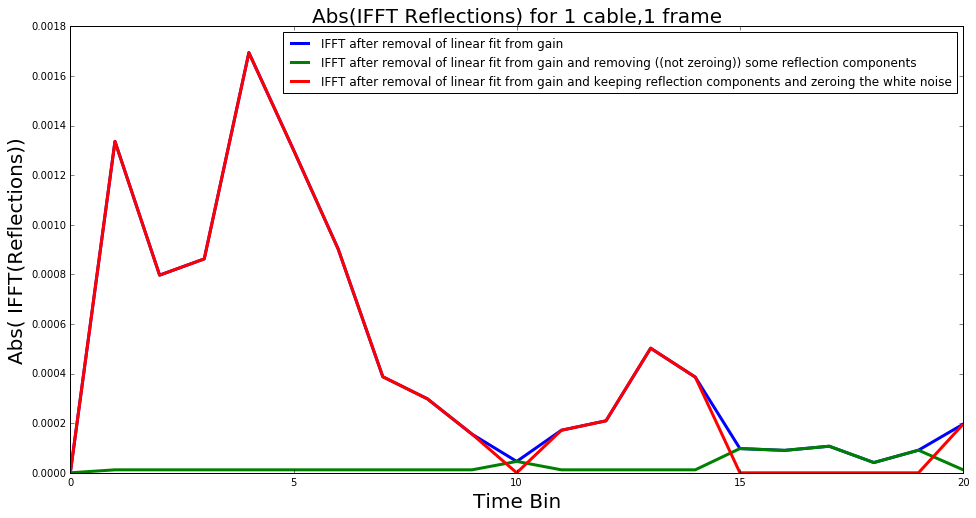

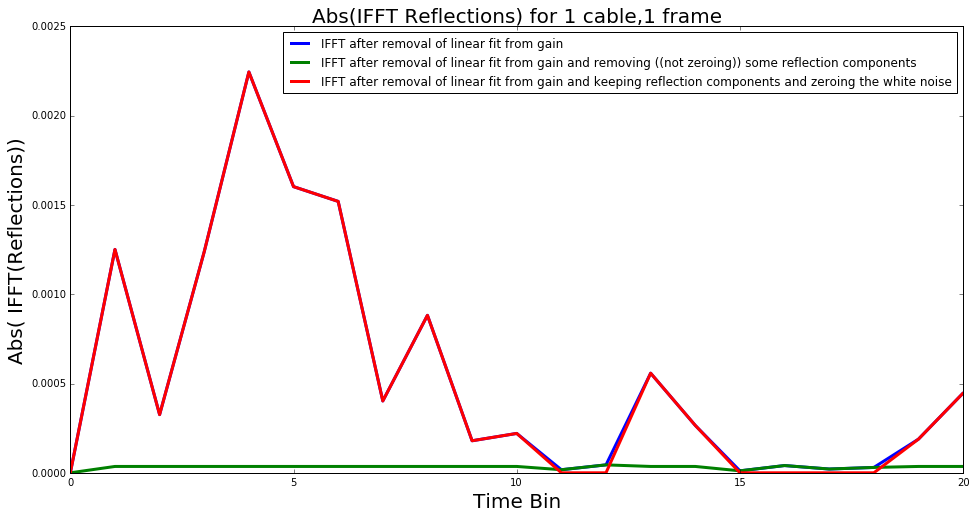

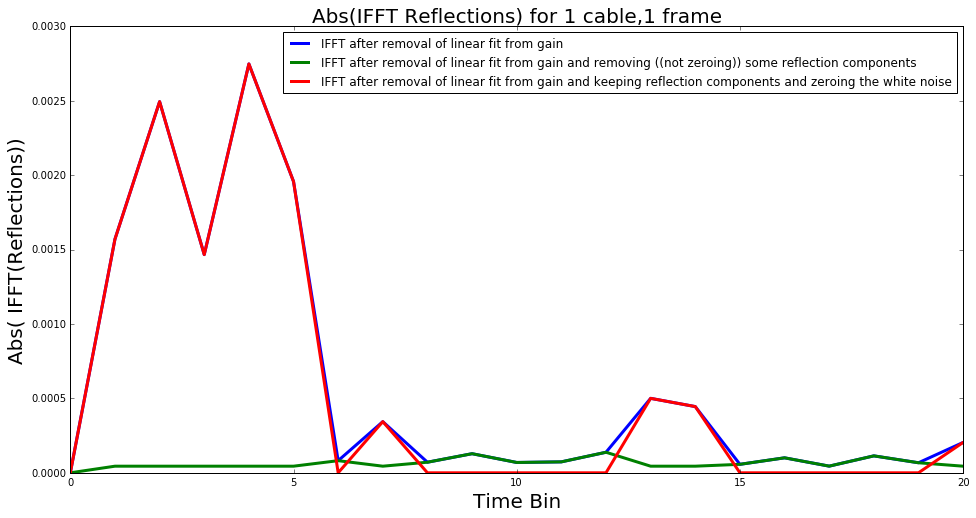

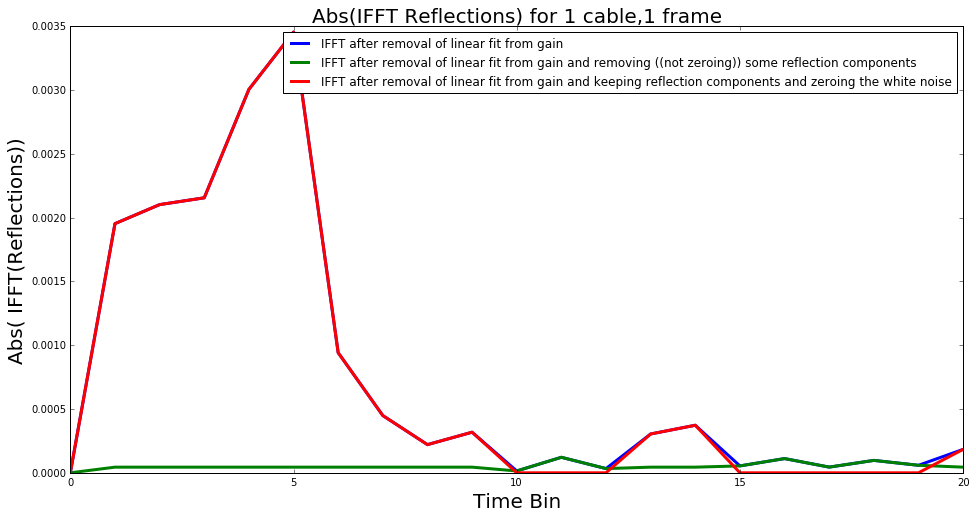

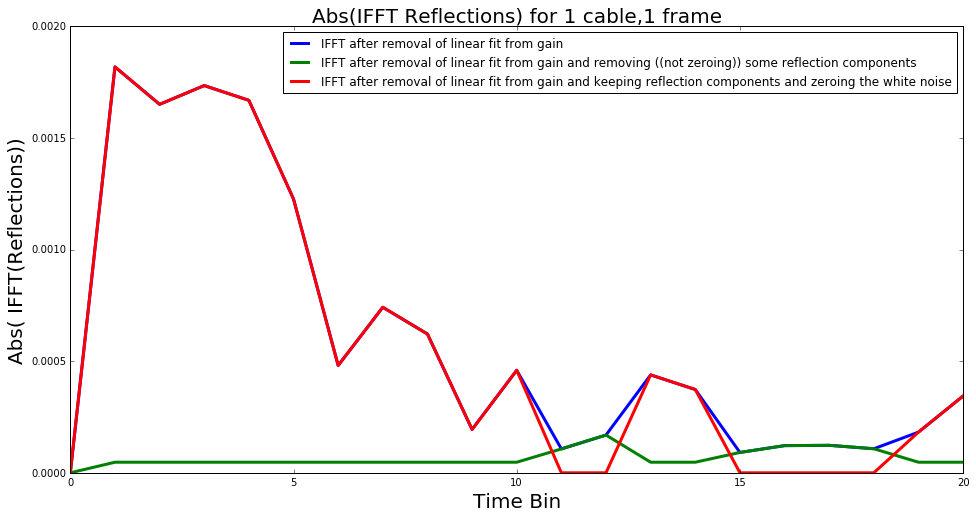

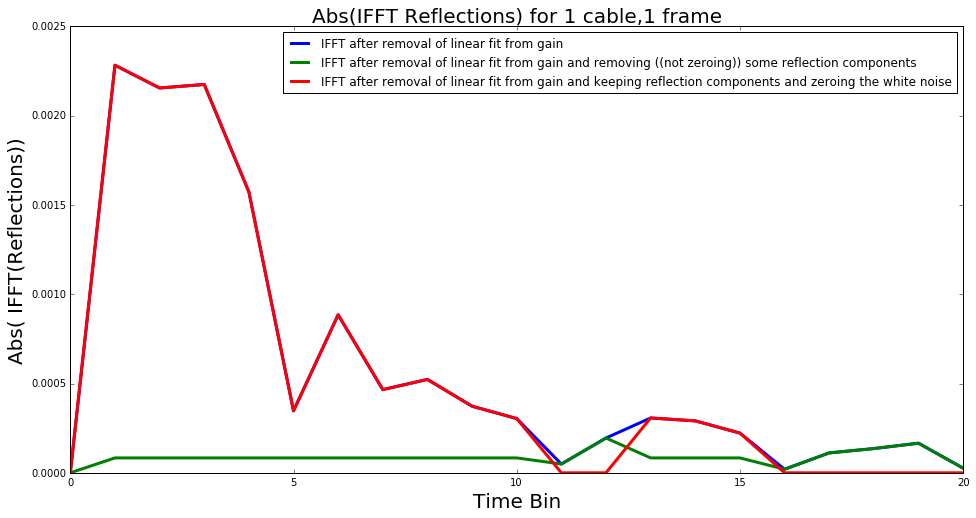

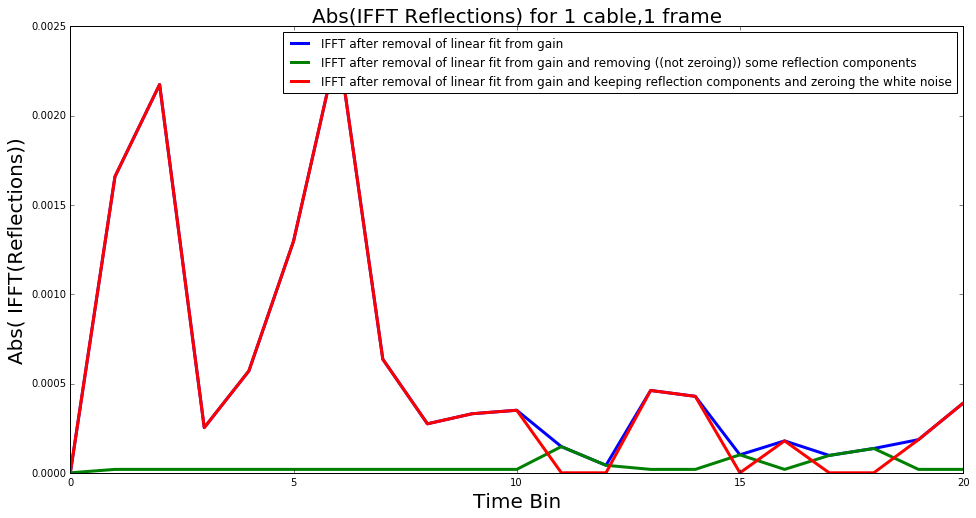

In [242]:
figure(figsize(16,8))

components_all_cables=[]
amplitude_all_cables=[]
gain_all_line_sub=[]

kk=1
for k in range(len(corr_list)):
    
    components=[]
    amplitude =[]
    # subtracting linear line from gain
    
    z=np.polyfit(freq_phase[50:990], gain_all[0,k,:],1)
    p=np.poly1d(z)
    gain_line_sub = gain_all[0,k,:] - p(freq_phase[50:990])
    
    
    gain_all_line_sub.append(gain_line_sub)
    
    ifft_component = np.fft.ifft(gain_line_sub) 
    ifft_component1 = np.fft.ifft(gain_line_sub) 
    ifft_component0 = np.fft.ifft(gain_line_sub) 
    end = len(ifft_component)

    #components=[3,4,5,6,7,8,13,14,20,99,138,139,140,146,147,148,149,150,151,152,154,789,790,791,792,793,794,800,801,802,841,919,920,921,926,927,932,933,934,935,936,937]
    for i in range(end):
        if np.abs(ifft_component[i]) > 2*np.mean(np.abs(ifft_component)):#-np.mean(np.abs(ifft_component))/2:
            components.append(i)
            amplitude.append(np.abs(ifft_component[i]))
    
    end_components = len(components)
    
    ifft_component1[components] = ifft_component1[33]
    #ifft_component1[components[0:6]] = ifft_component1[33]
    #ifft_component1[components[6:end_components-6]] = ifft_component1[33]
    #ifft_component1[components[end_components-6:end_components]] = ifft_component1[33]

    for i in range(len(ifft_component)):
        if i  not in components: 
            ifft_component0[i] = 0
    
    print(np.abs(ifft_component0[0]))
    print(np.abs(ifft_component0[0+1]))
    print(np.abs(ifft_component0[end-1]))
    
   
    
    plt.figure(k+kk)
    
    plt.plot(np.abs(ifft_component),'b',linewidth=3,label='IFFT after removal of linear fit from gain')
    plt.plot(np.abs(ifft_component1), 'g',linewidth=3, label='IFFT after removal of linear fit from gain and removing ((not zeroing)) some reflection components')
    plt.plot(np.abs(ifft_component0), 'r',linewidth=3, label='IFFT after removal of linear fit from gain and keeping reflection components and zeroing the white noise')
    plt.title('Abs(IFFT Reflections) for 1 cable,1 frame', size =20)
    plt.xlim(0,20)
    #plt.title('Getting the Reflection Components %i' %(np.int(len(components)/2)), size=20)
    #plt.axhline(y=4*np.mean(np.abs(ifft_component)),color = 'y', label='Threshold Value')
    plt.ylabel('Abs( IFFT(Reflections))', size=20)
    plt.xlabel('Time Bin',size=20)
    plt.legend()
    
    components_all_cables.append(components)
    amplitude_all_cables.append(amplitude)
    

In [255]:
time1 = np.linspace(1/800, 2048/800, num = 1024)
#time1 =  np.fft.fftfreq(1024, d=0.39)
#time1 = np.linspace(1/(1024*0.39), 1.25, num = 1024)
time = time1[50:990]
time_part = time[::2]
print(len(time_part))
print(time_part[0:10])

time1 = np.linspace(1/(1024*0.39), 1.25, num = 1024)
time = time1[50:990]
time_part = time[::2]
print(len(time_part))
print(time_part[0:10])

470
[ 0.12520032  0.13020833  0.13521635  0.14022436  0.14523237  0.15024038
  0.1552484   0.16025641  0.16526442  0.17027244]
470
[ 0.06347644  0.06591534  0.06835423  0.07079313  0.07323203  0.07567093
  0.07810982  0.08054872  0.08298762  0.08542652]


In [40]:
plt.figure()
#time_axis = np.linspace(1/freq_phase[990],1/freq_phase[50], num = len(freq_phase[50:990])) 
#time_axis = np.linspace(1/(len(freq_phase[50:990])*(freq_phase[11]-freq_phase[10])), 1/(freq_phase[11]-freq_phase[10]), num =len(freq_phase[50:990]))
freq = numpy.fft.fftfreq(len(data), 0.001*(data[1,2] - data[0,2]))
print(time_axis[4])
print(time_axis[149])
for k in range(len(corr_list)):
    if colors[k] != 'c':
        plt.plot(components_all_cables[k], amplitude_all_cables[k], '.' , color=colors[k], markersize = 15, label = legend_crosscorr[k])
        plt.legend()
        plt.xlim(0,470)
        plt.axvline(x = 149)
        plt.axvline(x = 4)
        #plt.axvline(x = 149/2)
plt.title('Amplitude of selected reflections', size=15)
plt.xlabel('Time Bin', size =15)
#plt.ylabel('Amp')


NameError: name 'time' is not defined

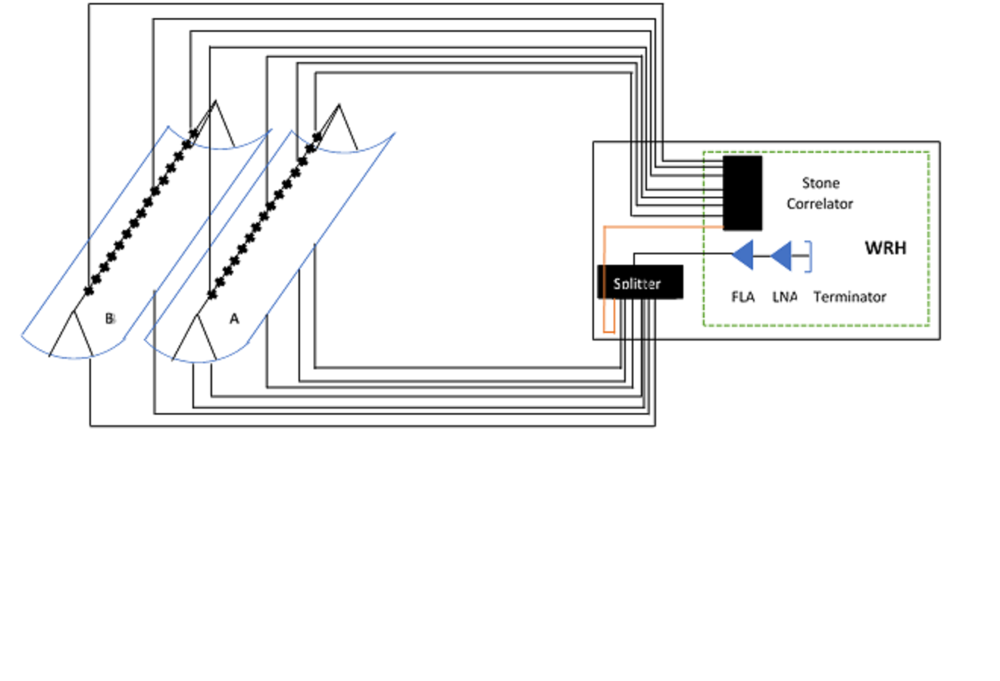

In [294]:
from IPython.display import Image
Image(filename='experimental_setup.png')

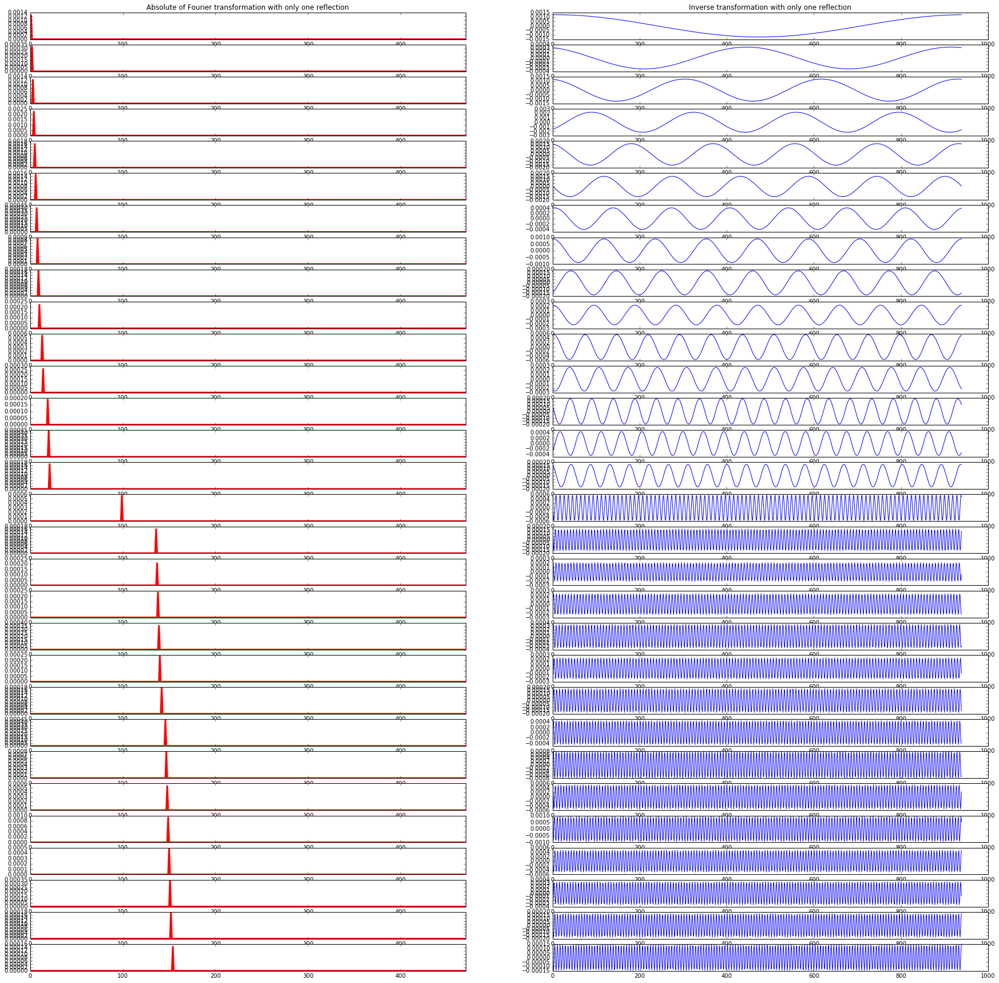

In [25]:
for k in range(len(corr_list)):
    #plt.figure(k+1)
    if k==1:
        plt.figure(1)
        fig,ax = plt.subplots(np.int(len(components_all_cables[k])/2),2,figsize=(30, 30), facecolor='w', edgecolor='k')
    all_comp_added = np.zeros(940)
    
    for i in range(np.int(len(components_all_cables[k])/2)):
        ifft_component = np.fft.ifft(gain_all_line_sub[k])
        #ifft_one_reflection = np.zeros(len(ifft_component))
        ifft_reflection = np.fft.ifft(gain_all_line_sub[k])
        
        for kk in range(len(ifft_component)):
            if kk != components_all_cables[k][i]:
                ifft_reflection[kk]=0
        
        ifft_reflections_half = np.real((np.fft.fft(ifft_reflection))) # never take absolute, look notebook 'understanding filtering'
        all_comp_added = all_comp_added + ifft_reflections_half
        if k==1:
            ax[i,0].plot(np.abs(ifft_reflection),'r', linewidth =3)
            ax[i,0].set_xlim([0,470])
            #ax[i,0].set_ylim([0,65])
            ax[0,0].set_title('Absolute of Fourier transformation with only one reflection')
            ax[0,1].set_title('Inverse transformation with only one reflection')
            ax[i,1].plot(ifft_reflections_half,'b')


In [26]:
def my_sin(term2,amp,phase,n):
    return amp*np.sin(n*term2 + phase)

parameters_all_cables=[]

for k in range(len(corr_list)):
    parameters = np.zeros(shape=(np.int(len(components_all_cables[k])),3))
    
    for i in range(np.int(len(components_all_cables[k]))):
        ifft_component = np.fft.ifft(gain_all_line_sub[k])
        ifft_reflection = np.fft.ifft(gain_all_line_sub[k])

        for kk in range(len(ifft_component)):
            if kk != components_all_cables[k][i]:
                ifft_reflection[kk]=0

        ifft_reflections_half = np.real(np.fft.fft(ifft_reflection))
        #ifft_reflections_half is the sinusoidal curve of each reflection
        
        N= len(freq_phase[50:990])
        term2 = np.arange(N) 

        guess_amplitude = np.max(ifft_reflections_half)
        guess_phase = 0.75 #1.5 
        n=2*np.pi*components_all_cables[k][i]/940
        
        if i==2:
            guess_phase = 1.5
        if i==9:
            guess_phase = np.pi

        guess_offset = np.mean(ifft_reflections_half) 
        p0=[ guess_amplitude, guess_phase, n]

        fit = curve_fit(my_sin, term2, ifft_reflections_half, p0=p0)
        data_fit = my_sin(term2, *fit[0])

        fit_leastsq = leastsq(lambda p: my_sin(term2, *p) - ifft_reflections_half, p0)
        parameters[i,:]= fit[0]
        '''
        # this is to check if fitting is working good or not? change the value of k to see if it is good or no
        if k ==1:
            if i in [0,1,2,3,4,5,6,7]:
                    plt.figure(i+1)
                    plt.plot(ifft_reflections_half, label='After fourier transformation (real part)')
                    plt.plot(data_fit ,'r' , label='After fitting')
                    plt.plot(my_sin(term2,*p0), label='initial guess')
                    #plt.plot(my_sin(term2, *fit_leastsq[0]),'.' , label='After fitting least square fitting')
                    plt.title(i)
                    plt.legend()
            else:    
                    plt.figure(i+1)
                    plt.plot(ifft_reflections_half, label='After fourier transformation (real part)')
                    plt.plot(data_fit ,'r' , label='After fitting')
                    plt.plot(my_sin(term2,*p0), label='initial guess')
                    #plt.plot(my_sin(term2, *fit_leastsq[0]),'.' , label='After fitting least square fitting')
                    plt.title(i)
                    plt.xlim(0,100)
                    plt.legend()
        '''
    parameters_all_cables.append(parameters)

In [27]:
print(parameters_all_cables[1][3])
print(parameters_all_cables[1][3][:])
print (len(parameters_all_cables[4][:]))

[ 0.00224484 -0.82113721  0.02673696]
[ 0.00224484 -0.82113721  0.02673696]
52


# NOTE2: MAKE SURE FIRST REFLECTION IS ONLY COUNTED ONCE, NOT TWICE, EITHER YOU MODIFY YOUR MODEL AND NEVER MULTIPLY BY 2, ITS BLUNDER 

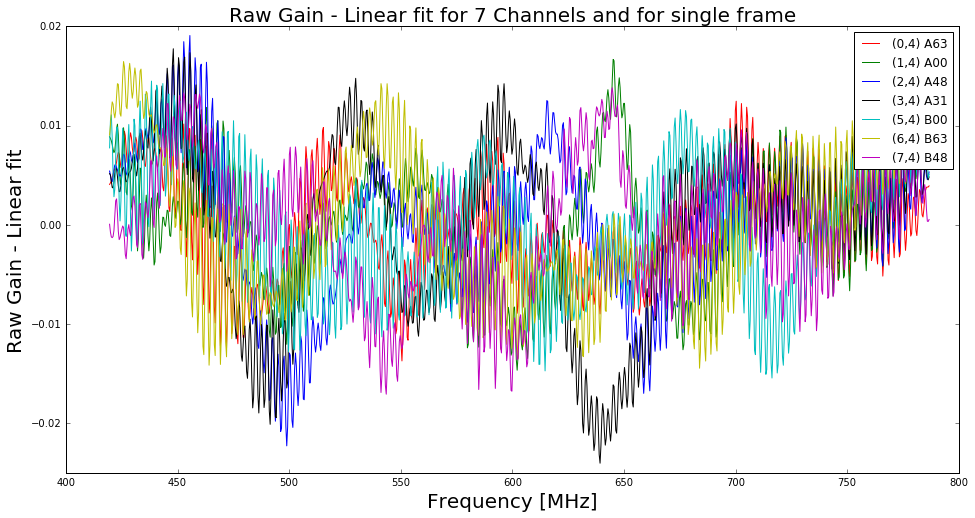

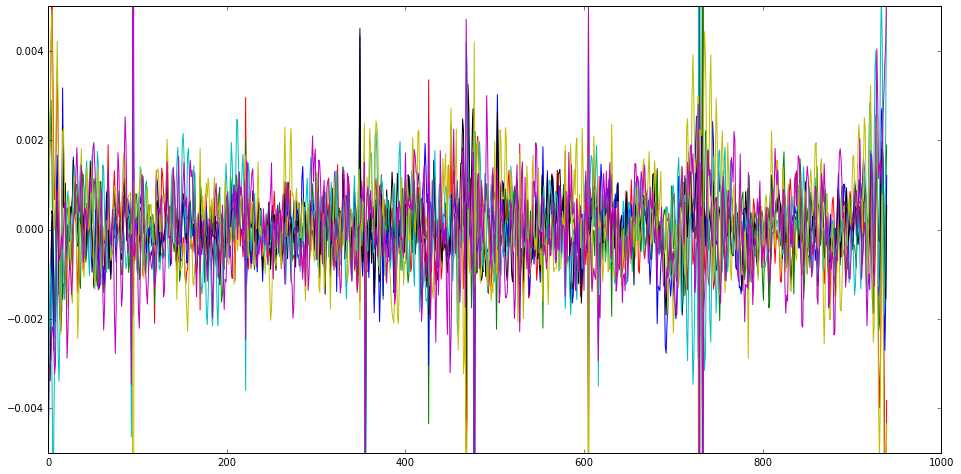

In [28]:
figure(figsize(16,8))

reflections_generate_all_cable=[]
reflections_generate_one_cable = np.zeros(len(gain_all[0,1,:]))


for k in range(len(corr_list)):
    
    z=np.polyfit(freq_phase[50:990], gain_all[0,k,:],1)
    p=np.poly1d(z)
    gain_line_sub = gain_all[0,k,:] - p(freq_phase[50:990])
    
    
    reflections_generate_one_cable = np.zeros(len(gain_all[0,1,:]))
    #print(np.int(len(parameters_all_cables[k][i])))
    for i in range(np.int(len(parameters_all_cables[k]))):
        reflections_generate_one_cable = reflections_generate_one_cable + my_sin(term2, *parameters_all_cables[k][i][:])
    
    reflections_generate_all_cable.append(reflections_generate_one_cable)
    plt.figure(1)
    plt.plot(freq_phase[50:990],reflections_generate_one_cable, color=colors[k], label = legend_crosscorr[k])
    plt.title('Raw Gain - Linear fit for 7 Channels and for single frame', size=20)
    plt.ylabel('Raw Gain - Linear fit', size=20)
    plt.xlabel('Frequency [MHz]', size=20)
    plt.legend()
    
    plt.figure(2)
    plt.plot(gain_line_sub-reflections_generate_one_cable, color=colors[k])
    plt.ylim(-0.005,0.005)
#plt.xlabel('Frequency [MHz]')

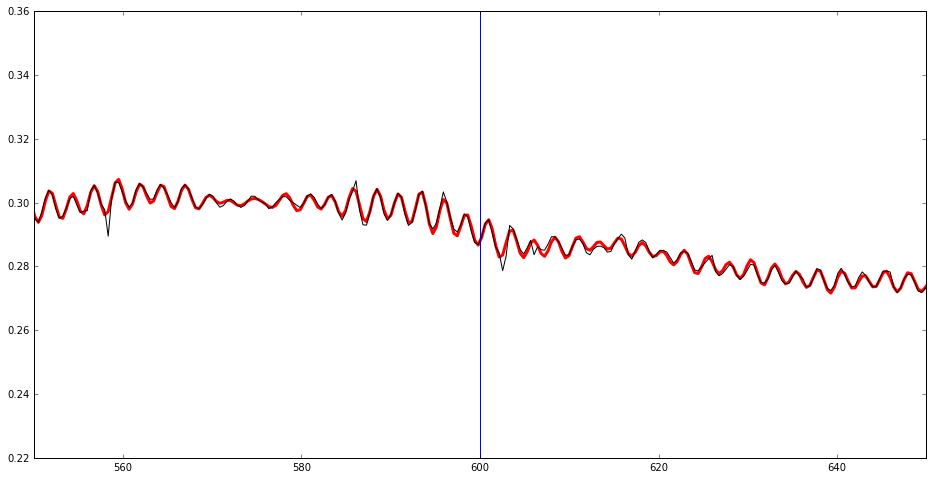

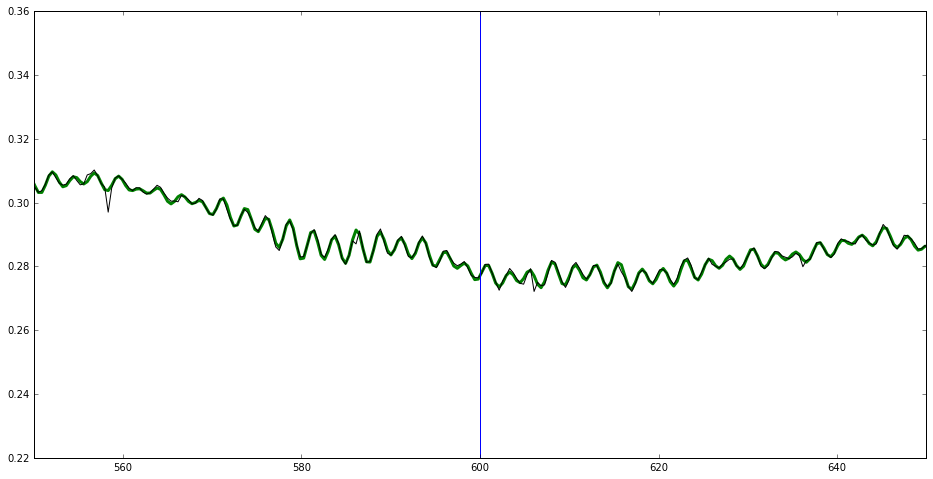

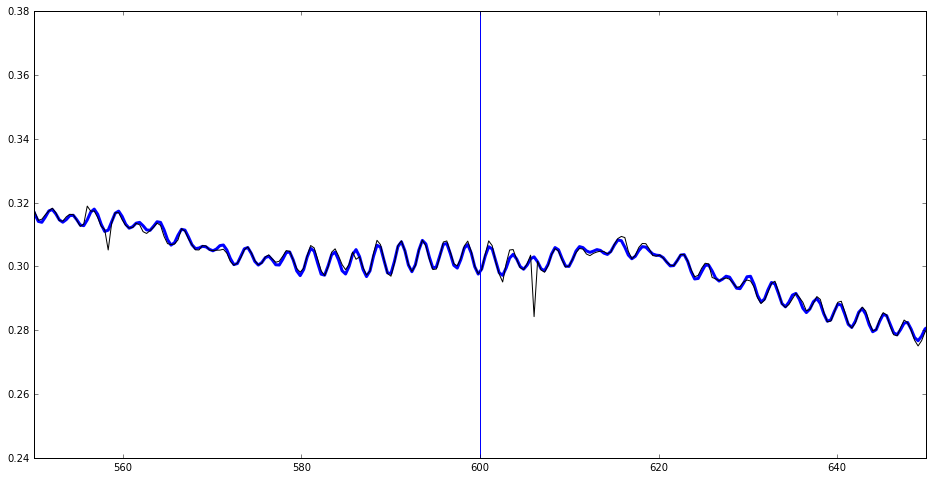

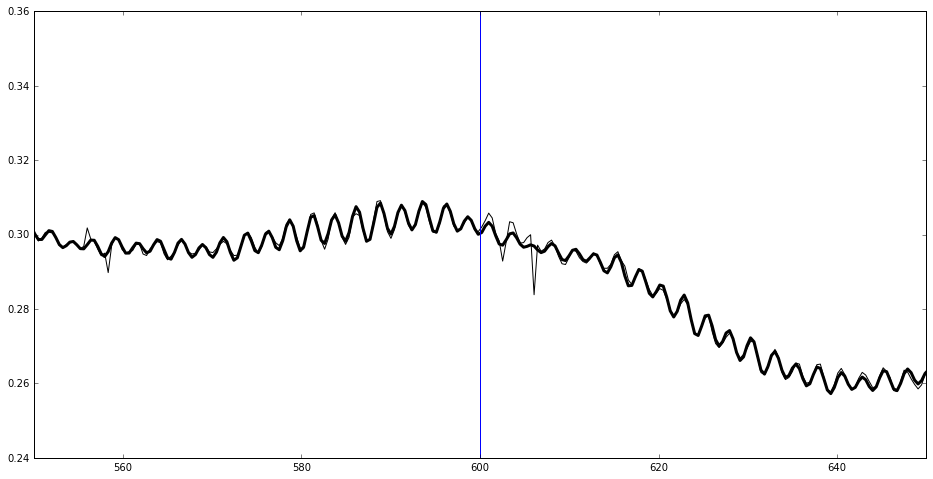

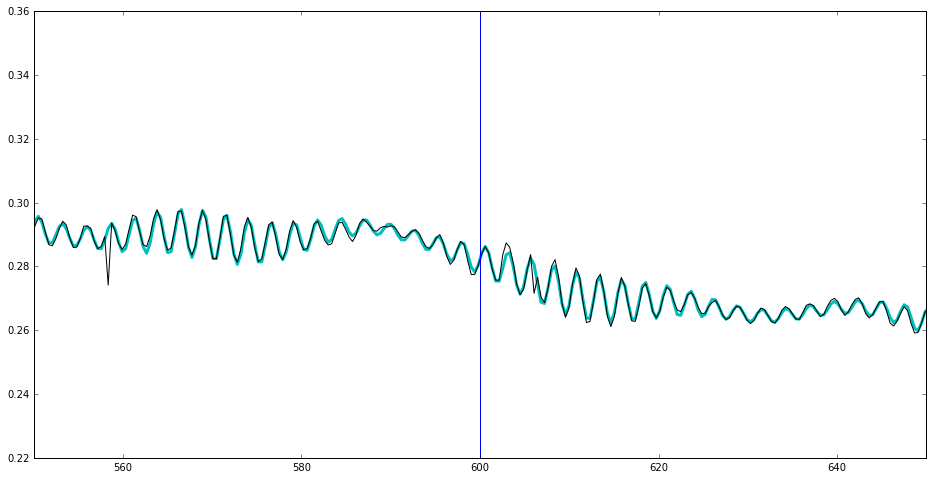

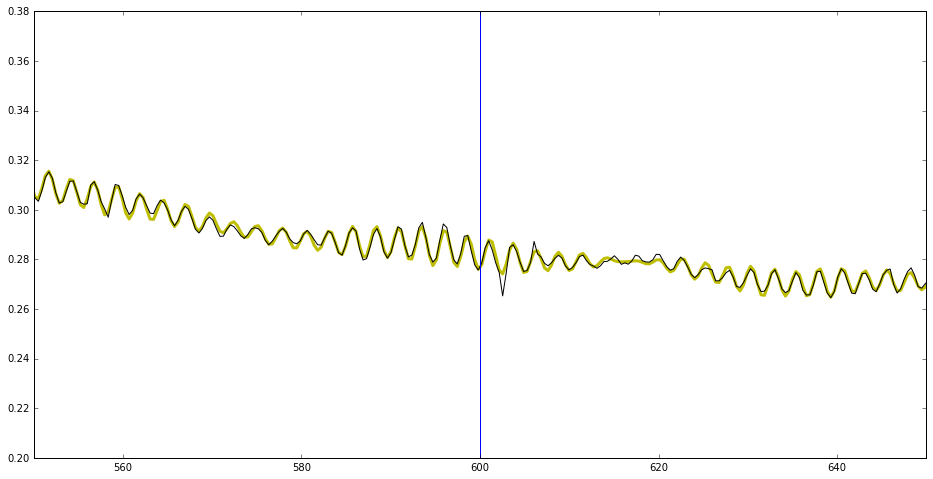

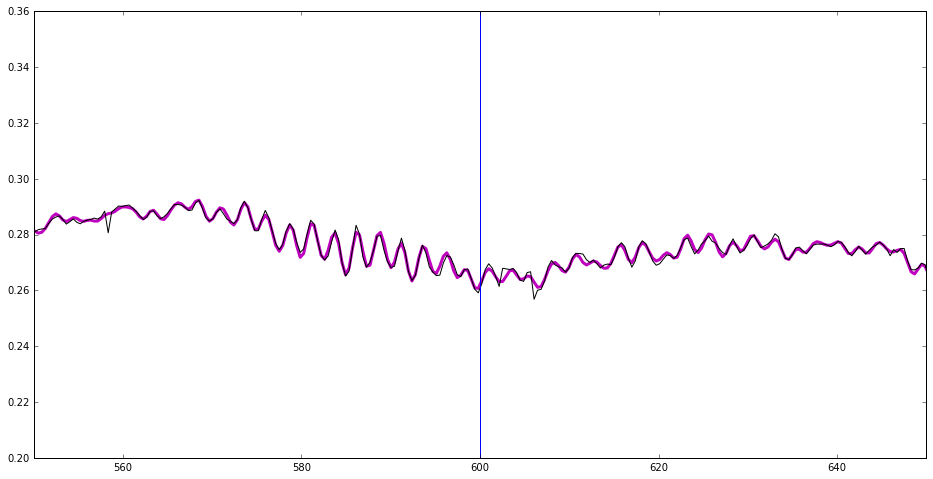

In [29]:
for k in range(len(corr_list)):
    reflections_generate_one_cable = np.zeros(len(gain_all[0,1,:]))
    for i in range(np.int(len(parameters_all_cables[k]))):
        reflections_generate_one_cable = reflections_generate_one_cable + my_sin(term2, *parameters_all_cables[k][i][:])
    
    reflections_generate_all_cable.append(reflections_generate_one_cable)
    
    z=np.polyfit(freq_phase[50:990], gain_all[0,k,:],1)
    p=np.poly1d(z)
    gain_lin = p(freq_phase[50:990])
    
    plt.figure(k+1)
    plt.plot(freq_phase[50:990],gain_lin+reflections_generate_one_cable, color=colors[k], linewidth = 3)
    plt.plot(freq_phase[50:990],gain_all[0,k,:],'k')
    plt.axvline(x=600)
    plt.xlim(550,650)


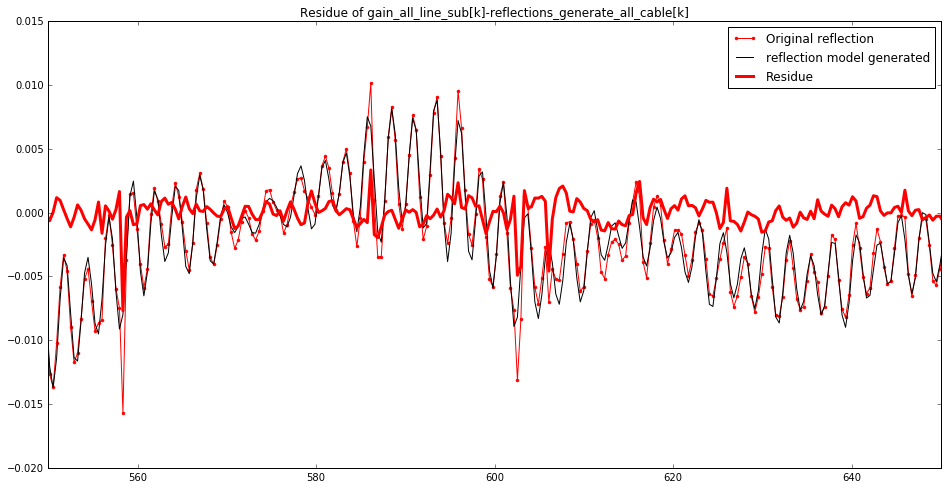

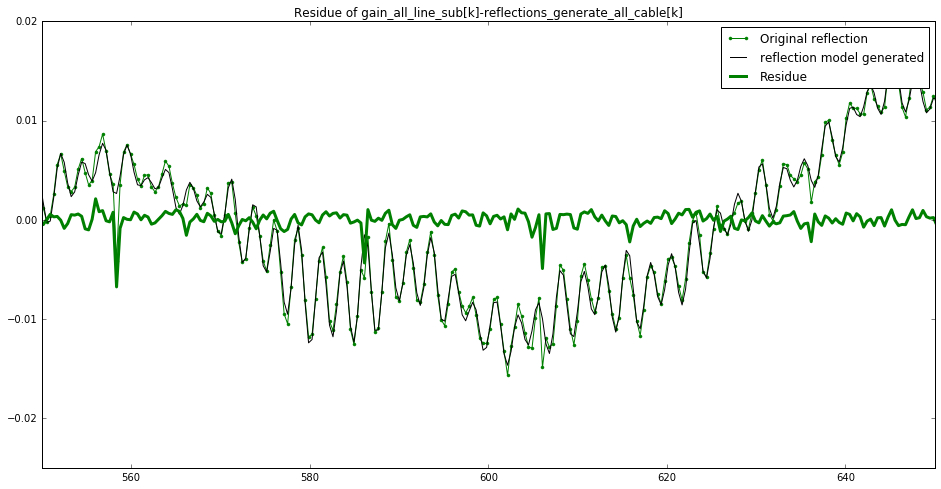

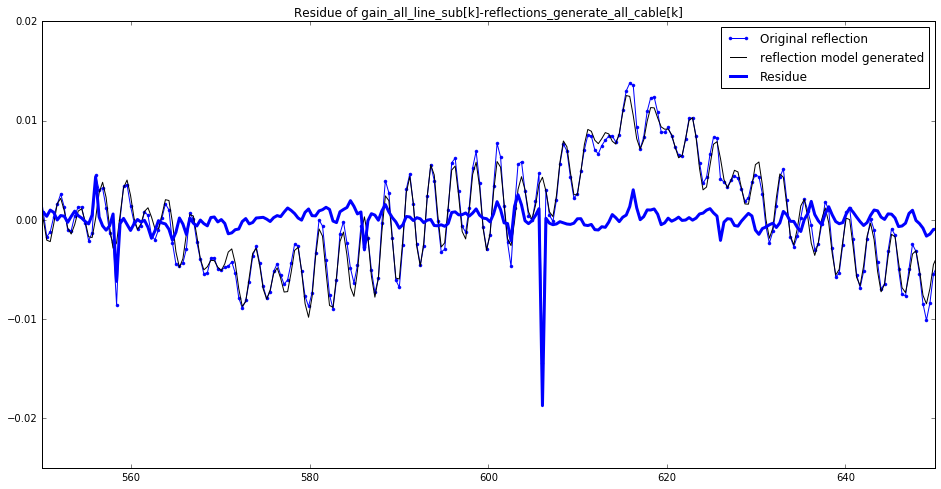

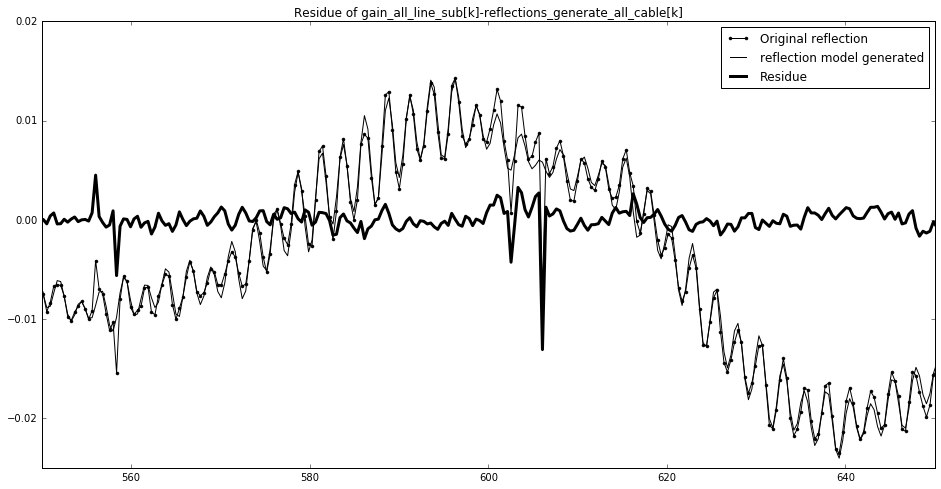

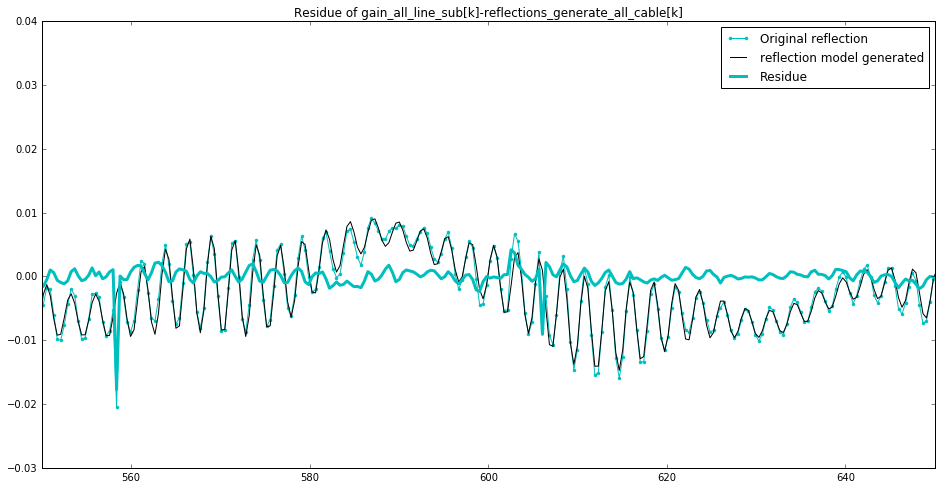

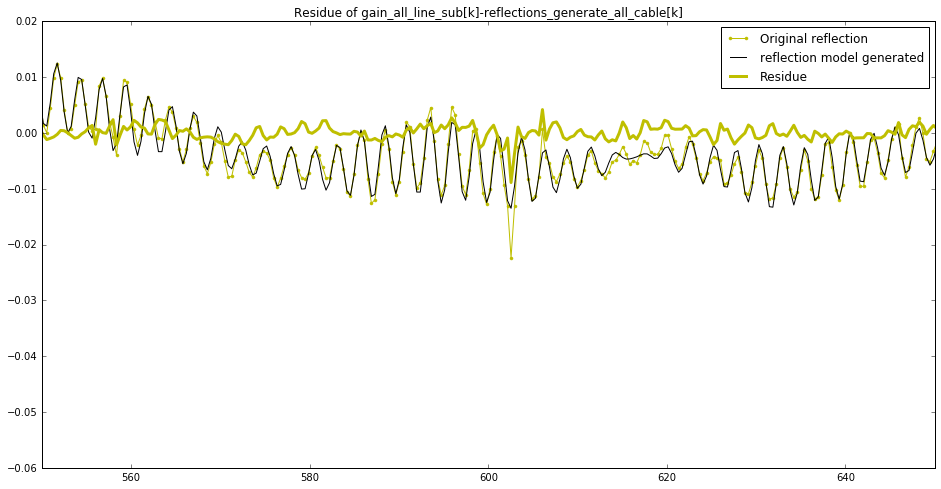

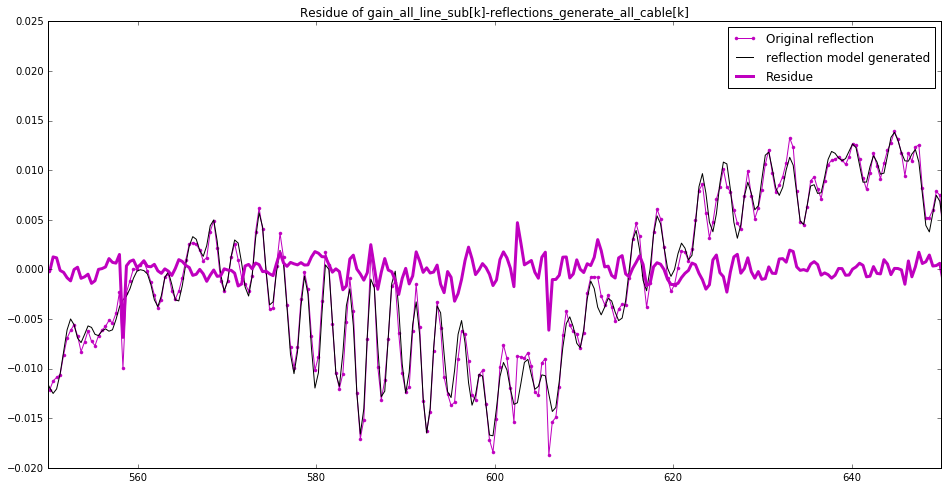

In [30]:
for k in range(len(corr_list)):
    plt.figure(k+1)
    #plt.subplot(2,1,1)
    plt.plot(freq_phase[50:990],gain_all_line_sub[k],'.-',color = colors[k], label = 'Original reflection')
    plt.plot(freq_phase[50:990],reflections_generate_all_cable[k], 'k', label = 'reflection model generated')
    
    #plt.figure(7+1)
    #plt.subplot(2,1,1)
    plt.plot(freq_phase[50:990],gain_all_line_sub[k]-reflections_generate_all_cable[k], color=colors[k], linewidth =3, label = 'Residue')
    plt.title('Residue of gain_all_line_sub[k]-reflections_generate_all_cable[k]')
    #plt.ylim(-0.004,0.004)
    #plt.axvline(x=600, color = 'k', linewidth = 3)
    plt.xlim(550,650)
    plt.legend()

In [31]:
print (len(reflections_generate_all_cable))

14


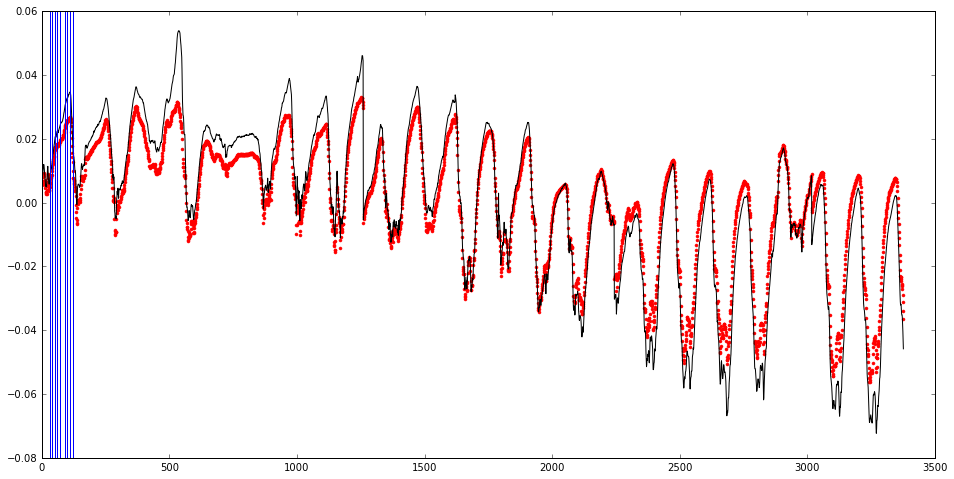

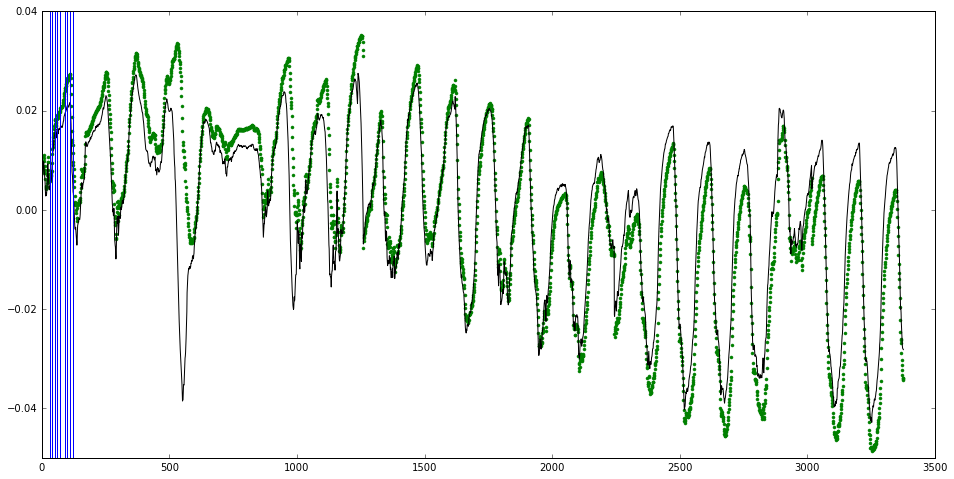

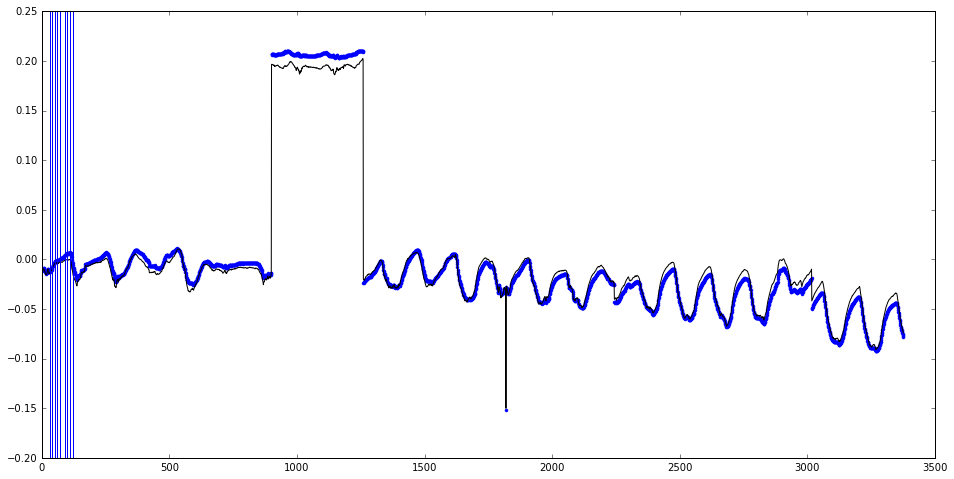

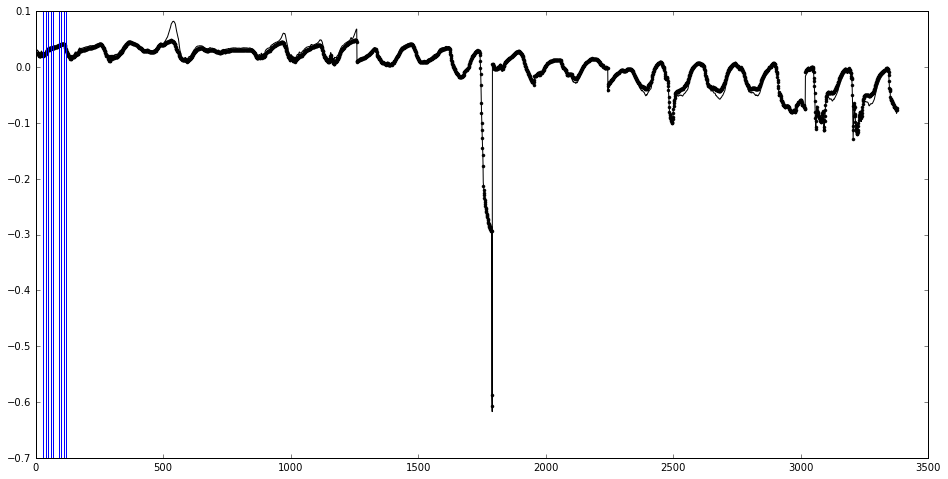

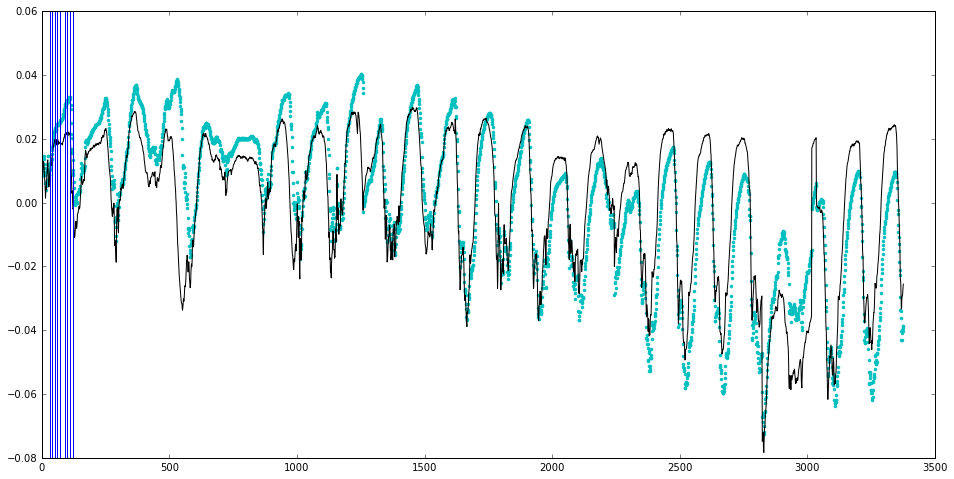

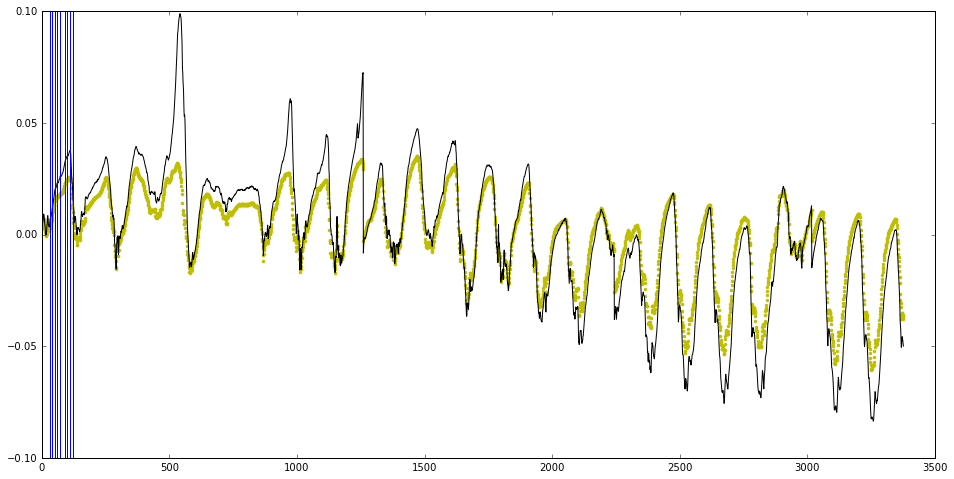

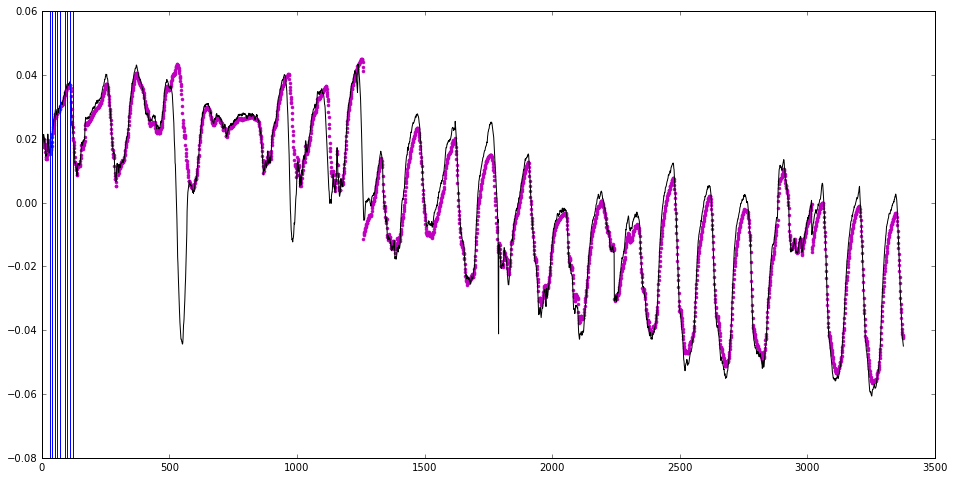

In [32]:
freq=470
residual_new_model_all_cables=[]
for k in range(len(corr_list)):
    
    gain_per_frame = np.zeros(len(gain_all[:,k,freq]))
    residual_new_model=[]
    
    gain_per_frame_600 = np.zeros(len(gain_all[:,k,freq]))

    for i in range(len(gain_all[:,k,freq])):
        z=np.polyfit(freq_phase[50:990], gain_all[i,k,:],1)
        p=np.poly1d(z)
        gain_per_frame = p(freq_phase[50:990]) + reflections_generate_all_cable[k] 
        gain_per_frame_600[i] = gain_per_frame[freq]# value of fit at each frame only one frequency
    
    frac_change_gain_new_model = (gain_per_frame_600 - np.mean(gain_per_frame_600))/np.mean(gain_per_frame_600)
    frac_change_gain_raw = (gain_all[:,k,freq] - np.mean(gain_all[:,k,freq]))/np.mean(gain_all[:,k,freq])
    residual_new_model = frac_change_gain_raw - frac_change_gain_new_model
    residual_new_model_all_cables.append(residual_new_model)
    
    plt.figure(k+1)
    #plt.subplot(4,2,k+1)
    plt.plot(frac_change_gain_new_model,'.', color=colors[k])
    plt.plot(frac_change_gain_raw, 'k')
    ddd=[30,40,50,60,70,90,100,110,120]
    for kkk in range(len(ddd)):
        plt.axvline(x=ddd[kkk], linewidth=1)
    #if k==0:
    #plt.xlim(0,200)
    

[ -4.63375016e-03  -4.43426349e-03  -4.27716425e-03  -4.47127995e-03
  -4.78286735e-03  -4.86423098e-03  -4.84947390e-03  -4.97154247e-03
  -4.87840632e-03  -5.33830883e-03  -5.43598761e-03  -6.04531201e-03
  -6.69910896e-03  -7.06852849e-03  -7.54742768e-03  -7.77030298e-03
  -7.90482882e-03  -8.28497244e-03  -8.40179892e-03  -8.36024951e-03
  -9.08586527e-03  -9.28332519e-03  -9.44580954e-03  -9.57841414e-03
  -1.01769919e-02  -1.05386972e-02  -1.05971378e-02  -1.04230112e-02
  -1.06389590e-02  -1.07884879e-02  -1.08615485e-02  -1.07043351e-02
  -1.11166198e-02  -1.12637193e-02  -1.15531805e-02  -1.11577593e-02
  -1.11207276e-02  -1.15797049e-02  -1.19023195e-02  -1.23542578e-02
  -1.30147887e-02  -1.32612452e-02  -1.31453416e-02  -1.33622325e-02
  -1.35604451e-02  -1.37525256e-02  -1.38658339e-02  -1.41201502e-02
  -1.42773349e-02  -1.43440856e-02  -1.41119804e-02  -1.42859461e-02
  -1.43392404e-02  -1.42963290e-02  -1.44970693e-02  -1.42819174e-02
  -1.43189310e-02  -1.41299410e-02

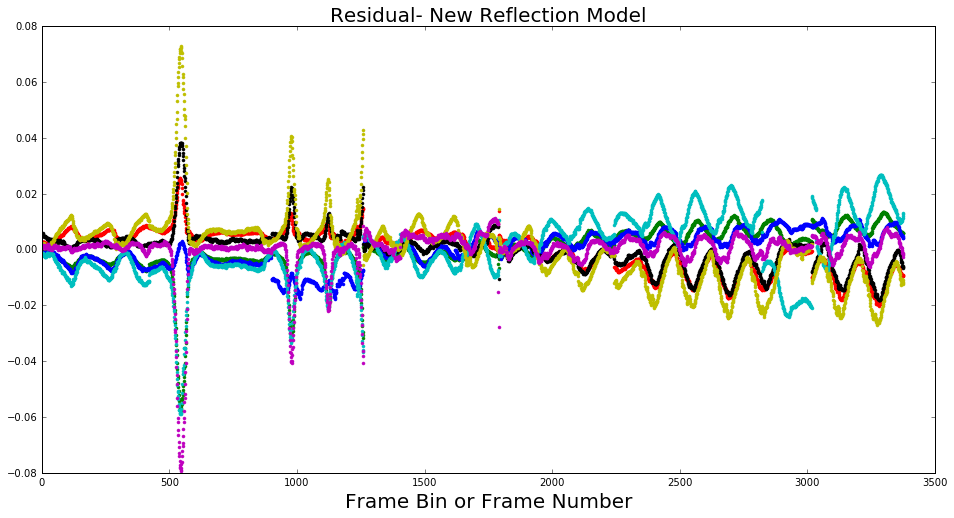

In [33]:
for k in range(len(corr_list)):
    plt.figure(1)
    plt.plot(residual_new_model_all_cables[k], '.' , color = colors[k])
    plt.title('Residual- New Reflection Model', size =20)
    plt.xlabel('Frame Bin or Frame Number', size =20)
    print (residual_new_model_all_cables[k][2500:3000])

In [34]:
print (len(gain_all[:,1,freq]))

3378


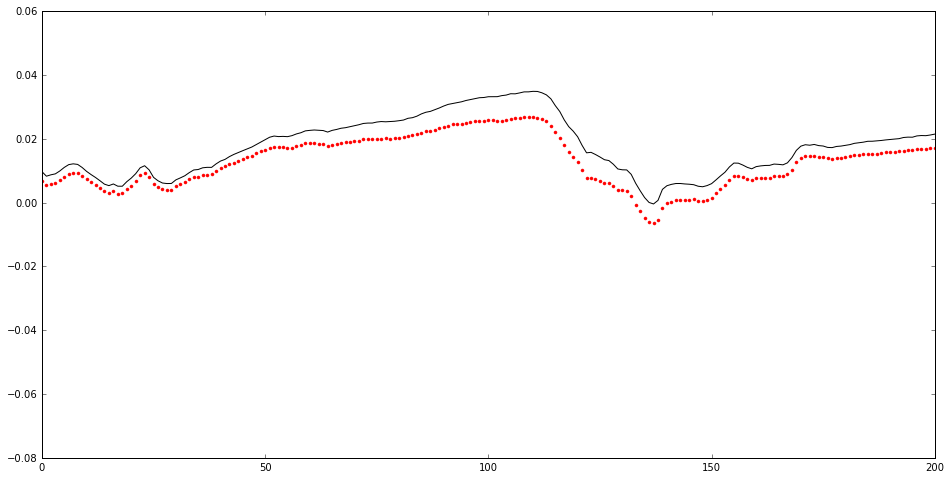

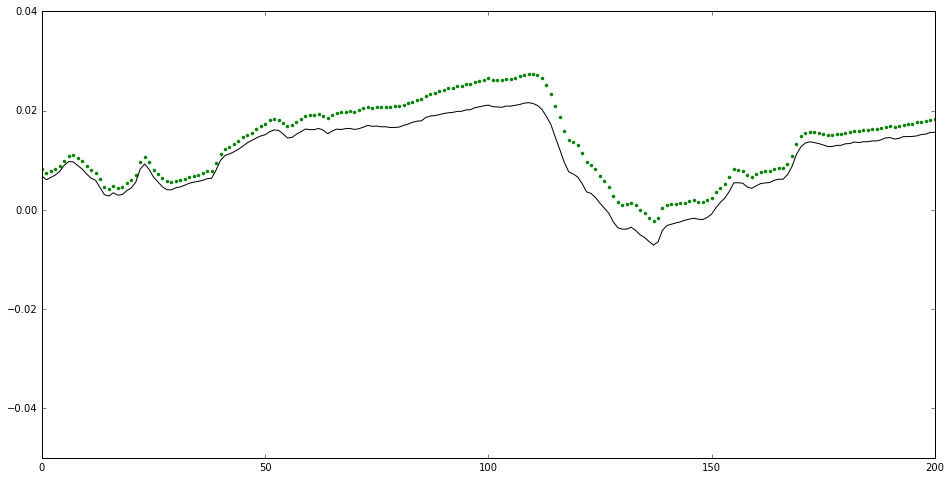

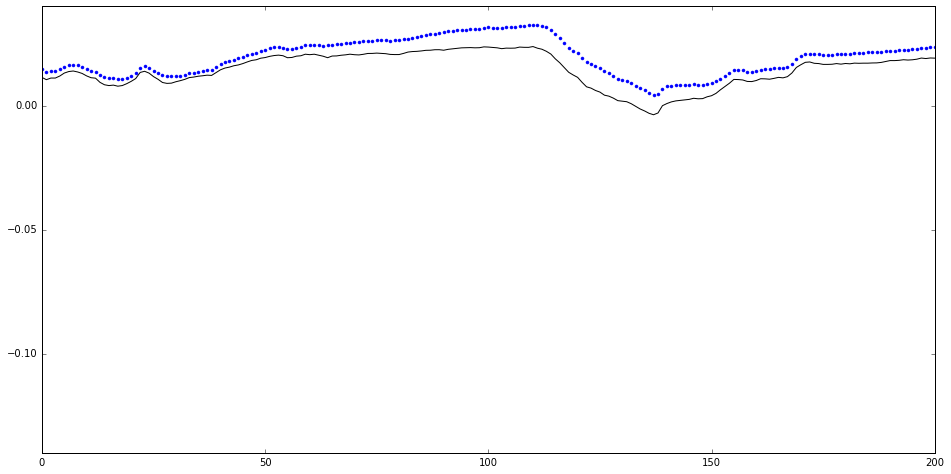

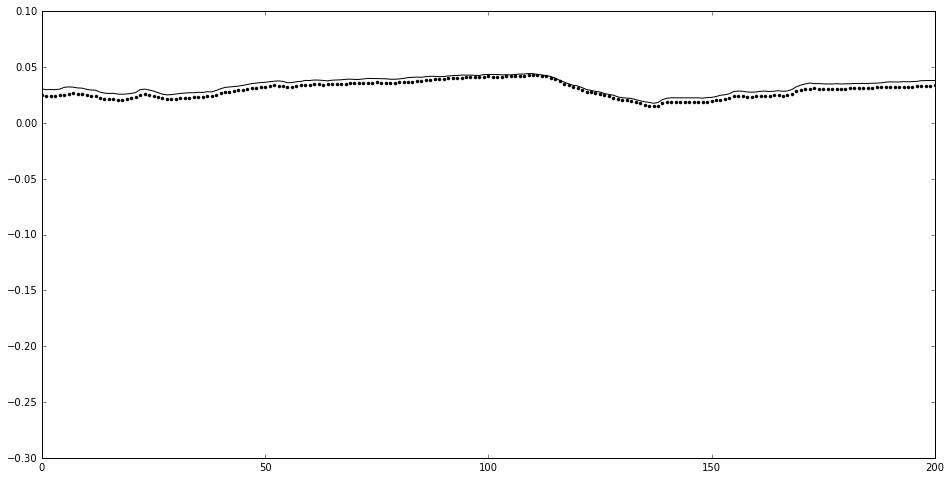

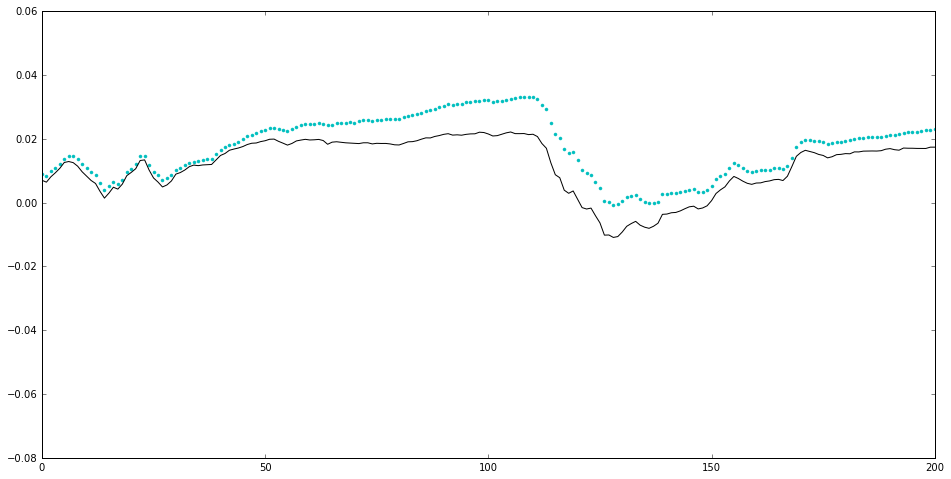

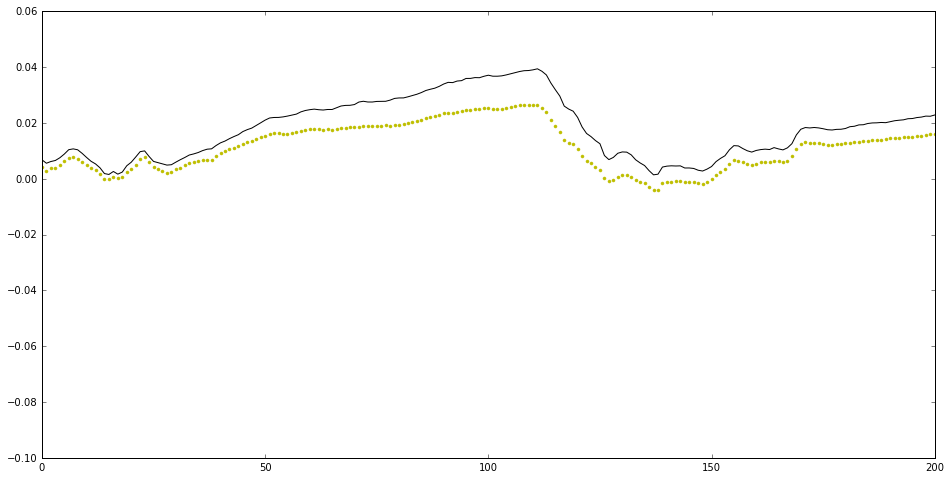

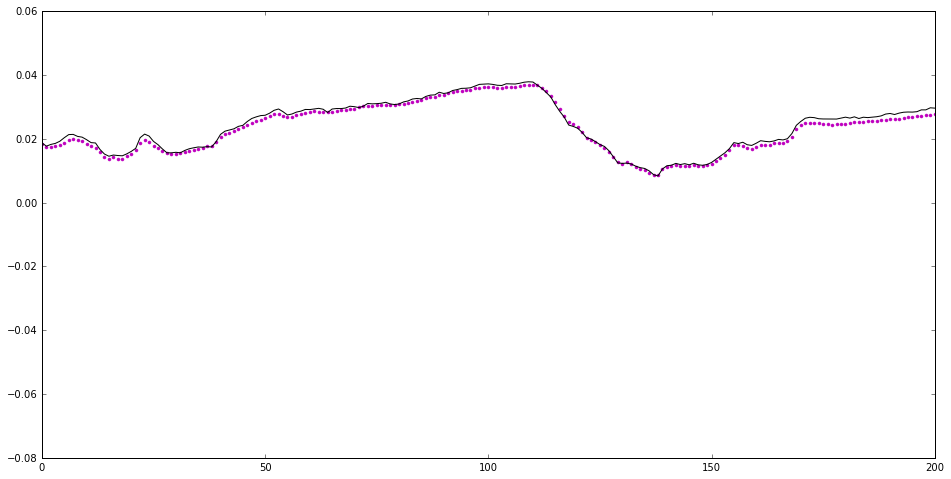

In [36]:
residual_new_model_all_cables=[]
count_mask = []
kk=0

for k in range(len(corr_list)):

    count1=[]
    m = ((gain_all[:,k,freq] < np.mean(gain_all[:,k,freq]) + 0.015) & ( gain_all[:,k,freq] > np.mean(gain_all[:,k,freq]) - 0.15))
    
    gain_per_frame = np.zeros(len(gain_all[0,k,:]))
    residual_new_model=[]
    
    #gain_per_frame_600 = np.zeros(len(gain_all[m,k,freq]))
    gain_per_frame_600 = []
    
    for i in range(len(gain_all[:,k,freq])):
        if m[i] == True:
            z=np.polyfit(freq_phase[50:990], gain_all[i,k,:],1)
            p=np.poly1d(z)
            gain_per_frame = p(freq_phase[50:990]) + reflections_generate_all_cable[k] 
            #gain_per_frame_600[i] = gain_per_frame[freq]# value of fit at each frame only one frequency
            gain_per_frame_600.append(gain_per_frame[freq])
            count1.append(i)
  
    frac_change_gain_new_model = (gain_per_frame_600 - np.mean(gain_per_frame_600))/np.mean(gain_per_frame_600)
    frac_change_gain_raw = (gain_all[m,k,freq] - np.mean(gain_all[m,k,freq]))/np.mean(gain_all[m,k,freq])
    residual_new_model = frac_change_gain_raw - frac_change_gain_new_model
    residual_new_model_all_cables.append(residual_new_model)
    
    plt.figure(k+2)
    #plt.subplot(4,2,k+1)
    plt.plot(frac_change_gain_new_model,'.', color=colors[k])
    plt.plot(frac_change_gain_raw, 'k')
    #if k==0:
    plt.xlim(0,200)


In [ ]:
print (len(frac_change_gain_new_model))

# Analyzing one cable and multiple time frames 

C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\ipykernel\__main__.py:26: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


only one
only one
only one
only one
only one
only one
only one
579.472140762
478.201368524


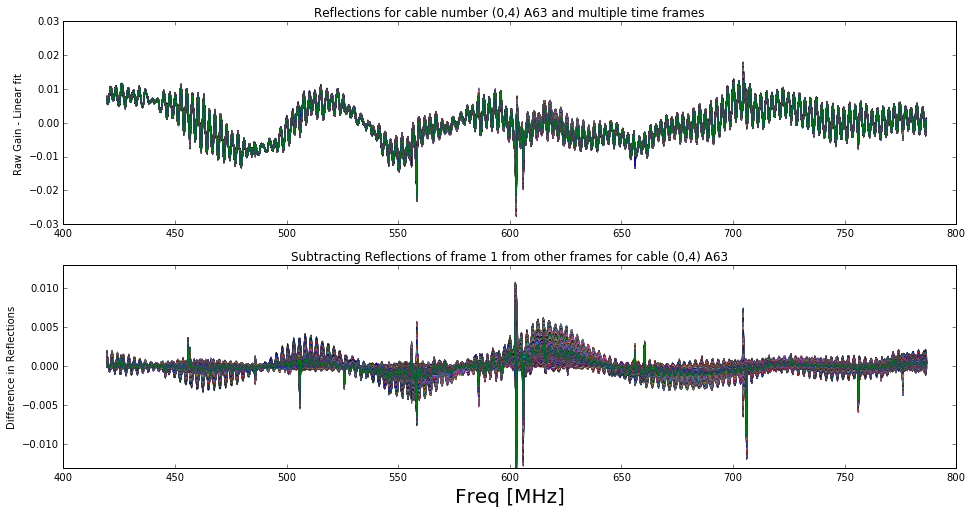

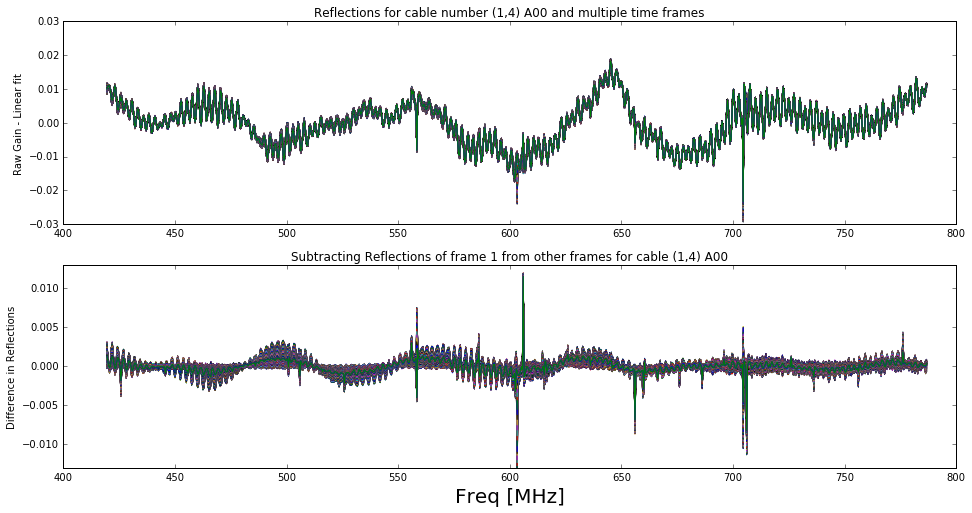

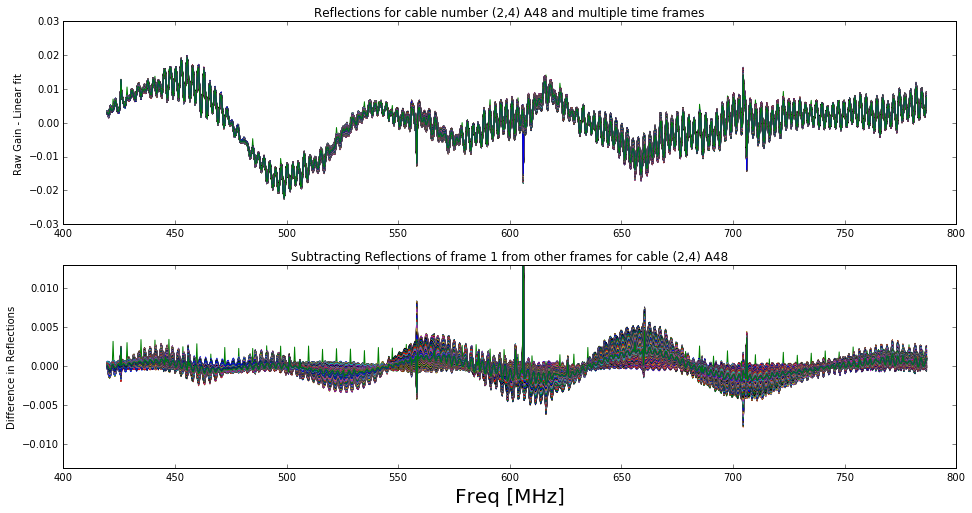

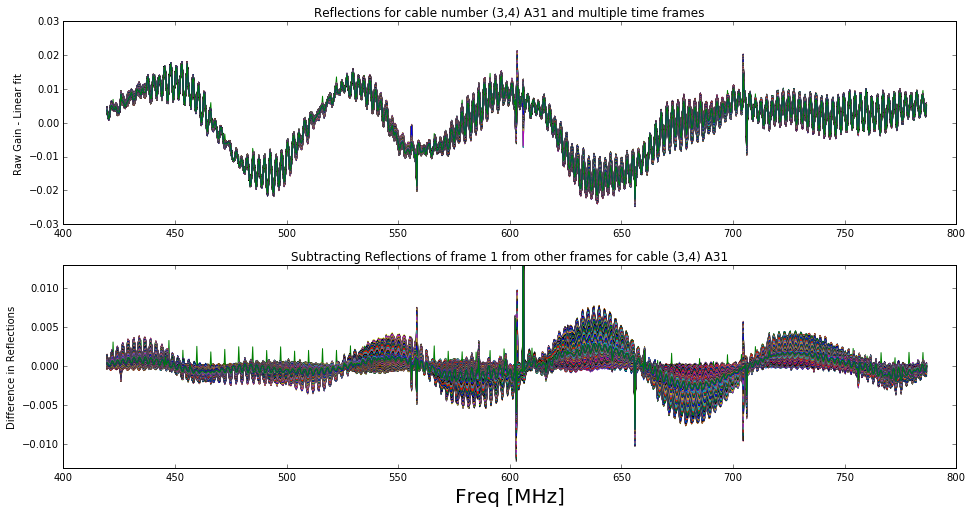

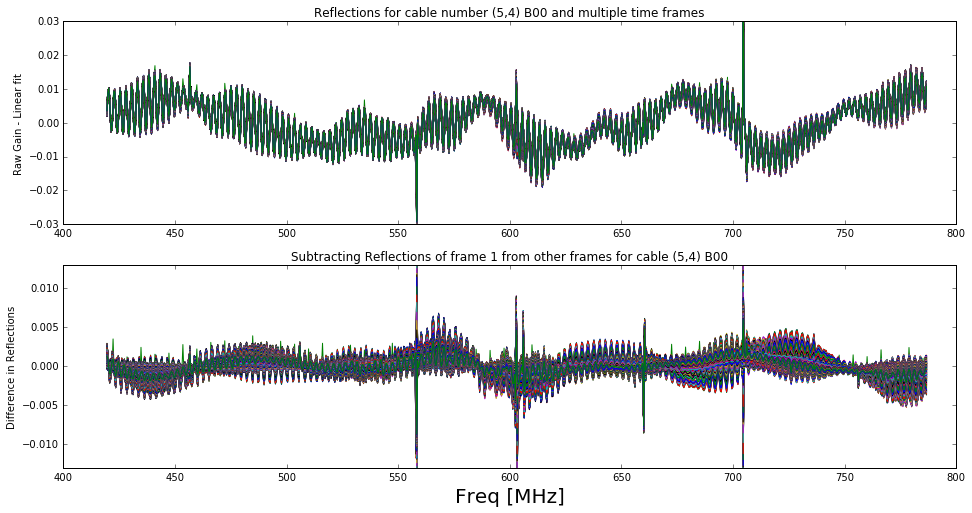

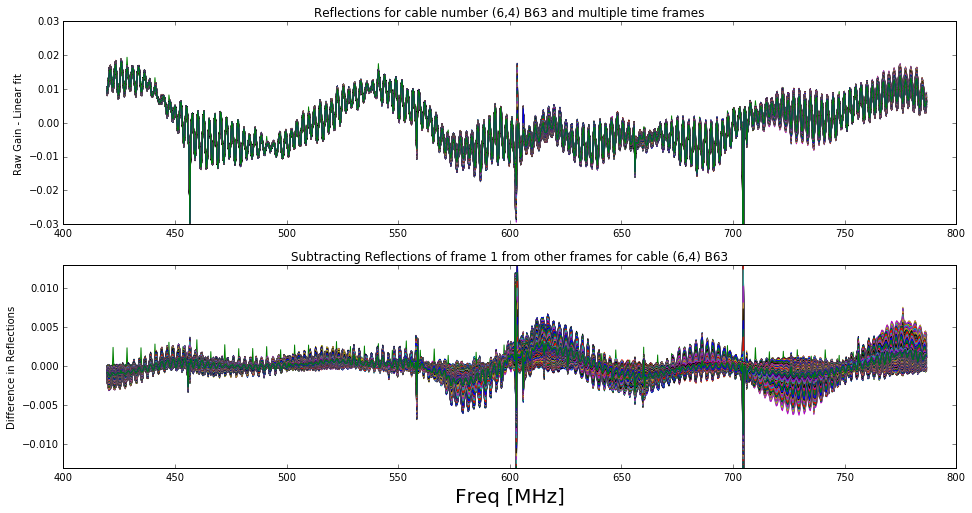

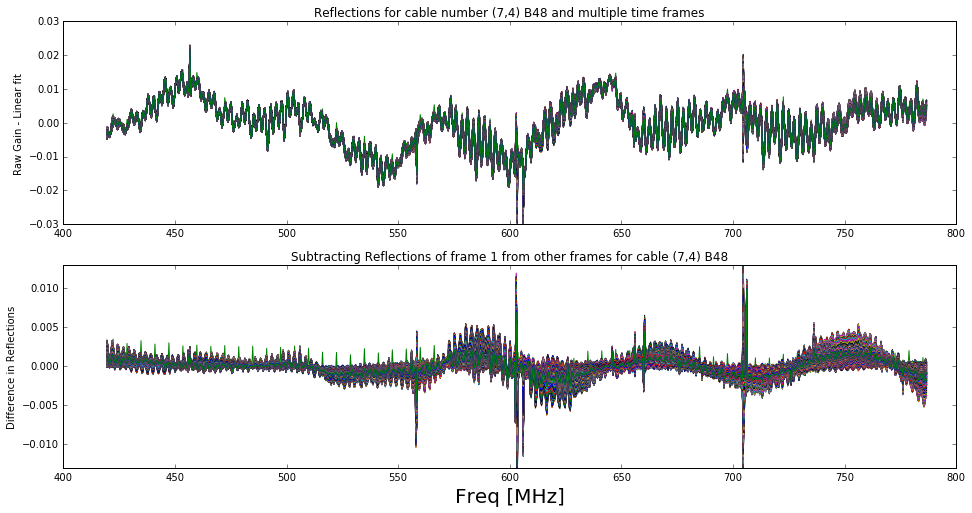

In [257]:
k=0
temp_intercept_model = time_1[42::]
time_intercept_model = time_partial_new[42::]
frame_numbers = np.linspace(0,800, num=800)
val_single_freq_bin1 = np.zeros(len(frame_numbers))
val_single_freq_bin2 = np.zeros(len(frame_numbers))
val_single_freq_bin3 = np.zeros(len(frame_numbers))
val_single_freq_bin4 = np.zeros(len(frame_numbers))

val_all_freq = []
val_all_freq_pre = np.zeros((len(frame_numbers),len(freq_phase[50:990])))
count=0
calc_avg = []

for i in range(len(corr_list)):
    val_all_freq.append([])

plt_count=0        
for kk in range(len(corr_list)):
    
    val_all_freq[kk] = np.zeros((len(frame_numbers),len(freq_phase[50:990])))
    plt_count = plt_count+1
      
    for i in range(len(frame_numbers)):
        
        gain_raw = gain_all[frame_numbers[i],kk,:] # for cable 2
        z=np.polyfit(freq_phase[50:990], gain_raw,1)
        p=np.poly1d(z)
        gain_line_sub = gain_raw - p(freq_phase[50:990])

        if i==0:
            print('only one')
            gain_line_sub_reference = gain_line_sub
            gain_reference = gain_raw
        
        plt.figure(plt_count)
        plt.subplot(2,1,1)
        plt.plot(freq_phase[50:990], gain_line_sub )
        plt.ylim(-0.03,0.03)
        plt.title('Reflections for cable number %s and multiple time frames' %(str(legend_crosscorr[kk])))
        plt.ylabel('Raw Gain - Linear fit')
        #plt.xlabel('Freq [MHz]', size=20)

        #plt.figure(plt_count+2)
        plt.subplot(2,1,2)
        plt.plot(freq_phase[50:990],gain_line_sub- gain_line_sub_reference)
        plt.ylim(-0.013,0.013)
        plt.title('Subtracting Reflections of frame 1 from other frames for cable %s' %(str(legend_crosscorr[kk])),)
        plt.ylabel('Difference in Reflections')
        plt.xlabel('Freq [MHz]', size=20)

        for k in range(len(freq_phase[50:990])):
            val_all_freq[kk][i][k] = gain_line_sub[k]- gain_line_sub_reference[k]
            val_all_freq_pre[i,k] = gain_line_sub[k]

        val_single_freq_bin1[i] = gain_line_sub[459]- gain_line_sub_reference[459]
        val_single_freq_bin2[i] = gain_line_sub[460]- gain_line_sub_reference[460]
        val_single_freq_bin3[i] = gain_line_sub[461]- gain_line_sub_reference[461]
        val_single_freq_bin4[i] = gain_line_sub[700]- gain_line_sub_reference[700]

        #plt.figure(plt_count+3)
        #plt.subplot(3,1,3)
        #plt.plot(freq_phase[50:990],(gain_line_sub)/gain_reference)
        #plt.xlabel('Freq [MHz]', size=20)
        
    plt.savefig('times-800-reflection %s .png' %(legend_crosscorr[kk]))
print(freq_phase[459])
print(freq_phase[200])
    

0
1
2
3
4
5
6


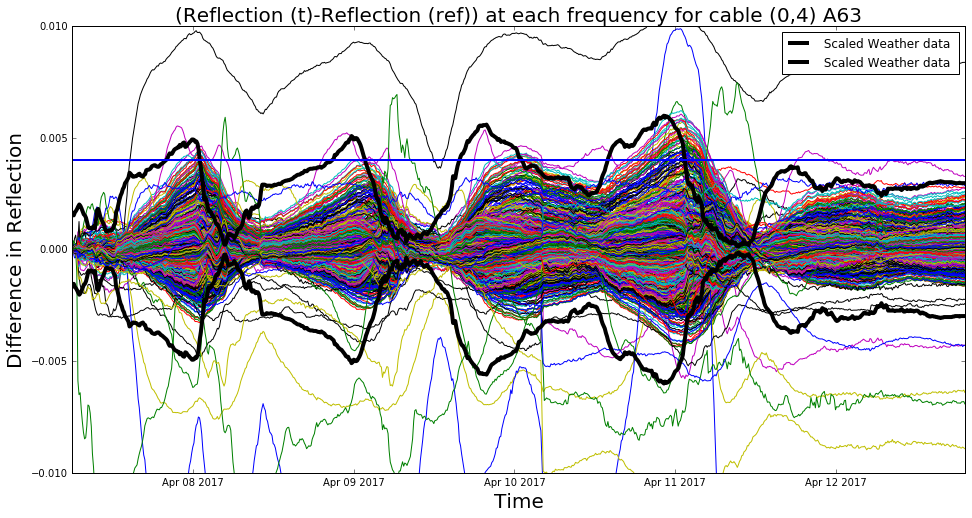

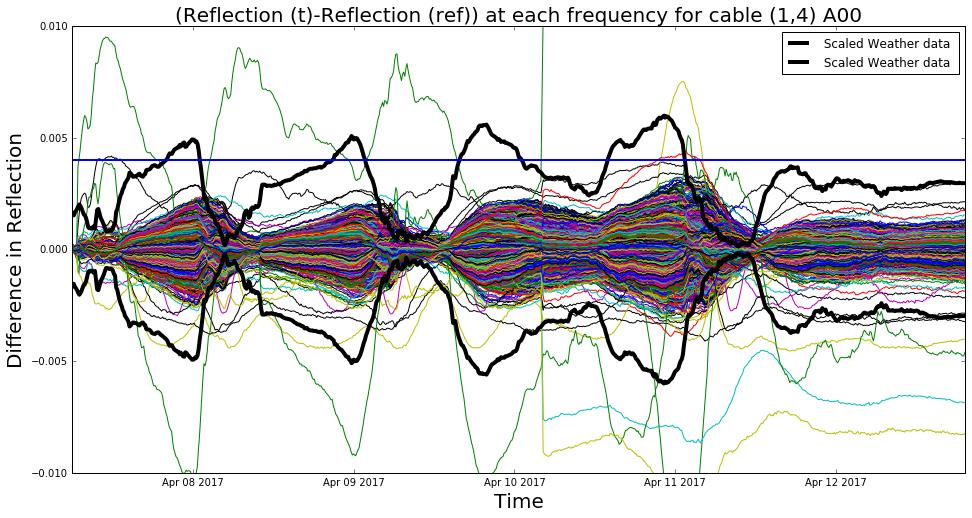

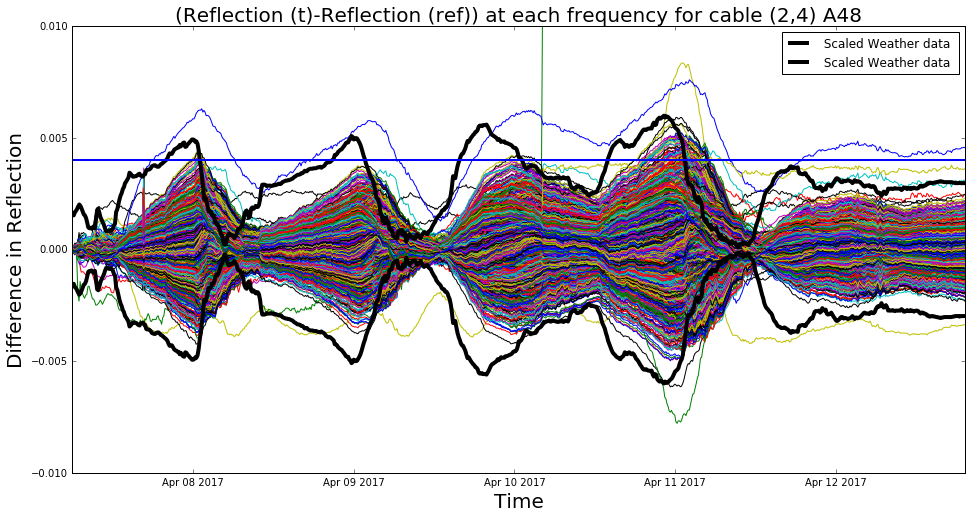

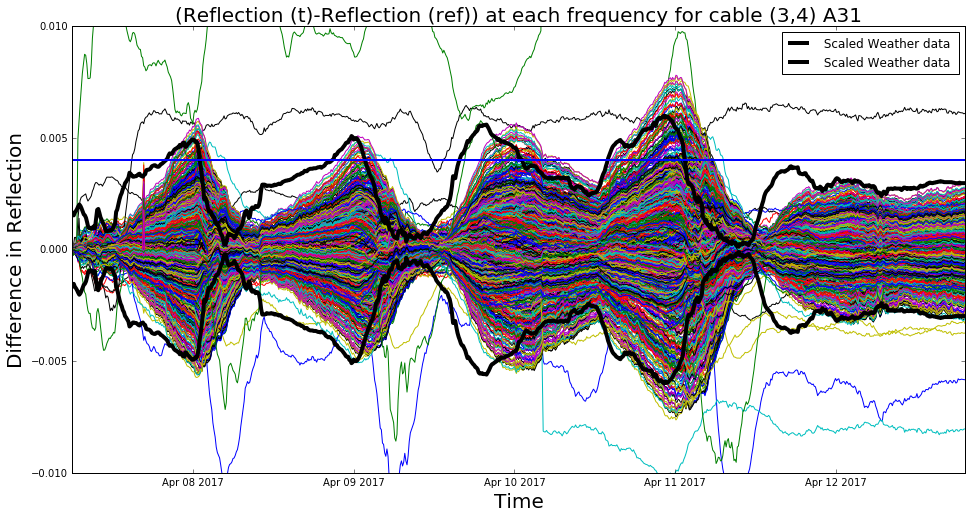

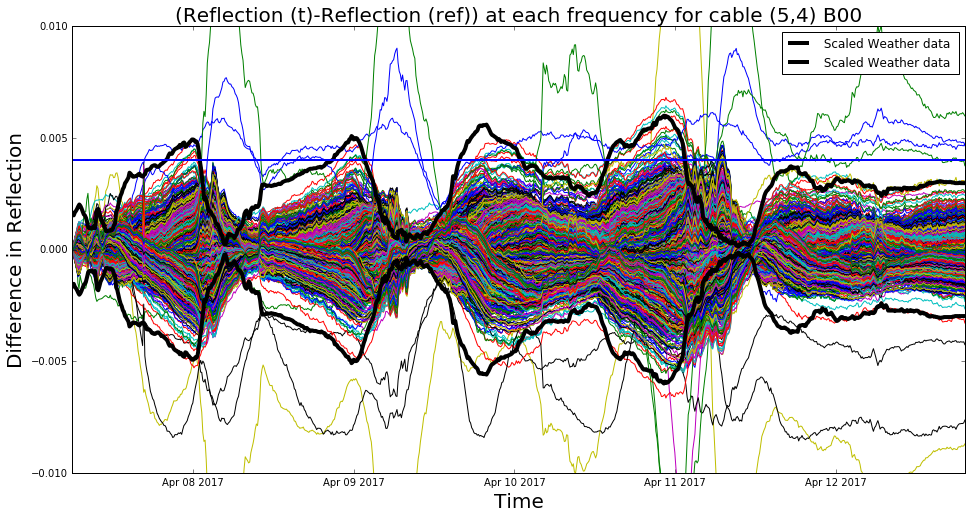

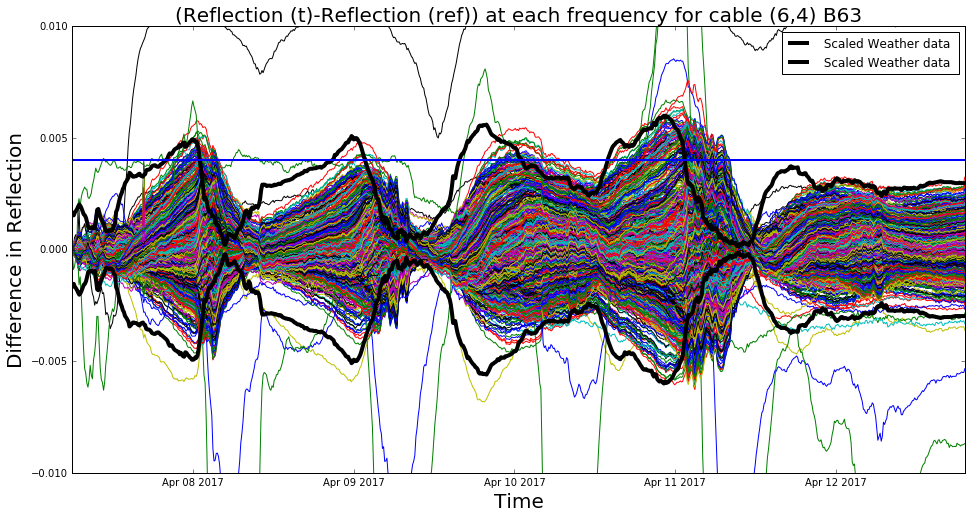

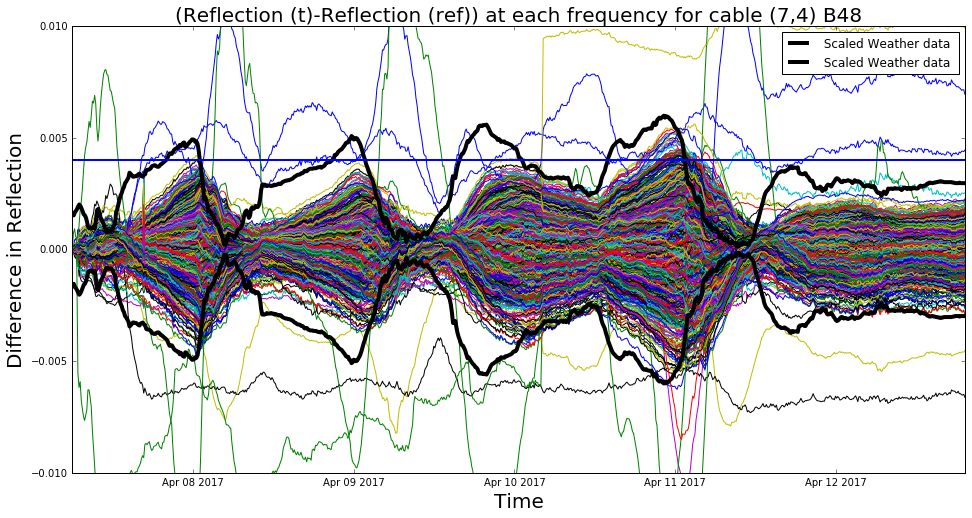

In [269]:
for kk in range(len(corr_list)):
    print(kk)
    for k in range(len(freq_phase[50:990])):
        plt.figure(kk+1)
        plt.plot(date_stamp[0:800],val_all_freq[kk][:,k])
    plt.ylim(-0.01,0.01)
    plt.plot(time_intercept_model[0:800],2*((temp_intercept_model[0:800]+273)/5000 -0.057), 'k',linewidth =4,label= ' Scaled Weather data ')   
    plt.plot(time_intercept_model[0:800],-2*((temp_intercept_model[0:800]+273)/5000 -0.057), 'k',linewidth =4,label= ' Scaled Weather data ')
    plt.title('(Reflection (t,f) - Reflection (ref,f)) at each frequency for cable %s' %(legend_crosscorr[kk]), size =20)
    plt.ylabel('Difference in Reflection', size =20)
    plt.xlabel('Time', size=20)
    plt.axhline(y=0.004,linewidth=2)
    plt.legend()
    #plt.savefig('diff_reflection %s.png' %(legend_crosscorr[kk]))

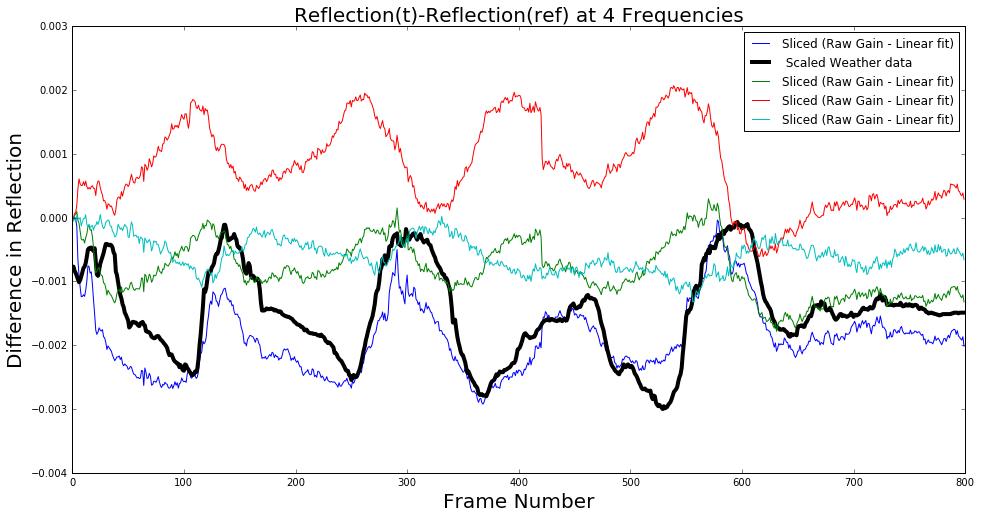

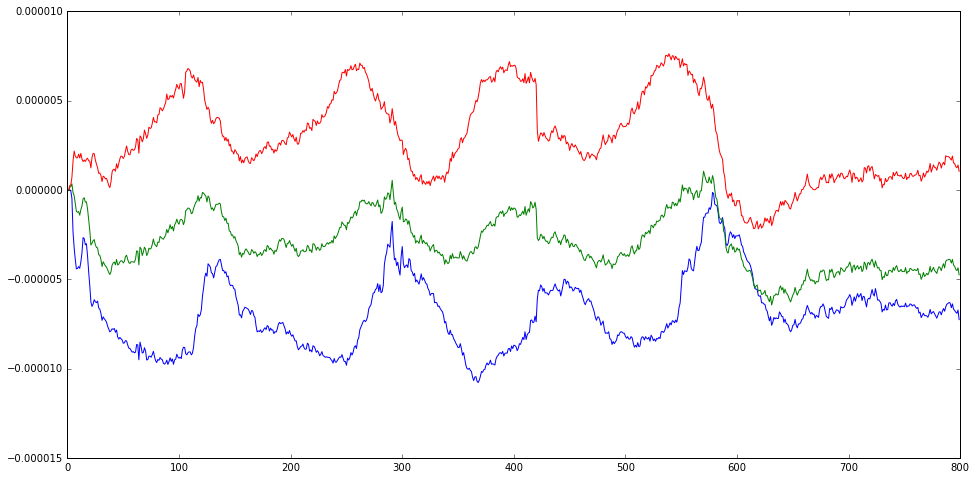

In [42]:
plt.figure(1)
plt.plot(val_single_freq_bin1, label = 'Sliced (Raw Gain - Linear fit)')
plt.plot((temp_intercept_model[0:800]+273)/5000 -0.057, 'k',linewidth =4,label= ' Scaled Weather data ')
plt.plot(val_single_freq_bin2, label = 'Sliced (Raw Gain - Linear fit)')
plt.plot(val_single_freq_bin3, label = 'Sliced (Raw Gain - Linear fit)')
plt.plot(val_single_freq_bin4, label = 'Sliced (Raw Gain - Linear fit)')
plt.xlabel('Frame Number', size=20)
plt.ylabel('Difference in Reflection', size =20)
plt.title('Reflection(t)-Reflection(ref) at 4 Frequencies', size =20)

plt.legend()

plt.figure(2)
plt.plot(val_single_freq_bin1/(temp_intercept_model[0:800]+273))
plt.plot(val_single_freq_bin2/(temp_intercept_model[0:800]+273))
plt.plot(val_single_freq_bin3/(temp_intercept_model[0:800]+273))

In [38]:
file = open("temp_data_all.out","r")
date_temp = np.loadtxt('temp_data_all.out')
file.close()

date_weather_data_new = date_temp[0]
temp_weather_data_new = date_temp[1]

temp_frame = [718,120,718,236,718,718,718,526,50,718,106,718]

a= date_weather_data_new[0:718]
b= temp_weather_data_new[0:718]
temp_1 = np.append(a[::2],a[717])
time_1 = np.append(b[::2],b[717])

a= date_weather_data_new[718:838]
b= temp_weather_data_new[718:838]
temp_1 = np.append(temp_1,a[::2])
temp_1 = np.append(temp_1,a[119])
time_1 = np.append(time_1,b[::2])
time_1 = np.append(time_1,b[119])

a= date_weather_data_new[838:1556]
b= temp_weather_data_new[838:1556]
temp_1 = np.append(temp_1,a[::2])
temp_1 = np.append(temp_1,a[717])
time_1 = np.append(time_1,b[::2])
time_1 = np.append(time_1,b[717])

a= date_weather_data_new[1556:1792]
b= temp_weather_data_new[1556:1792]
temp_1 = np.append(temp_1,a[::2])
temp_1 = np.append(temp_1,a[235])
time_1 = np.append(time_1,b[::2])
time_1 = np.append(time_1,b[235])

a= date_weather_data_new[1792:2510]
b= temp_weather_data_new[1792:2510]
temp_1 = np.append(temp_1,a[::2])
temp_1 = np.append(temp_1,a[717])
time_1 = np.append(time_1,b[::2])
time_1 = np.append(time_1,b[717])

a= date_weather_data_new[2510:3228]
b= temp_weather_data_new[2510:3228]
temp_1 = np.append(temp_1,a[::2])
temp_1 = np.append(temp_1,a[717])
time_1 = np.append(time_1,b[::2])
time_1 = np.append(time_1,b[717])

a= date_weather_data_new[3228:3946]
b= temp_weather_data_new[3228:3946]
temp_1 = np.append(temp_1,a[::2])
temp_1 = np.append(temp_1,a[717])
time_1 = np.append(time_1,b[::2])
time_1 = np.append(time_1,b[717])

a= date_weather_data_new[3946:4472]
print(len(a))
b= temp_weather_data_new[3946:4472]
temp_1 = np.append(temp_1,a[::2])
temp_1 = np.append(temp_1,a[525])
time_1 = np.append(time_1,b[::2])
time_1 = np.append(time_1,b[525])

time_partial_new = np.array([(datetime.datetime.fromtimestamp(x)) + datetime.timedelta(hours=-7)  for x in temp_1 ])


526


In [43]:
val_all_freq = []

for i in range(len(corr_list)):
    val_all_freq.append([])
    
val_all_freq[1] = np.zeros((len(frame_numbers),len(freq_phase[50:990])))   

In [44]:
val_all_freq[1].shape

(800, 940)

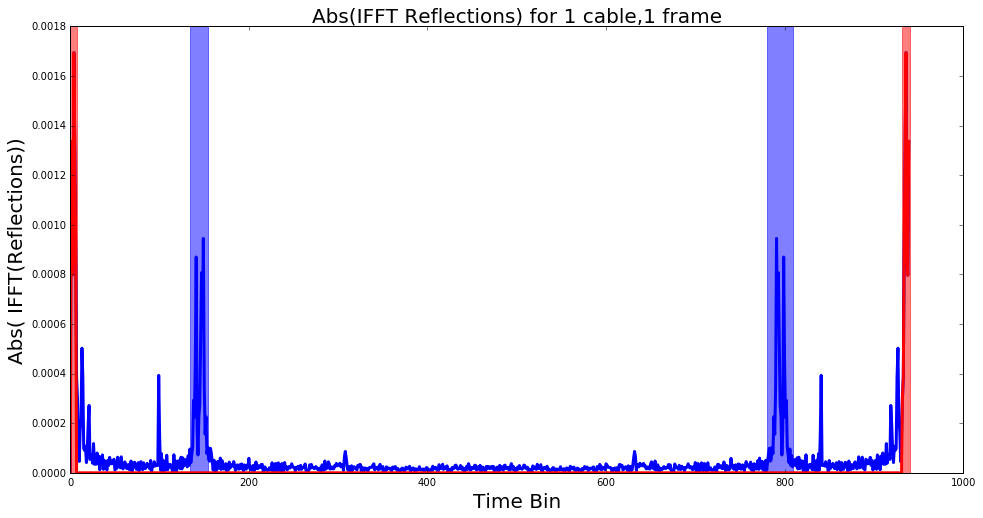

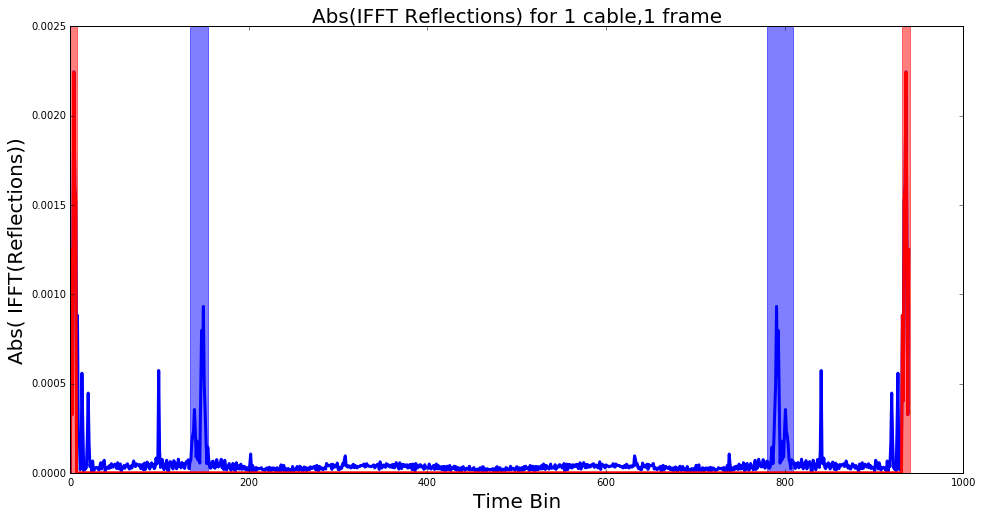

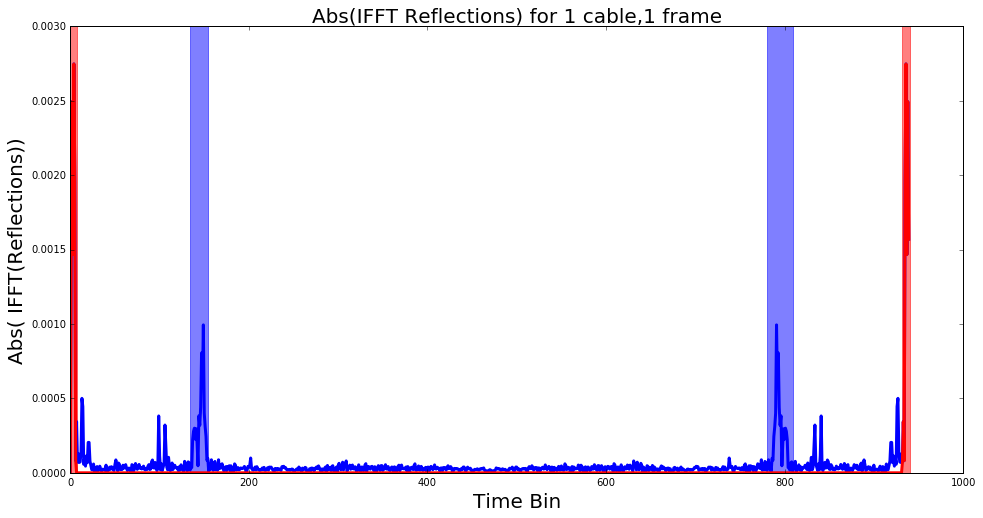

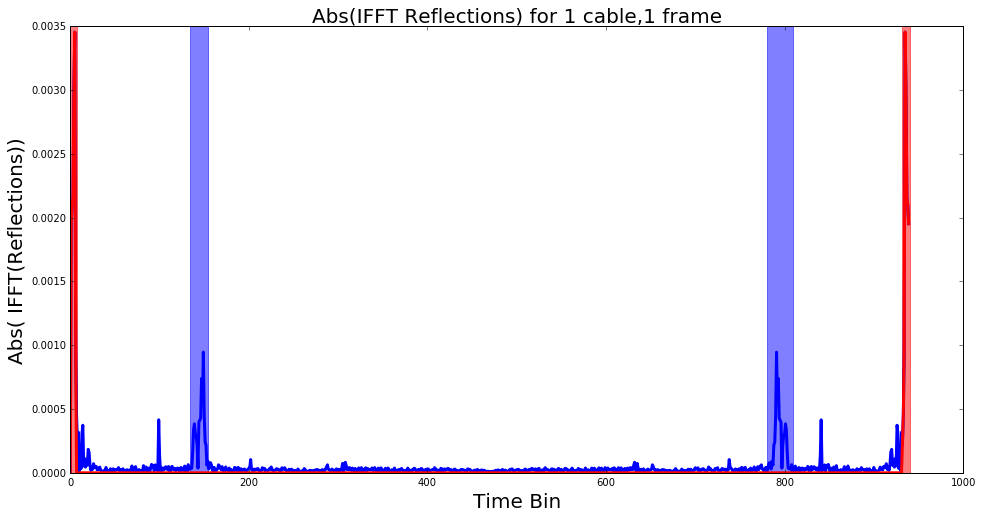

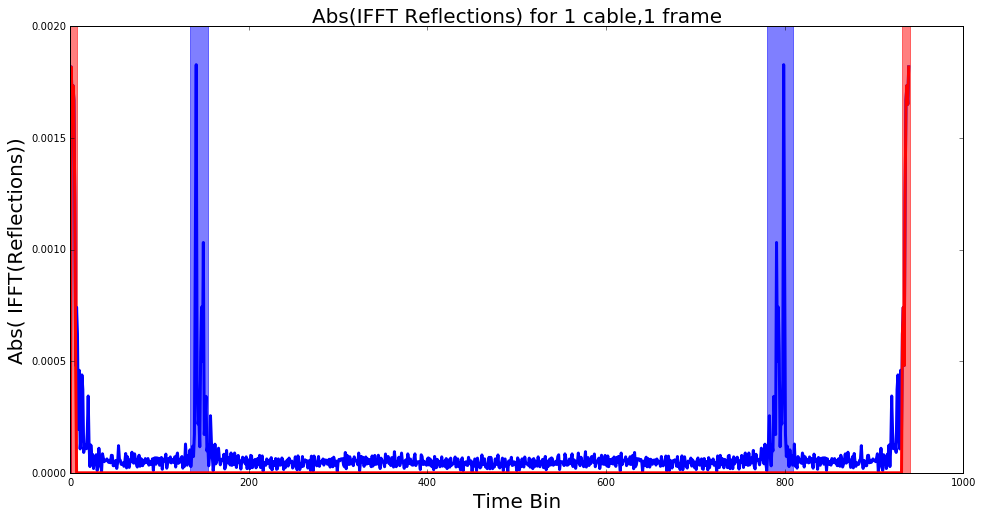

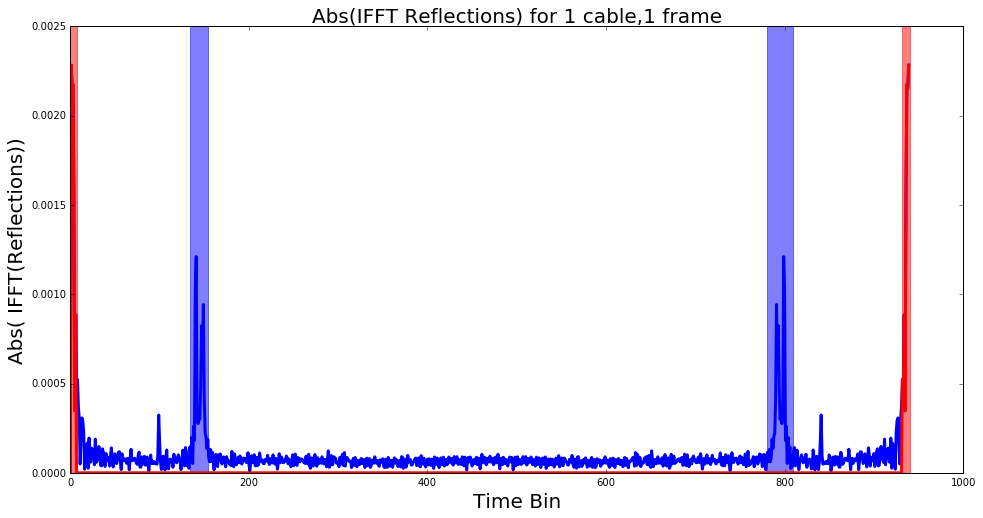

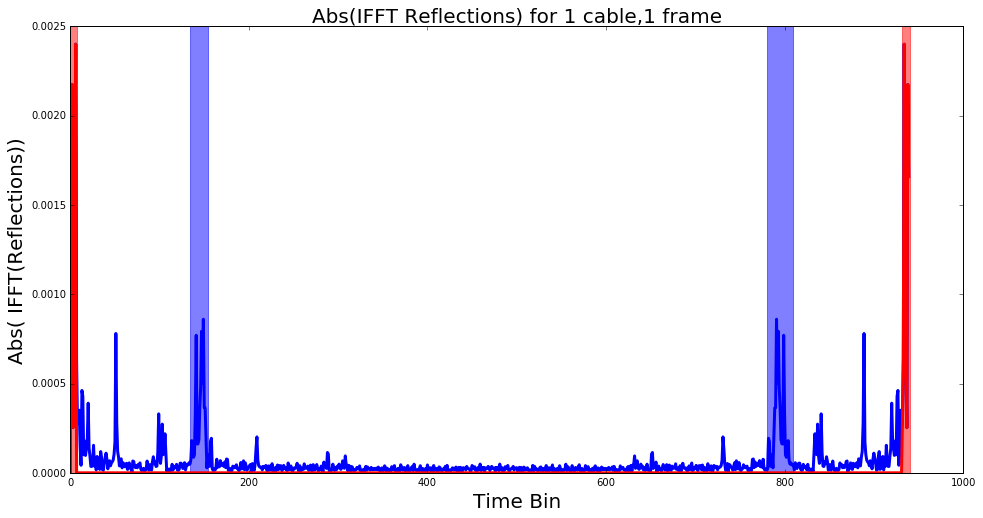

In [284]:
components_all_cables=[]
amplitude_all_cables=[]
gain_all_line_sub=[]

kk=1
for k in range(len(corr_list)):
 
    components=[]
    amplitude =[]

    z=np.polyfit(freq_phase[50:990], gain_all[0,k,:],1)
    p=np.poly1d(z)
    gain_line_sub = gain_all[0,k,:] - p(freq_phase[50:990])
    gain_all_line_sub.append(gain_line_sub)

    ifft_component = np.fft.ifft(gain_line_sub)  
    ifft_component0 = np.fft.ifft(gain_line_sub) 
    end = len(ifft_component)
    '''
    for i in range(end):
        if np.abs(ifft_component[i]) > 18*np.mean(np.abs(ifft_component)):#-np.mean(np.abs(ifft_component))/2:
            components.append(i)
            amplitude.append(np.abs(ifft_component[i]))
    '''
    for i in range(end):
        if (i<7) or (i>931):
            components.append(i)
            amplitude.append(np.abs(ifft_component[i]))
    
    end_components = len(components)

    for i in range(len(ifft_component)):
        if i  not in components: 
            ifft_component0[i] = 0

    plt.figure(k+kk)

    plt.plot(np.abs(ifft_component),'b',linewidth=3,label='IFFT after removal of linear fit from gain')
    plt.plot(np.abs(ifft_component0), 'r',linewidth=3, label='IFFT after removal of linear fit from gain and keeping reflection components and zeroing the white noise')
    plt.title('Abs(IFFT Reflections) for 1 cable,1 frame', size =20)
    plt.ylabel('Abs( IFFT(Reflections))', size=20)
    plt.xlabel('Time Bin',size=20)
    #plt.xlim(0,10)
    #plt.axhline(y=18*np.mean(np.abs(ifft_component)))
    #plt.axvline(x=5)
    #plt.xlim(900,len(ifft_component0))
    
    plt.axvspan(0, 7, alpha=0.5, color='red')
    plt.axvspan(931, 940, alpha=0.5, color='red')
                         
    plt.axvspan(134, 154, alpha=0.5, color='blue')
    plt.axvspan(780, 810, alpha=0.5, color='blue')
    #plt.legend()
    
    components_all_cables.append(components)
    amplitude_all_cables.append(amplitude)
    

In [167]:
def my_sin(term2,amp,phase,n):
    return amp*np.sin(n*term2 + phase)

parameters_all_cables=[]

for k in range(len(corr_list)):
    parameters = np.zeros(shape=(np.int(len(components_all_cables[k])),3))
    
    for i in range(np.int(len(components_all_cables[k]))):
        ifft_component = np.fft.ifft(gain_all_line_sub[k])
        ifft_reflection = np.fft.ifft(gain_all_line_sub[k])

        for kk in range(len(ifft_component)):
            if kk != components_all_cables[k][i]:
                ifft_reflection[kk]=0

        ifft_reflections_half = np.real(np.fft.fft(ifft_reflection))
        
        N= len(freq_phase[50:990])
        term2 = np.arange(N) 

        guess_amplitude = np.max(ifft_reflections_half)
        guess_phase = 0.75 #1.5 
        n=2*np.pi*components_all_cables[k][i]/940
        
        if i==2:
            guess_phase = 1.5
        if i==9:
            guess_phase = np.pi

        guess_offset = np.mean(ifft_reflections_half) 
        p0=[ guess_amplitude, guess_phase, n]

        fit = curve_fit(my_sin, term2, ifft_reflections_half, p0=p0)
        data_fit = my_sin(term2, *fit[0])

        fit_leastsq = leastsq(lambda p: my_sin(term2, *p) - ifft_reflections_half, p0)
        parameters[i,:]= fit[0]
        
    parameters_all_cables.append(parameters)

C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\scipy\optimize\minpack.py:690: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


In [168]:
print((components_all_cables[1][1]))

1


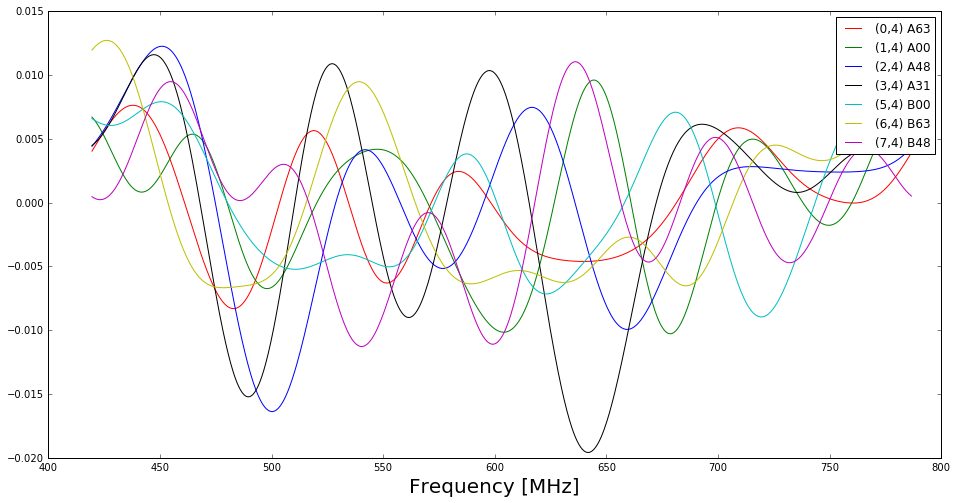

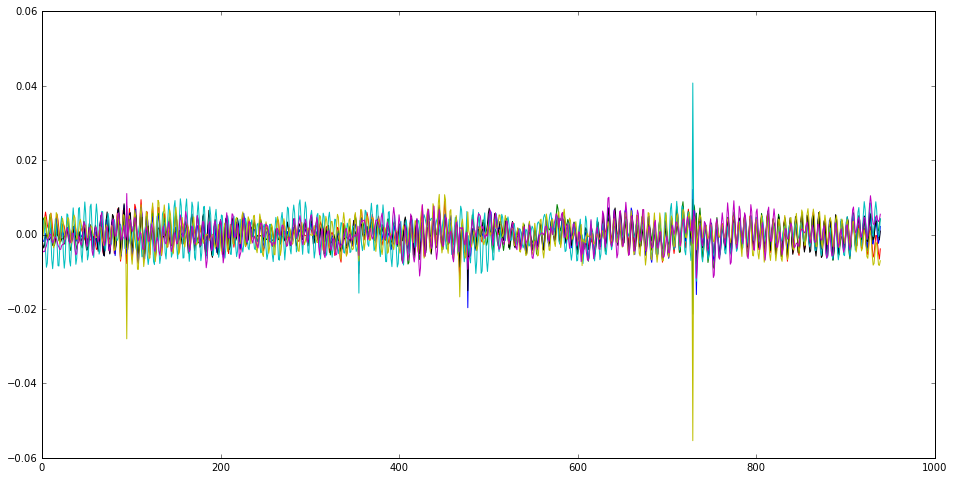

In [169]:
figure(figsize(16,8))

reflections_generate_all_cable=[]
reflections_generate_one_cable = np.zeros(len(gain_all[0,1,:]))


for k in range(len(corr_list)):
    
    z=np.polyfit(freq_phase[50:990], gain_all[0,k,:],1)
    p=np.poly1d(z)
    gain_line_sub = gain_all[0,k,:] - p(freq_phase[50:990])
    
    
    reflections_generate_one_cable = np.zeros(len(gain_all[0,1,:]))
    #print(np.int(len(parameters_all_cables[k][i])))
    for i in range(np.int(len(parameters_all_cables[k]))):
        reflections_generate_one_cable = reflections_generate_one_cable + my_sin(term2, *parameters_all_cables[k][i][:])
    
    reflections_generate_all_cable.append(reflections_generate_one_cable)
    plt.figure(1)
    plt.plot(freq_phase[50:990],reflections_generate_one_cable, color=colors[k], label = legend_crosscorr[k])
    plt.title('')
    plt.xlabel('Frequency [MHz]', size=20)
    plt.legend()
    
    plt.figure(2)
    plt.plot(gain_line_sub-reflections_generate_one_cable, color=colors[k])
    #plt.ylim(-0.005,0.005)

C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\numpy\core\numeric.py:482: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


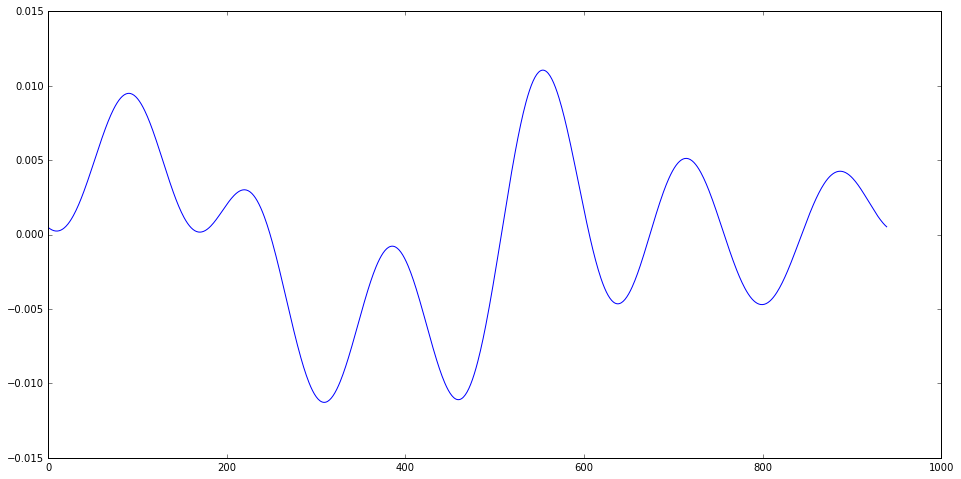

In [170]:
plt.plot(np.fft.fft(ifft_component0))

# Reflections due to short cables only

0


C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\ipykernel\__main__.py:42: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\numpy\core\numeric.py:482: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


1
2
3
4
5
6


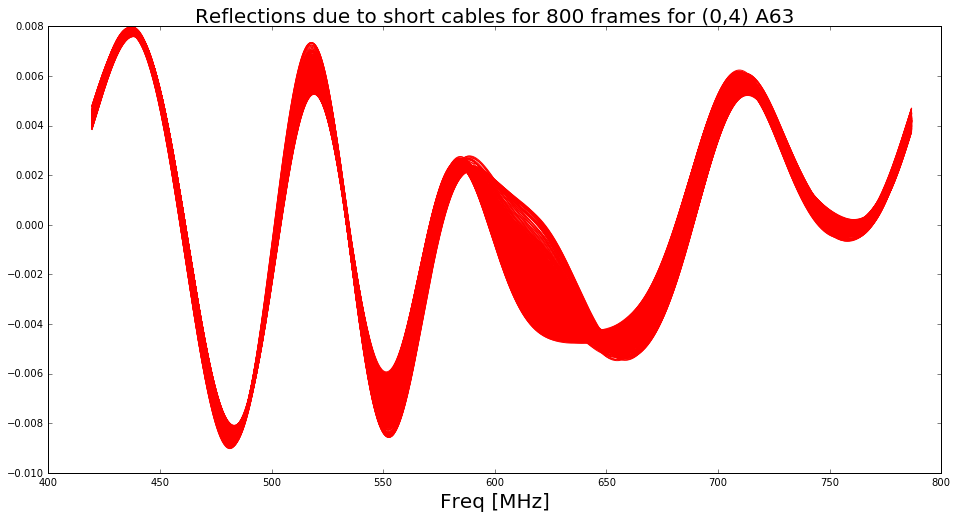

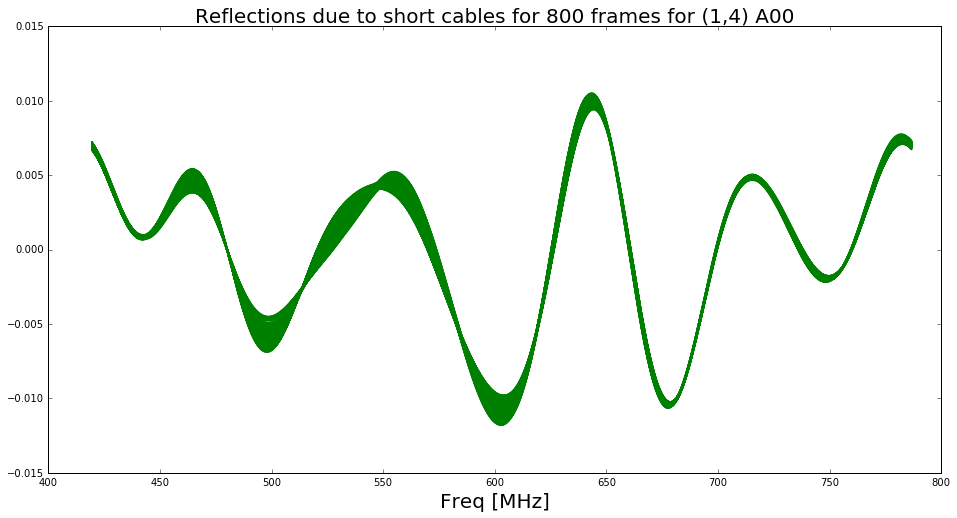

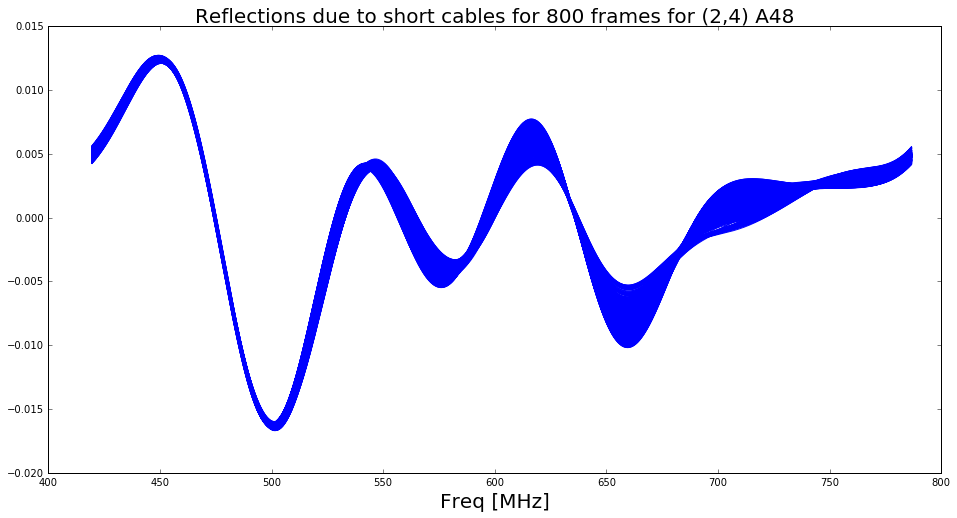

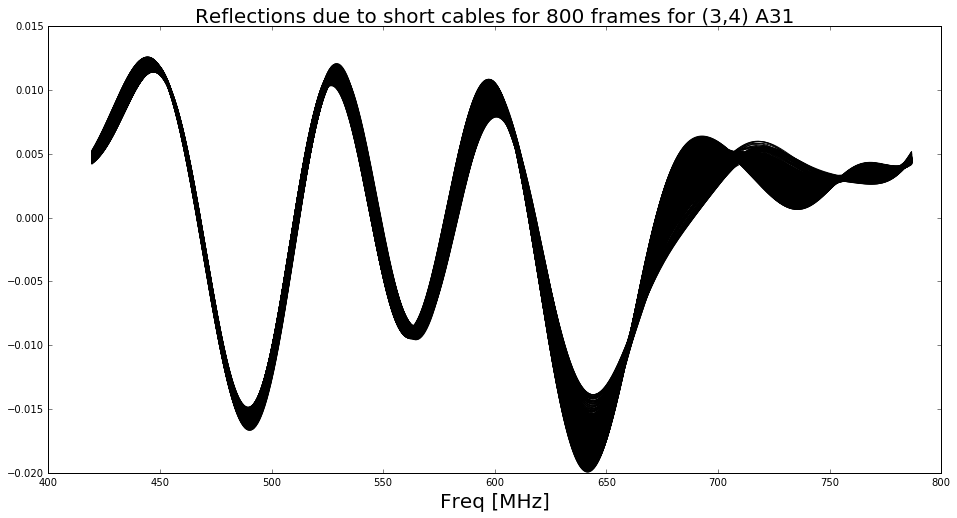

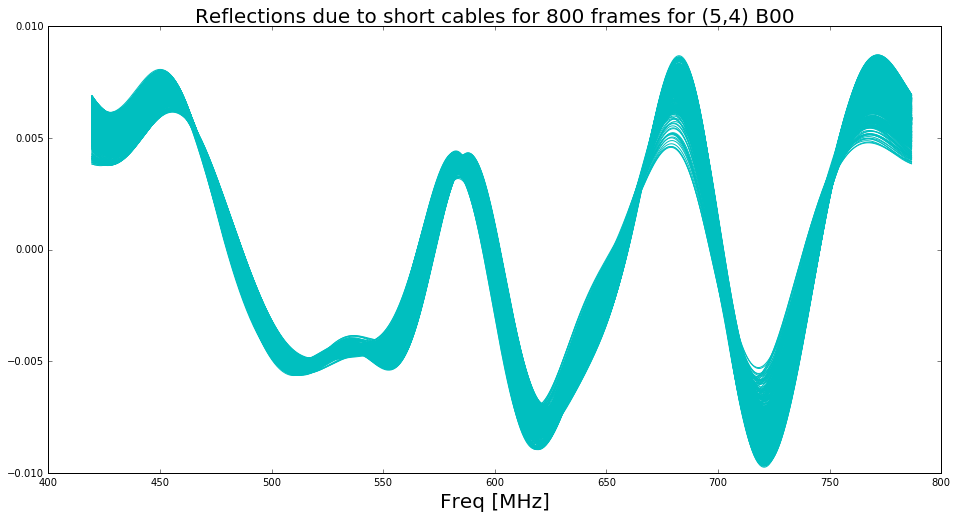

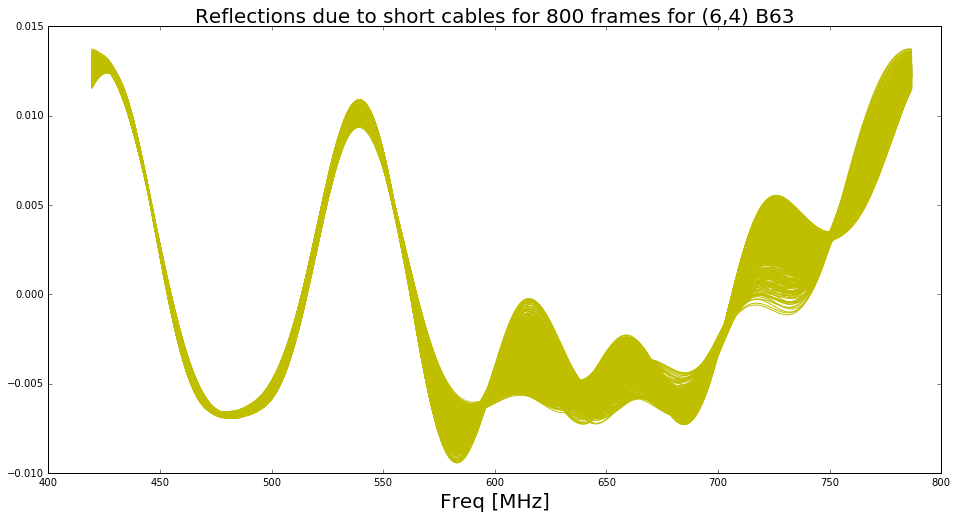

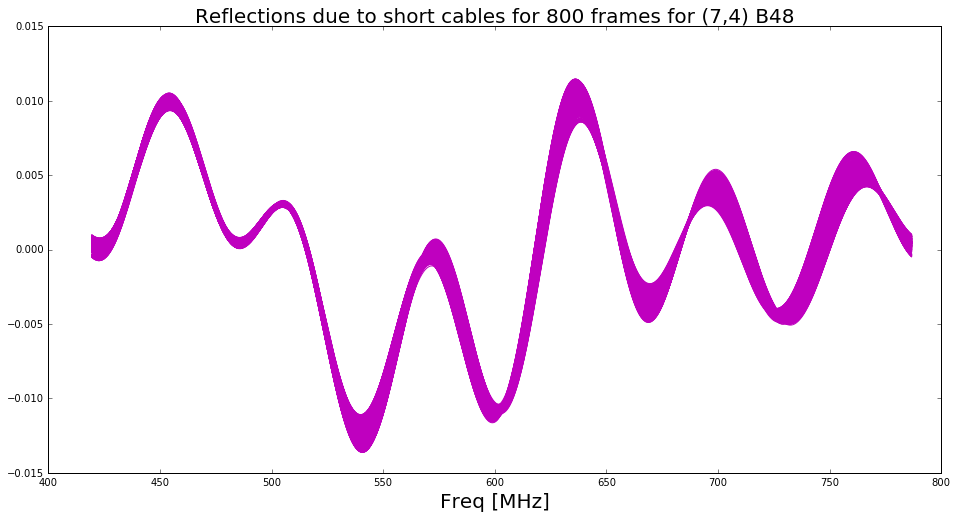

In [282]:
value_all_600 =[]

for i in range(len(corr_list)):
    value_all_600.append([])

for k in range(len(corr_list)):
    print(k)
    value_all_600[k] = np.zeros((800,len(freq_phase[50:990])))
    fft_reflections_ref=[]
    
    for ii in range(800):
        components=[]
        amplitude =[]
        z=np.polyfit(freq_phase[50:990], gain_all[ii,k,:],1)
        p=np.poly1d(z)
        gain_line_sub = gain_all[ii,k,:] - p(freq_phase[50:990])
        gain_all_line_sub.append(gain_line_sub)

        ifft_component = np.fft.ifft(gain_line_sub)  
        ifft_component0 = np.fft.ifft(gain_line_sub) 
        end = len(ifft_component)
        '''
        for i in range(end):
            if np.abs(ifft_component[i]) > 18*np.mean(np.abs(ifft_component)):#-np.mean(np.abs(ifft_component))/2:
                components.append(i)
                amplitude.append(np.abs(ifft_component[i]))
        '''        
        for i in range(end):
            if (i<7) or (i>931):
                components.append(i)
                amplitude.append(np.abs(ifft_component[i]))
        
        for i in range(len(ifft_component)):
            if i not in components: 
                ifft_component0[i] = 0
        
        fft_reflections = np.fft.fft(ifft_component0) 
        if ii==0:
            fft_reflections_ref = fft_reflections
        
        for kk in range(len(freq_phase[50:990])):
            value_all_600[k][ii][kk] = fft_reflections[kk] - fft_reflections_ref[kk]
    
        plt.figure(k+1)
        plt.plot(freq_phase[50:990],fft_reflections, color=colors[k])
        plt.title('Reflections due to short cables for 800 frames for %s' %(legend_crosscorr[k]), size=20)
        plt.xlabel('Freq [MHz]', size=20)
    #plt.savefig('reflection_short cables %s.png' %(legend_crosscorr[k]))
    

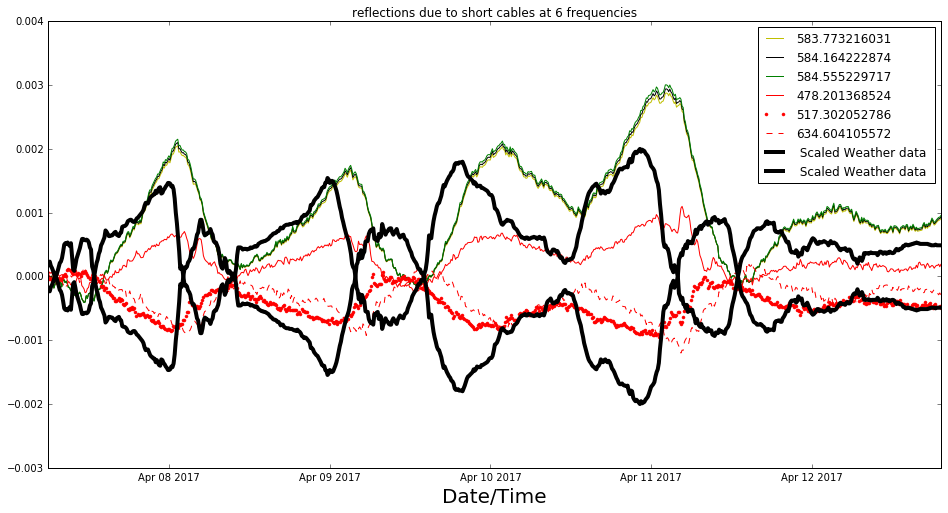

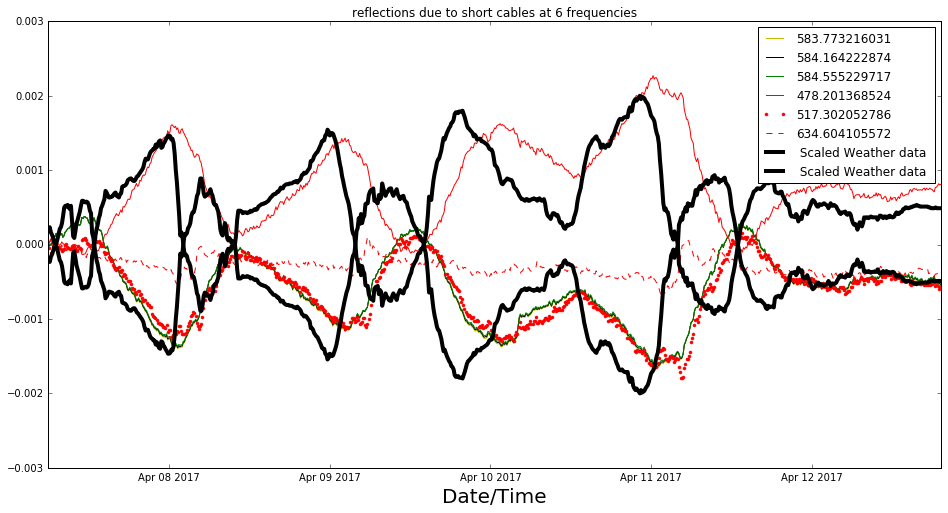

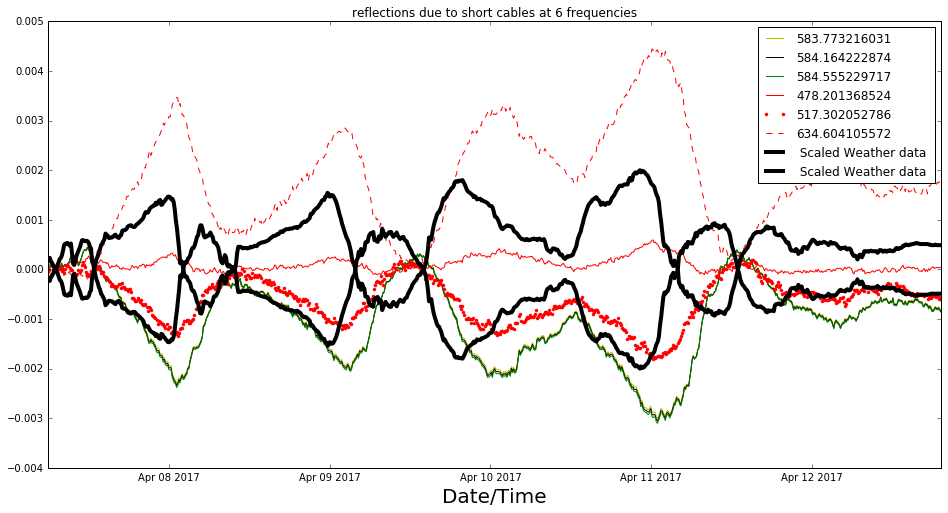

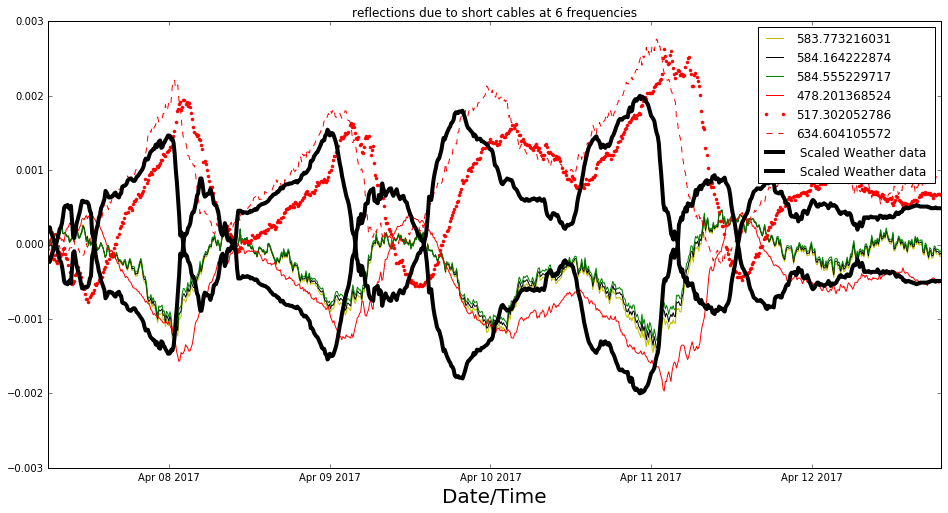

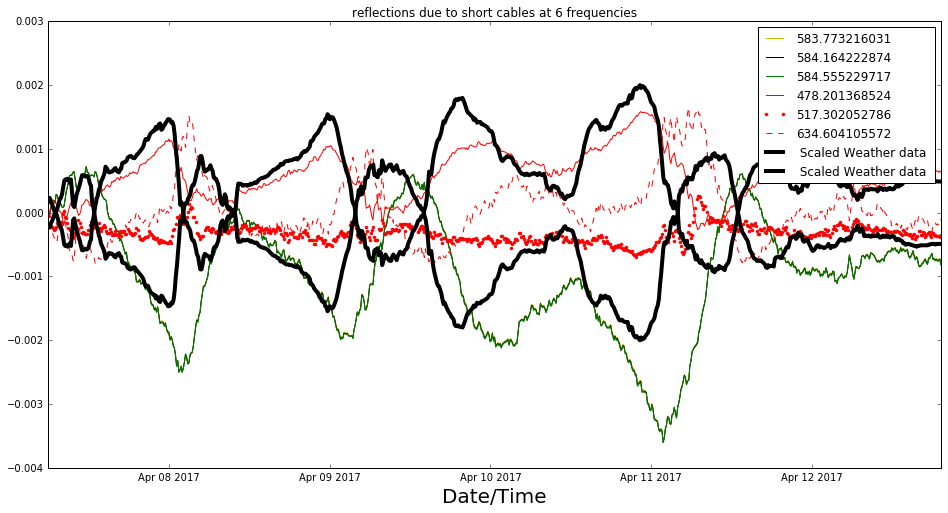

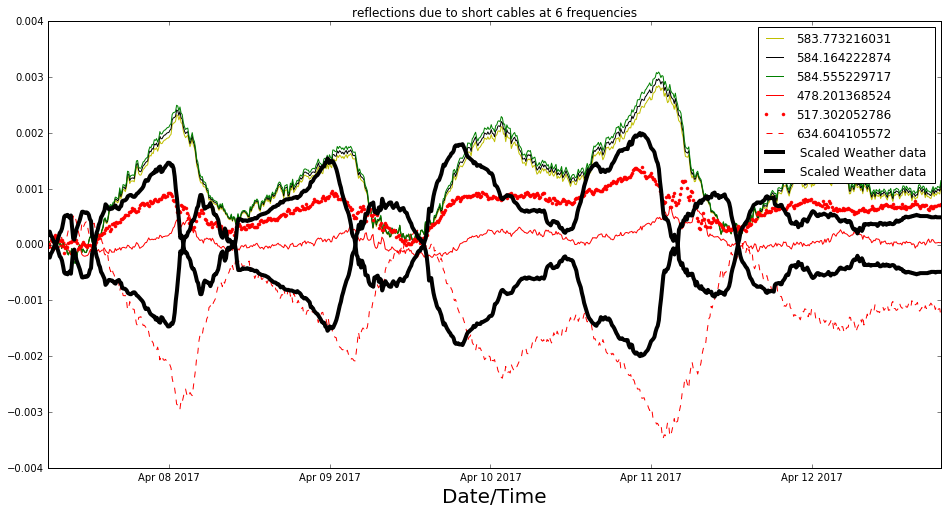

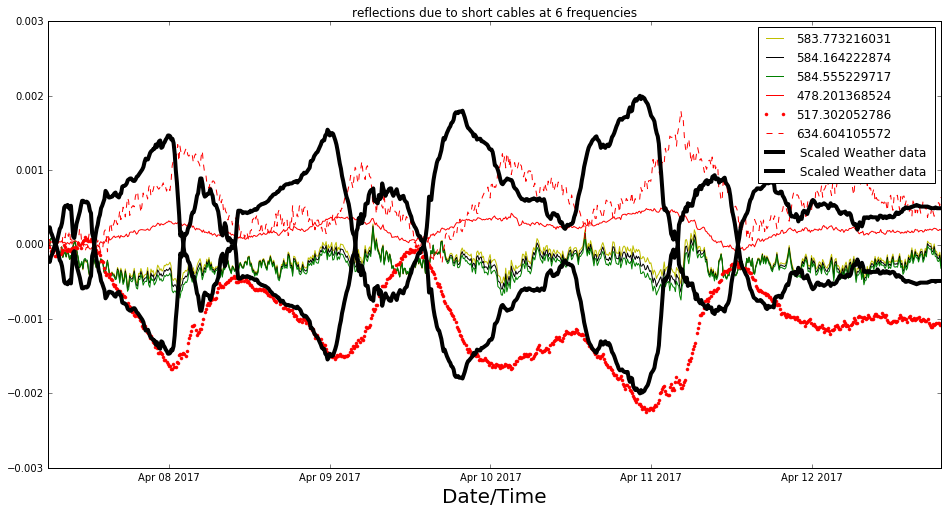

In [206]:
for k in range(len(corr_list)):
    
    plt.figure(k+1)
    plt.plot(date_stamp[0:800],value_all_600[k][:,freq], 'y', label=str(freq_phase[freq]))
    plt.plot(date_stamp[0:800],value_all_600[k][:,freq+1],'k', label=str(freq_phase[freq+1]))
    plt.plot(date_stamp[0:800],value_all_600[k][:,freq+2],'g', label=str(freq_phase[freq+2]))
    plt.plot(date_stamp[0:800],value_all_600[k][:,200],'r', label=str(freq_phase[200]))
    plt.plot(date_stamp[0:800],value_all_600[k][:,300],'.r', label=str(freq_phase[300]))
    plt.plot(date_stamp[0:800],value_all_600[k][:,600],'--r', label=str(freq_phase[600]))
    plt.plot(time_intercept_model[0:800],(2*((temp_intercept_model[0:800]+273)/10000 -0.057)+0.035)+0.023, 'k',linewidth =4,label= ' Scaled Weather data ')   
    plt.plot(time_intercept_model[0:800],-(2*((temp_intercept_model[0:800]+273)/10000 -0.057)+0.035+0.023), 'k',linewidth =4,label= ' Scaled Weather data ')
    #plt.plot(time_intercept_model[0:800],(2*((temp_intercept_model[0:800]+273)/10000 -0.057)+0.035)-0.023, 'k',linewidth =4,label= ' Scaled Weather data ')   
    plt.title('reflections due to short cables at 6 frequencies')
    plt.xlabel('Date/Time', size=20)
    plt.legend()

In [ ]:
# Reflections due to short cables, 300 frequencies
# Doubt: If claim is that the reflections is due to short cables(2m) in vestibule, thenthere should be roughle same temperature there


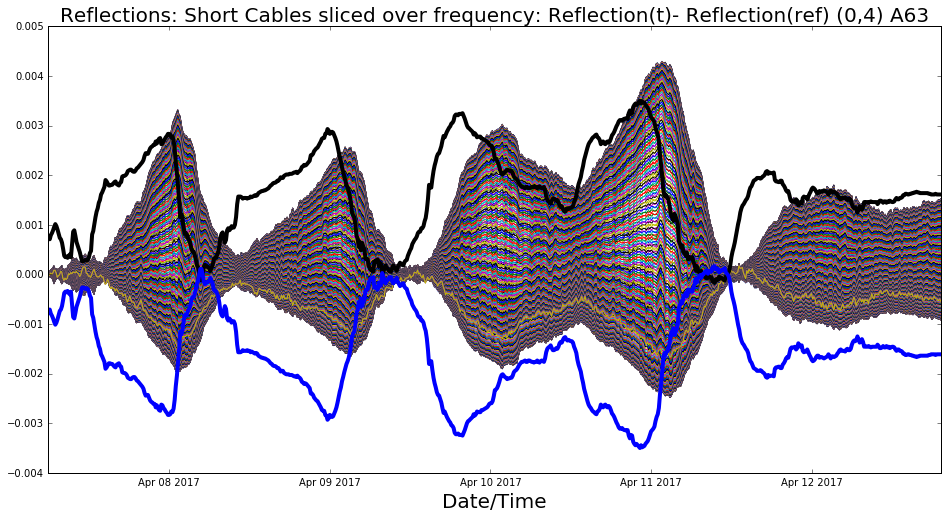

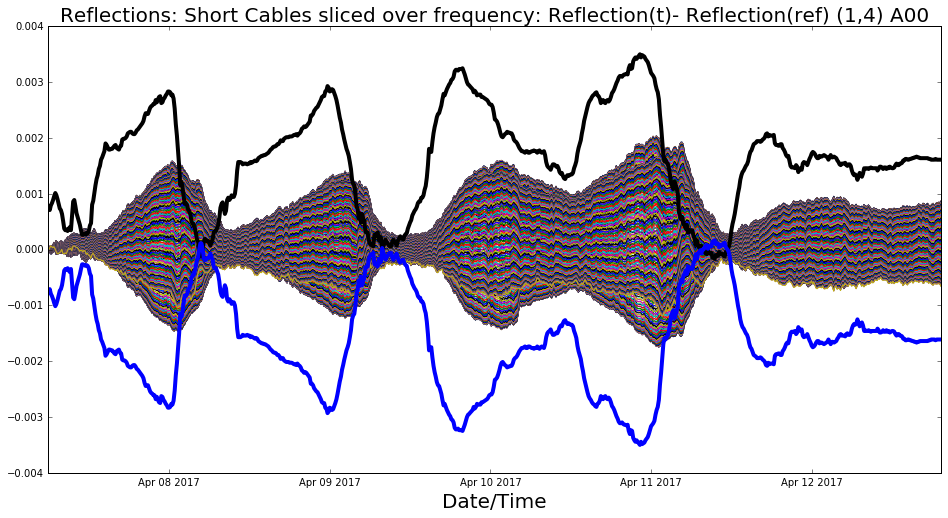

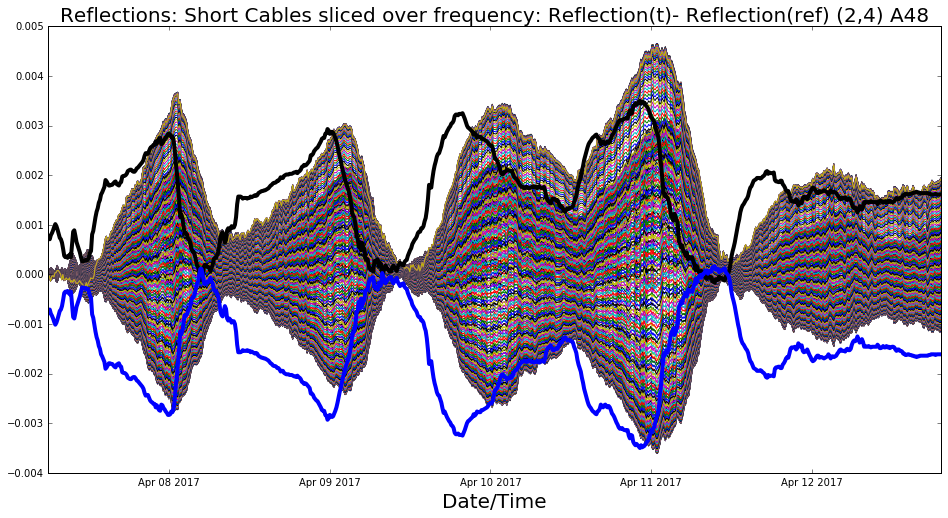

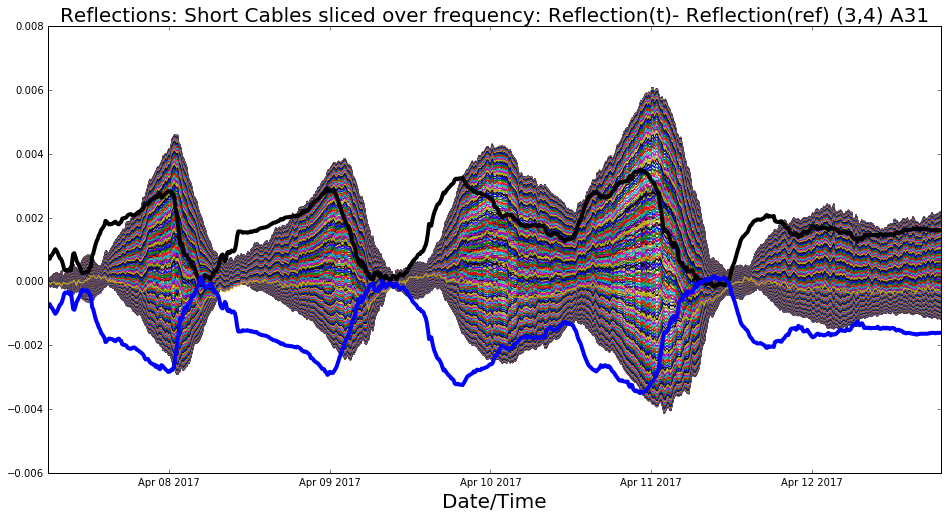

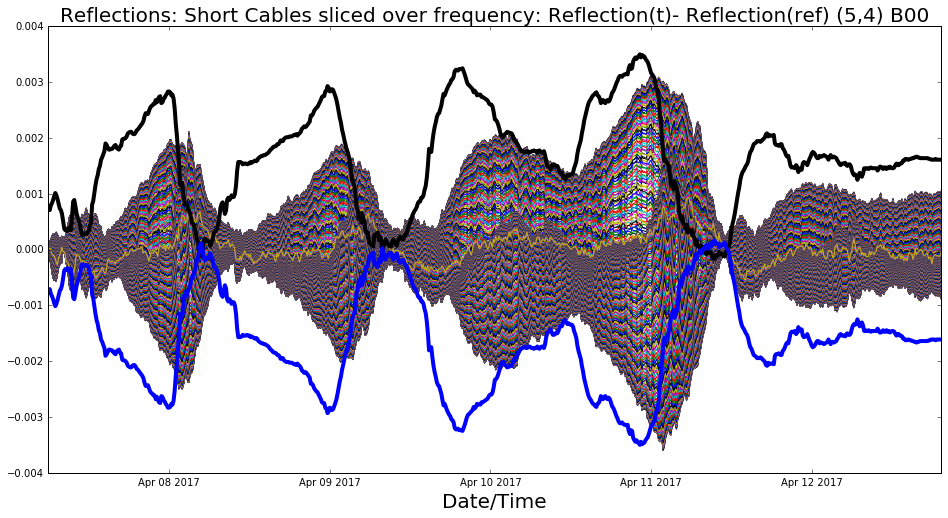

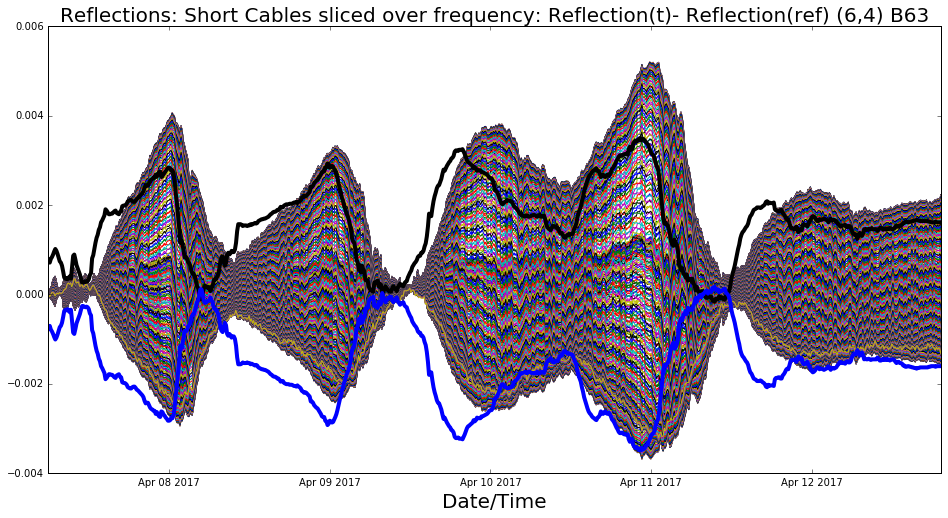

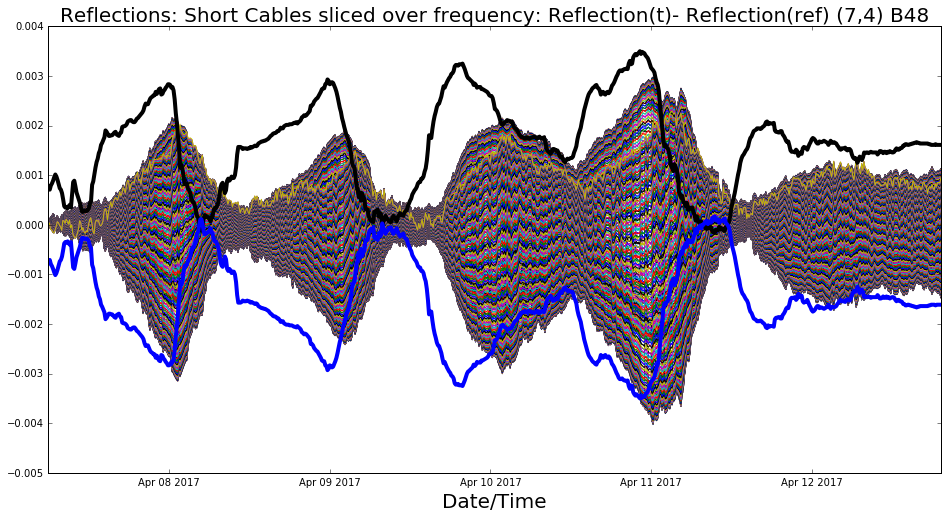

In [283]:
for k in range(len(corr_list)):
    for i in range(len(freq_phase[690:990])):
        plt.figure(k+1)
        plt.plot(date_stamp[0:800],value_all_600[k][:,freq-150+i])
    plt.plot(time_intercept_model[0:800],-(2*((temp_intercept_model[0:800]+273)/8000 -0.057)+0.006+0.04)+0.003, 'k',linewidth =4,label= ' Scaled Weather data ')   
    plt.plot(time_intercept_model[0:800],-(-(2*((temp_intercept_model[0:800]+273)/8000 -0.057)+0.006+0.04)+0.003), 'b',linewidth =4,label= ' Scaled Weather data ')
    plt.title('Reflections: Short Cables sliced over frequency: Reflection(t)- Reflection(ref) %s' %(legend_crosscorr[k]), size=20) 
    plt.xlabel('Date/Time', size=20)
    #plt.savefig('diff_reflection_short cables %s.png' %(legend_crosscorr[k]))

C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\matplotlib\axes\_axes.py:519: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


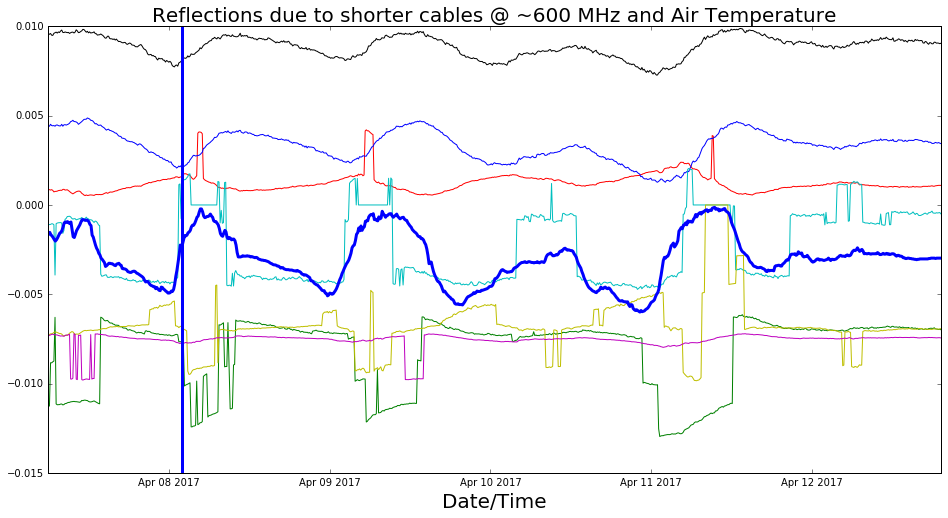

In [158]:
for k in range(len(corr_list)):
    
    plt.figure(1)
    plt.plot(date_stamp[0:800],value_all_600[k][:,freq], color=colors[k])
    plt.title('Reflections due to shorter cables @ ~600 MHz and Air Temperature', size=20)# , label = legend_crosscorr[k])
    plt.xlabel('Date/Time', size=20)
    
plt.plot(time_intercept_model[0:800],2*((temp_intercept_model[0:800]+273)/5000 -0.057), linewidth=3)
plt.axvline(x = date_stamp[120] , linewidth=3)
plt.legend()

# Reflections due to long cables

0


C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\ipykernel\__main__.py:42: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\numpy\core\numeric.py:482: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


1
2
3
4
5
6


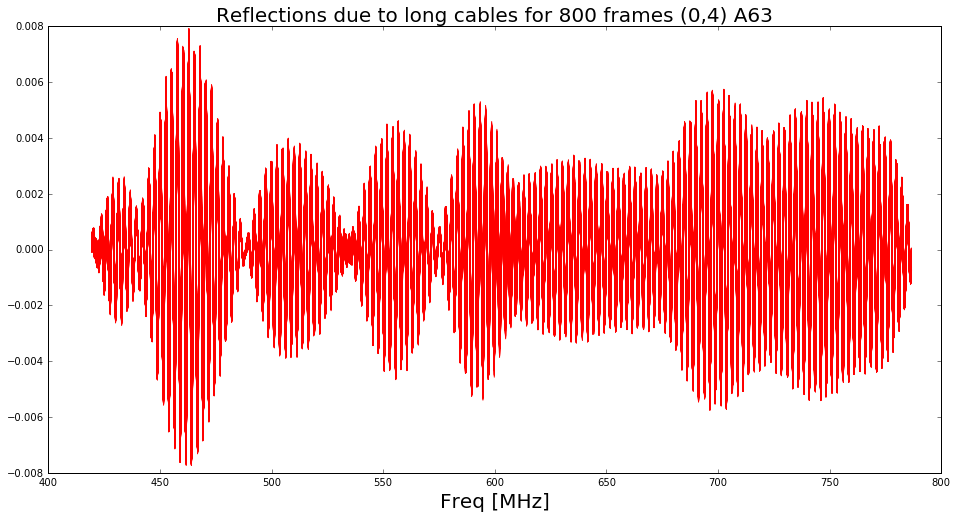

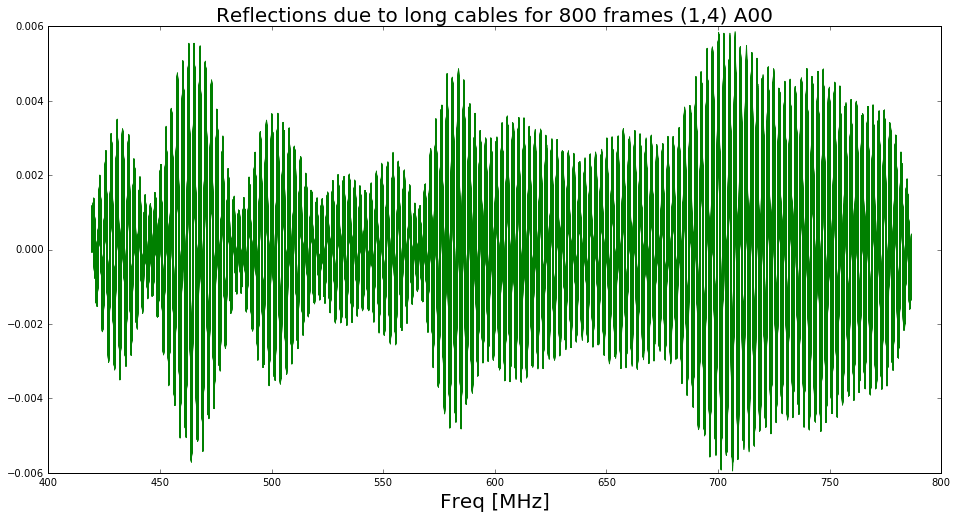

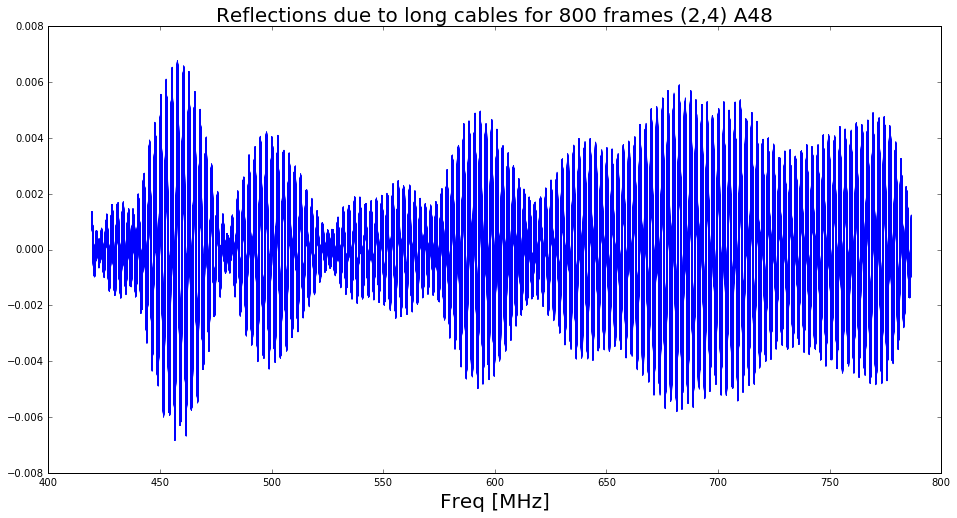

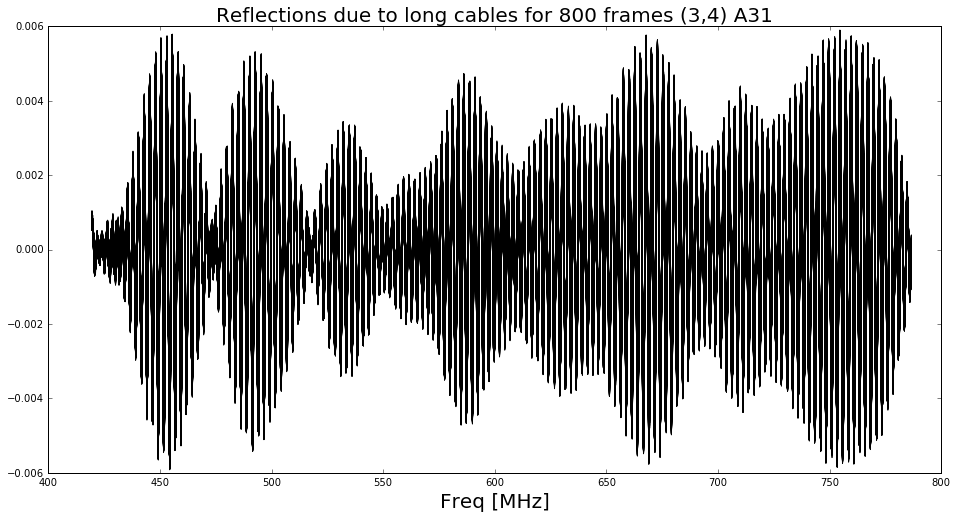

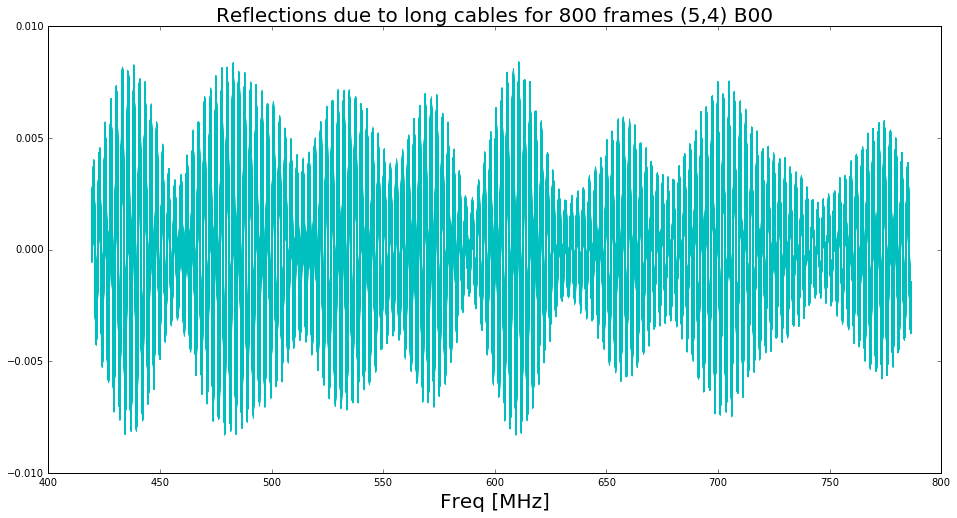

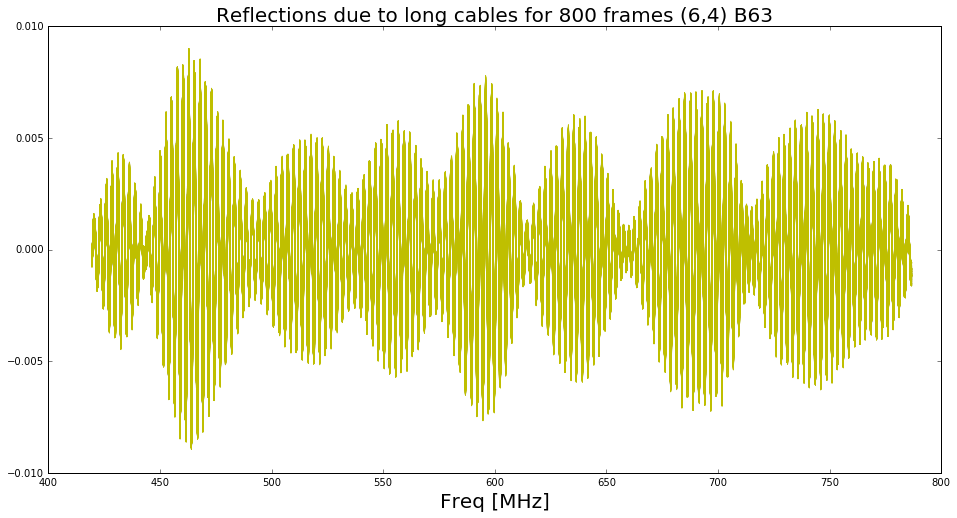

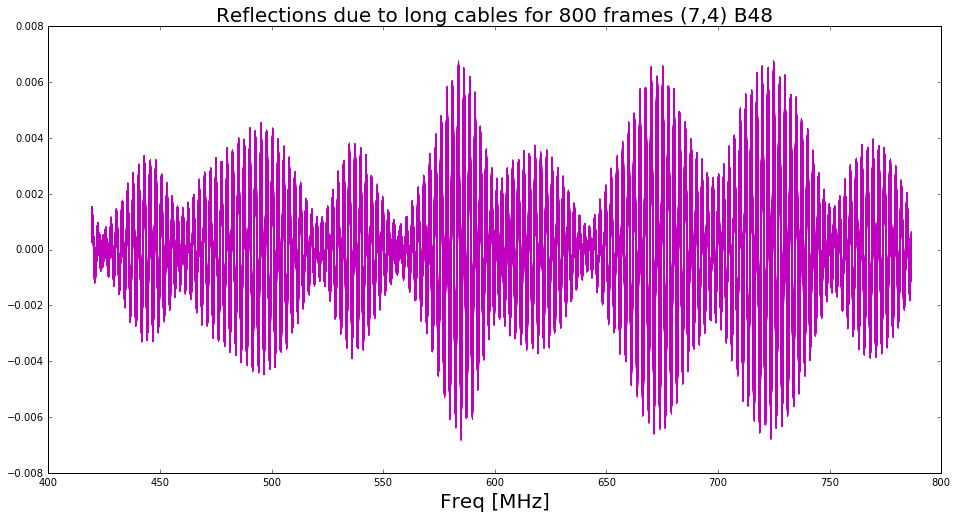

In [295]:
value_all_long_600 =[]

for i in range(len(corr_list)):
    value_all_long_600.append([])

for k in range(len(corr_list)):
    print(k)
    value_all_long_600[k] = np.zeros((800,len(freq_phase[50:990])))
    fft_reflections_ref=[]
    
    for ii in range(800):
        components=[]
        amplitude =[]
        z=np.polyfit(freq_phase[50:990], gain_all[ii,k,:],1)
        p=np.poly1d(z)
        gain_line_sub = gain_all[ii,k,:] - p(freq_phase[50:990])
        gain_all_line_sub.append(gain_line_sub)

        ifft_component = np.fft.ifft(gain_line_sub)  
        ifft_component0 = np.fft.ifft(gain_line_sub) 
        end = len(ifft_component)
        '''
        for i in range(end):
            if np.abs(ifft_component[i]) > 18*np.mean(np.abs(ifft_component)):#-np.mean(np.abs(ifft_component))/2:
                components.append(i)
                amplitude.append(np.abs(ifft_component[i]))
        '''        
        for i in range(end):
            if (i>134 and i<154) or (i>780 and i<810):
                components.append(i)
                amplitude.append(np.abs(ifft_component[i]))
        
        for i in range(len(ifft_component)):
            if i not in components: 
                ifft_component0[i] = 0
        
        fft_reflections = np.fft.fft(ifft_component0) 
        if ii==0:
            fft_reflections_ref = fft_reflections
        
        for kk in range(len(freq_phase[50:990])):
            value_all_long_600[k][ii][kk] = fft_reflections[kk] - fft_reflections_ref[kk]
    
        plt.figure(k+1)
        plt.plot(freq_phase[50:990],fft_reflections, color=colors[k])
        plt.title('Reflections due to long cables for 800 frames %s' %(legend_crosscorr[k]), size=20)
        plt.xlabel('Freq [MHz]', size=20)

    

In [127]:
print(len(value_all_long_cables_600[1]))

800


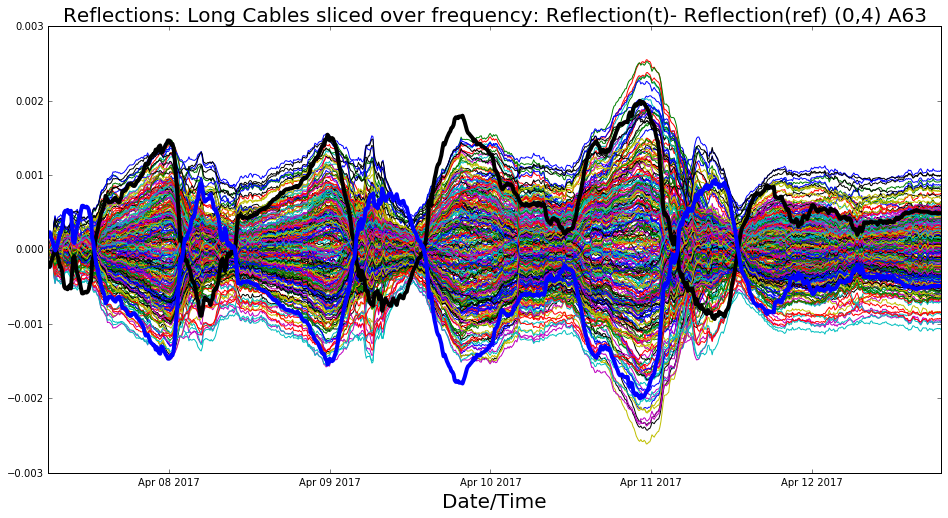

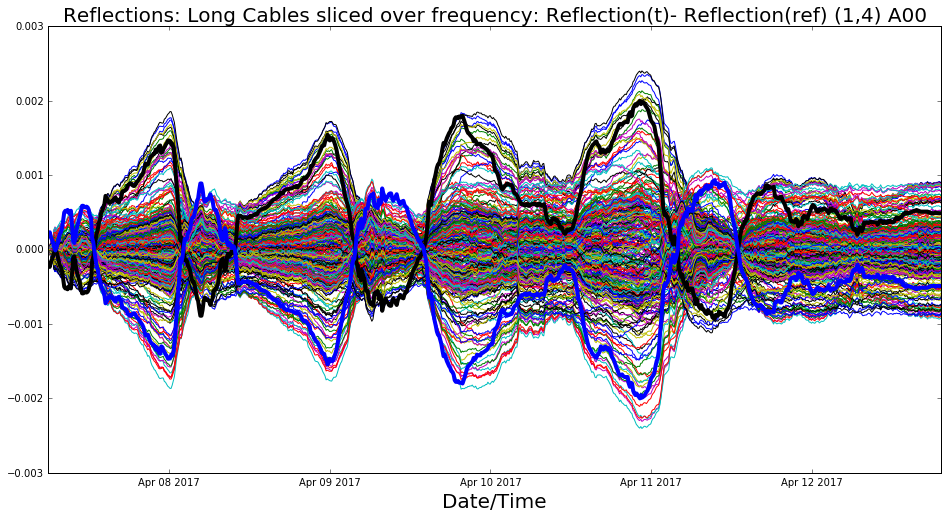

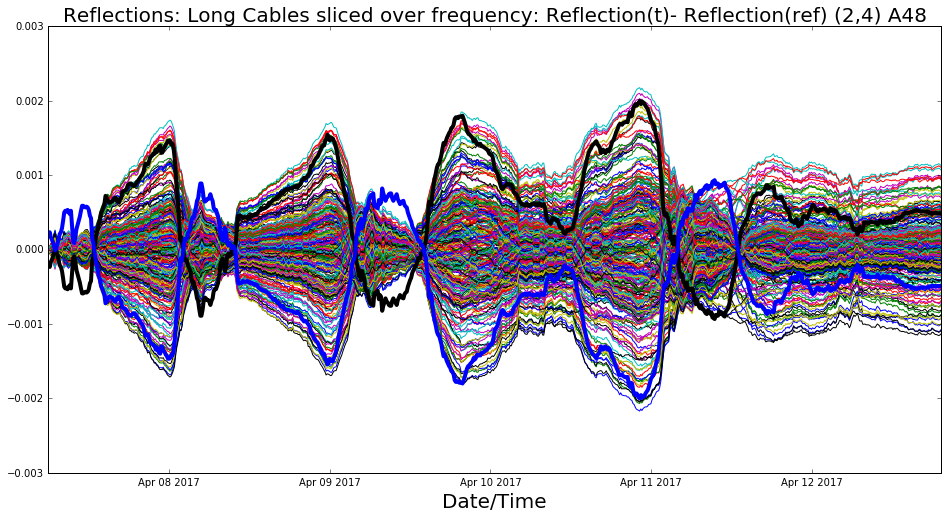

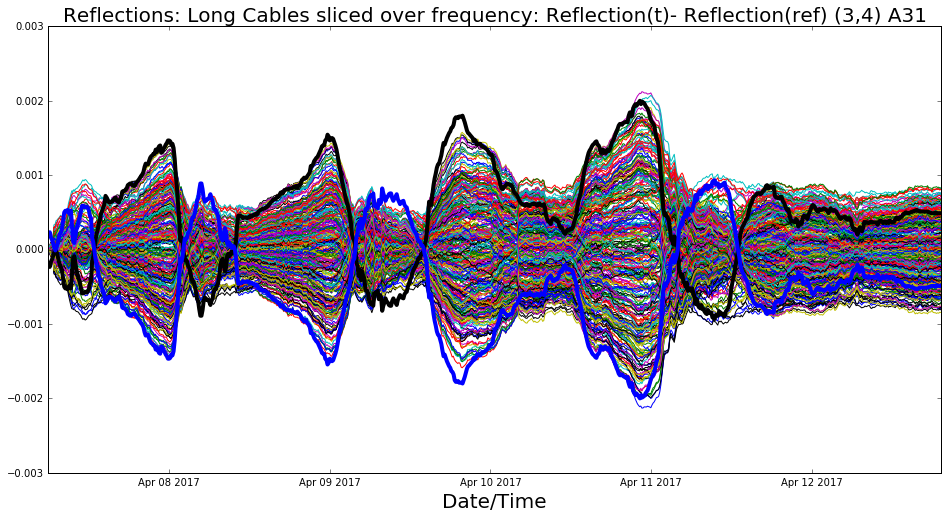

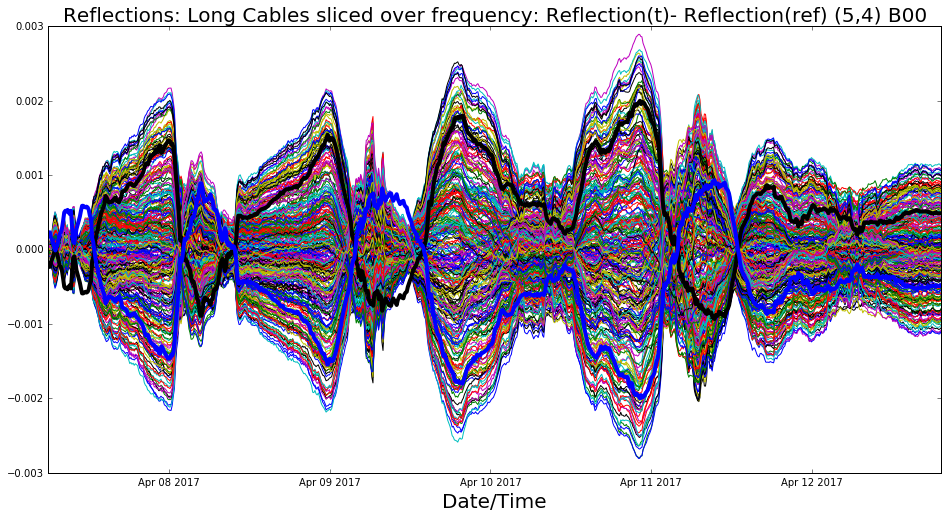

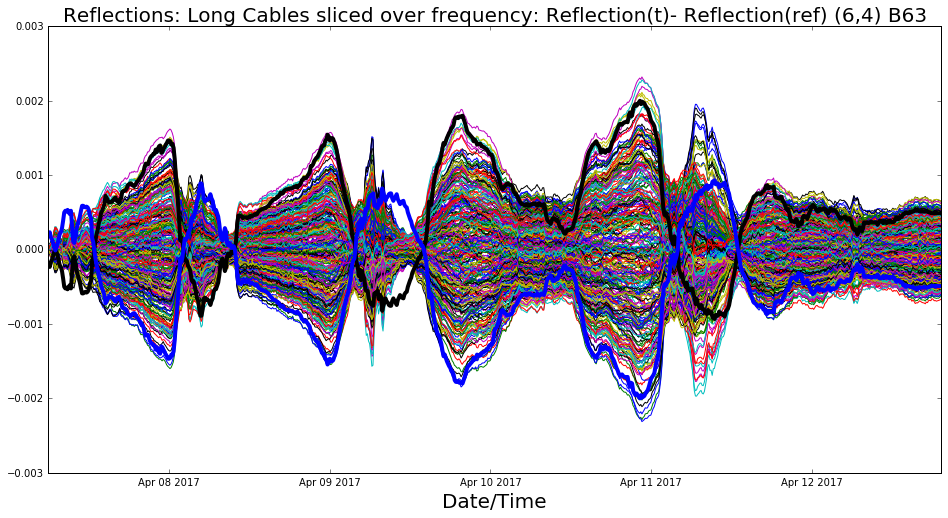

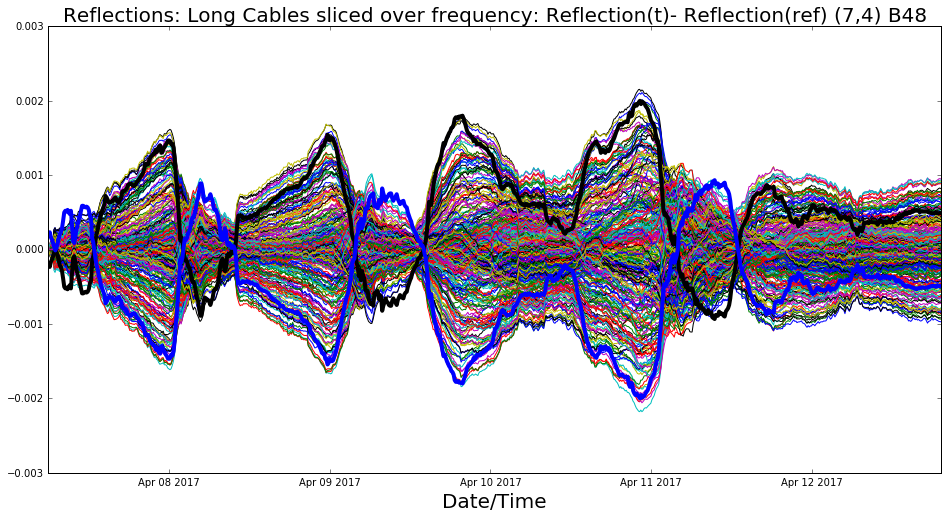

In [296]:
for k in range(len(corr_list)):
    for i in range(len(freq_phase[690:990])):
        plt.figure(k+1)
        plt.plot(date_stamp[0:800],value_all_long_600[k][:,freq-150+i])
    plt.plot(time_intercept_model[0:800],(-(2*((temp_intercept_model[0:800]+273)/10000 -0.057)+0.006+0.04)+0.003)-0.015, 'k',linewidth =4,label= ' Scaled Weather data ')   
    plt.plot(time_intercept_model[0:800],-((-(2*((temp_intercept_model[0:800]+273)/10000 -0.057)+0.006+0.04)+0.003)-0.015), 'b',linewidth =4,label= ' Scaled Weather data ')
    plt.title('Reflections: Long Cables sliced over frequency: Reflection(t)- Reflection(ref) %s' %(legend_crosscorr[k]), size=20) 
    
    plt.xlabel('Date/Time', size=20)              
    plt.xlabel('Date/Time', size=20)

# $$ {T}/{(Reflections_{Long Cables}(t) - Reflections_{Long Cables}(Ref))}$$


C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\ipykernel\__main__.py:4: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


2017-04-08 23:40:00
2017-04-08 23:37:20


C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\ipykernel\__main__.py:13: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


2017-04-08 23:40:00
2017-04-08 23:37:20


C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\ipykernel\__main__.py:23: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


2017-04-08 23:40:00
2017-04-08 23:37:20
Error in callback <function install_repl_displayhook.<locals>.post_execute at 0x000000000760A6A8> (for post_execute):


ValueError: 
$$value/temperature$$
^
Expected end of text (at char 0), (line:1, col:1)

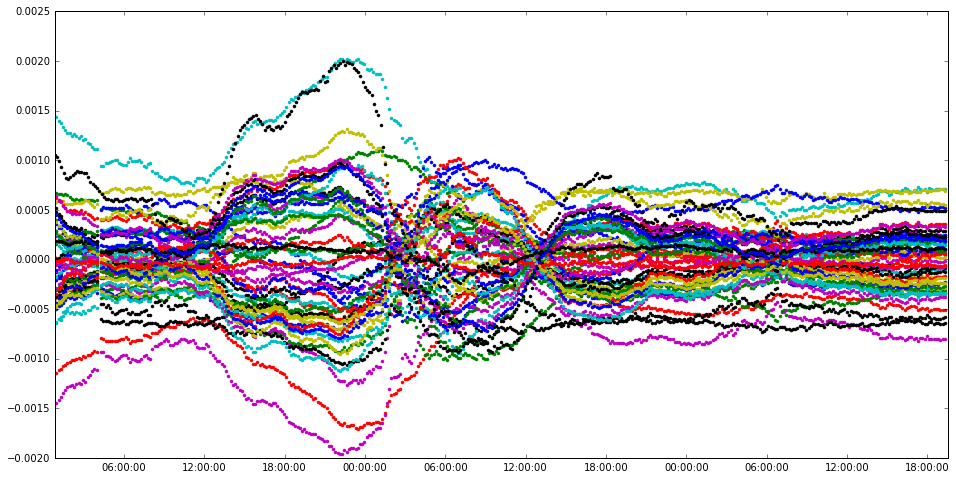

ValueError: 
$$value/temperature$$
^
Expected end of text (at char 0), (line:1, col:1)

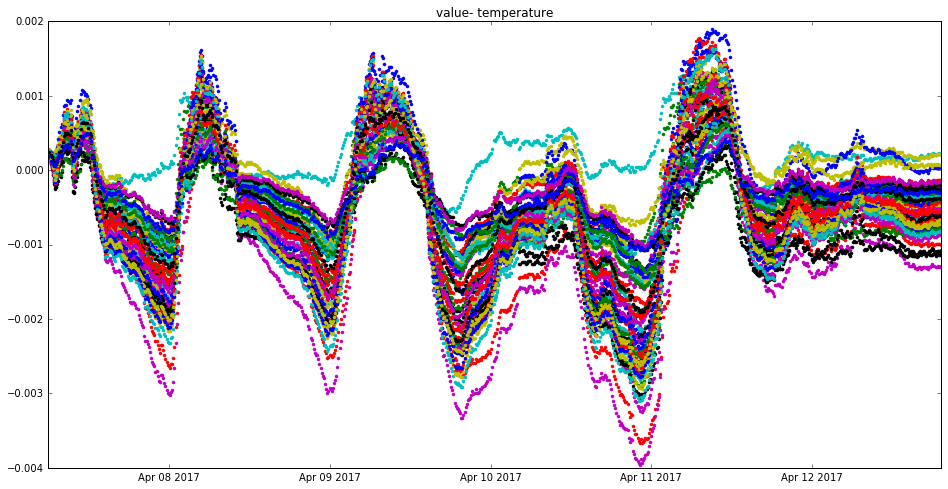

In [331]:
ddd= np.linspace(400,900, num=50)
for i in range(len(ddd)):
    plt.figure(1)
    plt.plot(date_stamp[0:800],value_all_long_600[1][:,ddd[i]],'.')
plt.plot(time_intercept_model[0:800],(-(2*((temp_intercept_model[0:800]+273)/10000 -0.057)+0.006+0.04)+0.003)-0.015, '.k', linewidth =4)
plt.xlim(time_intercept_model[400], time_intercept_model[800])
plt.title('temp and value_seperate')
plt.axvline(x=time_intercept_model[250])
print(time_intercept_model[250])
print(date_stamp[250])

for i in range(len(ddd)):
    plt.figure(2)
    plt.plot(date_stamp[0:800],value_all_long_600[1][:,ddd[i]]/((-(2*((temp_intercept_model[0:800]+273)/10000 -0.057)+0.006+0.04)+0.003)-0.015),'.')
#plt.plot(time_intercept_model[0:800],(-(2*((temp_intercept_model[0:800]+273)/10000 -0.057)+0.006+0.04)+0.003)-0.015, '.k', linewidth =4)
#plt.xlim(time_intercept_model[200], time_intercept_model[500])
#plt.axvline(x=time_intercept_model[250])
plt.title('value/temperature')
print(time_intercept_model[250])
print(date_stamp[250])

for i in range(len(ddd)):

    plt.figure(3)
    plt.plot(date_stamp[0:800],value_all_long_600[1][:,ddd[i]]-((-(2*((temp_intercept_model[0:800]+273)/10000 -0.057)+0.006+0.04)+0.003)-0.015),'.')

plt.title('value- temperature')
print(time_intercept_model[250])
print(date_stamp[250])

C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\ipykernel\__main__.py:3: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  app.launch_new_instance()


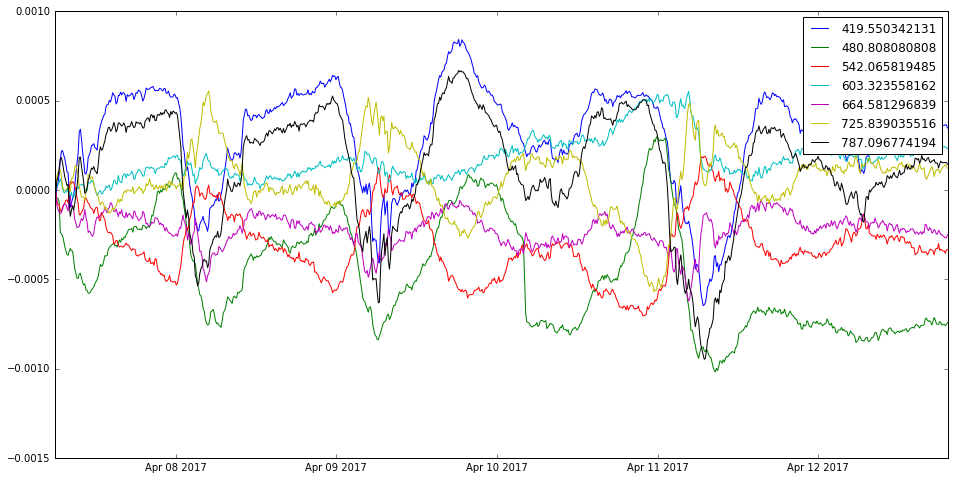

In [233]:
freq_sel = np.linspace(freq_phase[50], freq_phase[990],num=7)
for i in range(len(freq_sel)):
    plt.plot(date_stamp[0:800],value_all_long_600[1][:,freq_sel[i]], label=str(freq_sel[i]))
    plt.legend()

600.586510264
599.413489736
603.323558162


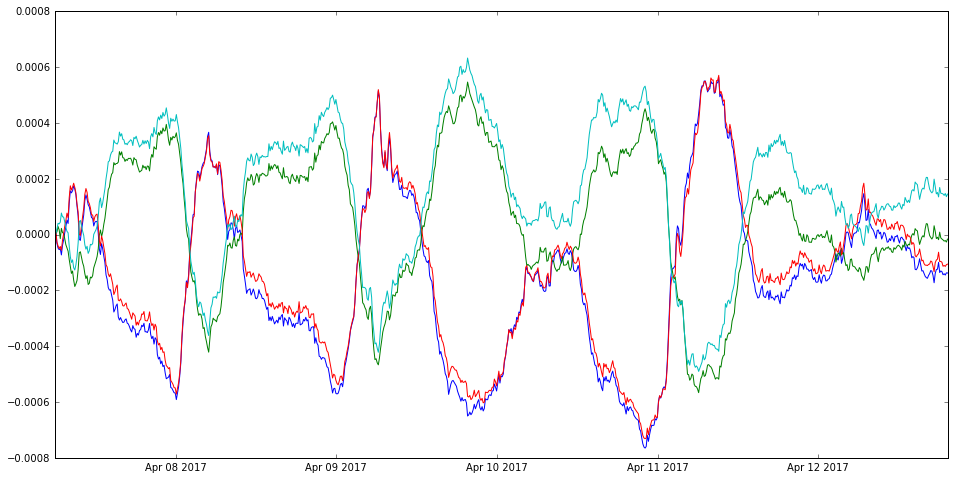

In [289]:
freq_phase[freq+42]
plt.figure(1)
plt.plot(date_stamp[0:800],-value_all_long_600[1][:,freq+43])
plt.plot(date_stamp[0:800],value_all_long_600[1][:,freq+42])
plt.plot(date_stamp[0:800],value_all_long_600[1][:,freq+40])
plt.plot(date_stamp[0:800],value_all_long_600[1][:,freq+55])
print(freq_phase[freq+43])
print(freq_phase[freq+40])
print(freq_phase[freq+50])

# i=1

0


C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\ipykernel\__main__.py:42: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\numpy\core\numeric.py:482: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


1
2
3
4
5
6


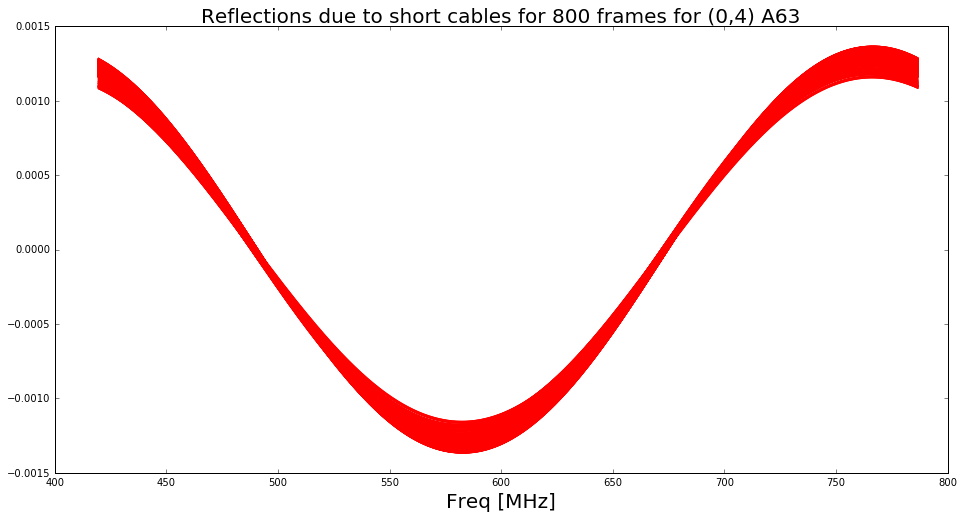

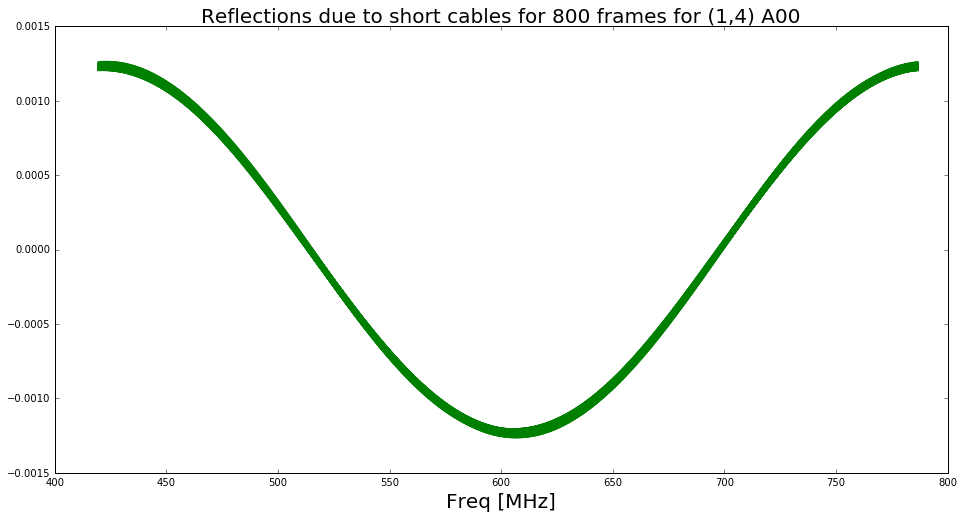

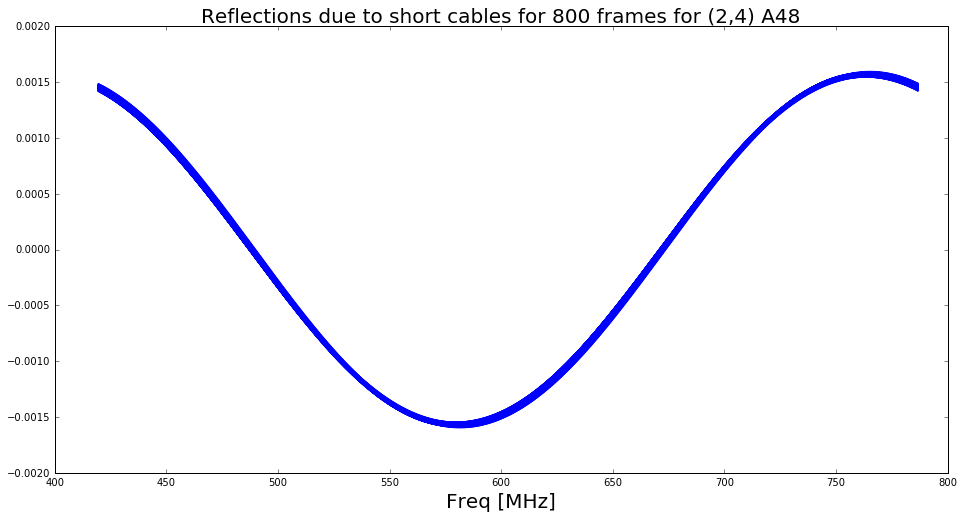

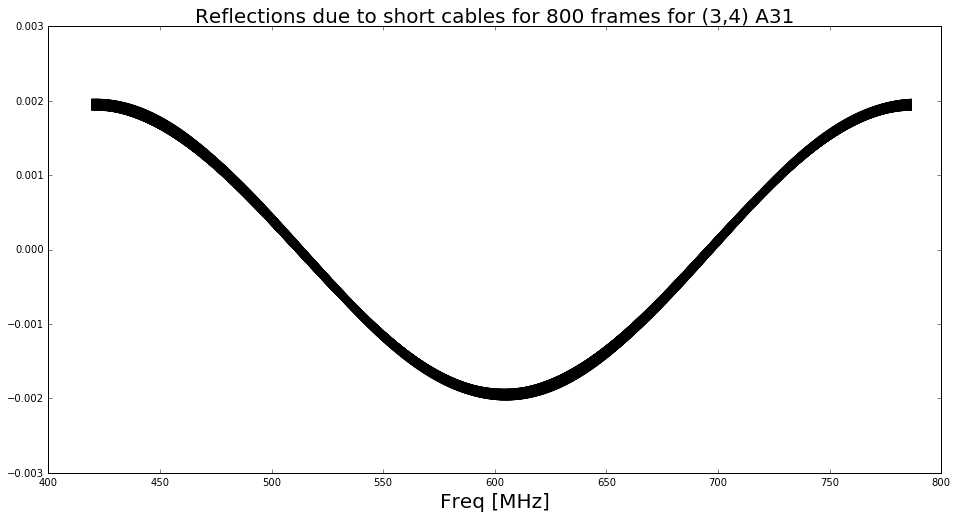

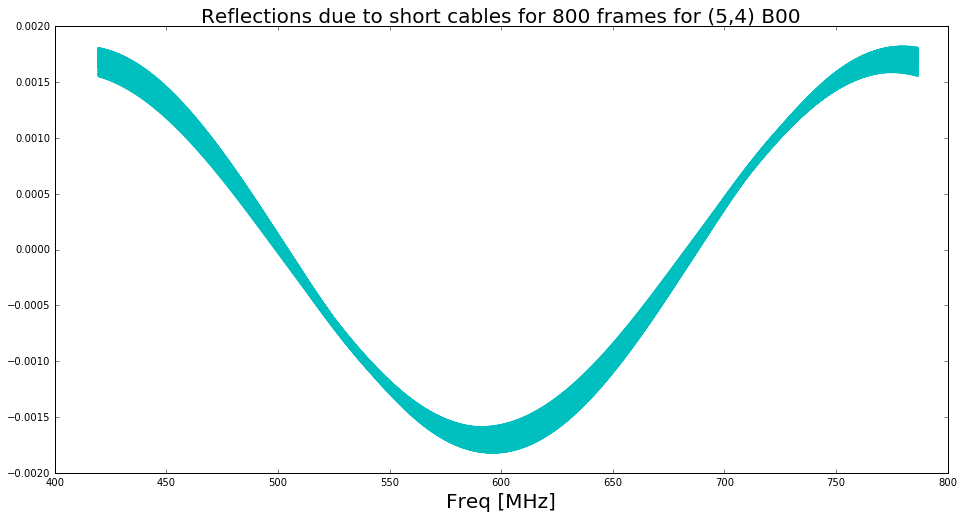

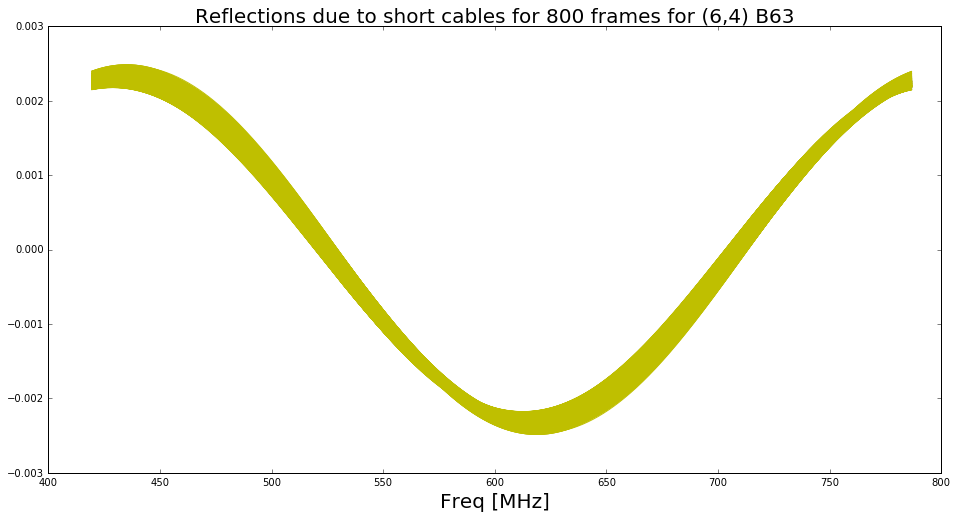

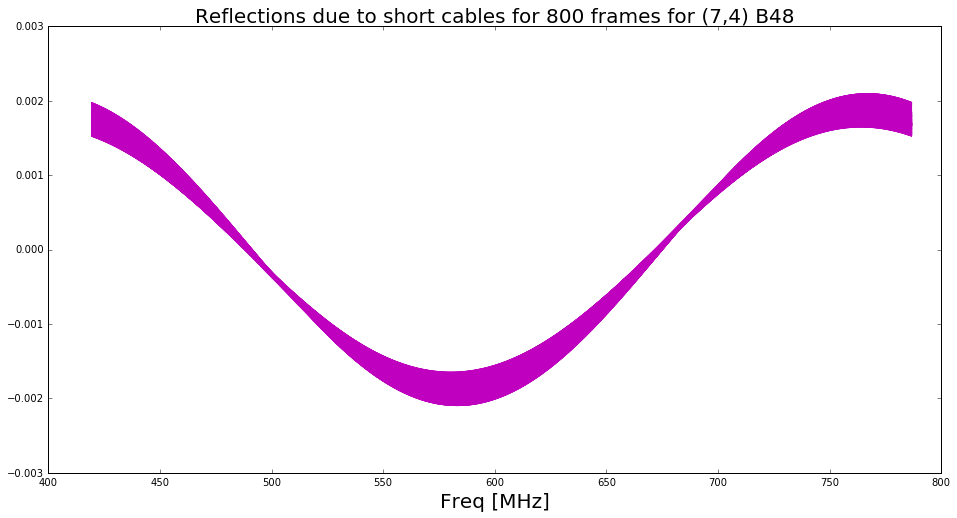

In [273]:
value_all_600 =[]

for i in range(len(corr_list)):
    value_all_600.append([])

for k in range(len(corr_list)):
    print(k)
    value_all_600[k] = np.zeros((800,len(freq_phase[50:990])))
    fft_reflections_ref=[]
    
    for ii in range(800):
        components=[]
        amplitude =[]
        z=np.polyfit(freq_phase[50:990], gain_all[ii,k,:],1)
        p=np.poly1d(z)
        gain_line_sub = gain_all[ii,k,:] - p(freq_phase[50:990])
        gain_all_line_sub.append(gain_line_sub)

        ifft_component = np.fft.ifft(gain_line_sub)  
        ifft_component0 = np.fft.ifft(gain_line_sub) 
        end = len(ifft_component)
        '''
        for i in range(end):
            if np.abs(ifft_component[i]) > 18*np.mean(np.abs(ifft_component)):#-np.mean(np.abs(ifft_component))/2:
                components.append(i)
                amplitude.append(np.abs(ifft_component[i]))
        '''        
        for i in range(end):
            if i==1:
                components.append(i)
                amplitude.append(np.abs(ifft_component[i]))
        
        for i in range(len(ifft_component)):
            if i not in components: 
                ifft_component0[i] = 0
        
        fft_reflections = np.fft.fft(ifft_component0) 
        if ii==0:
            fft_reflections_ref = fft_reflections
        
        for kk in range(len(freq_phase[50:990])):
            value_all_600[k][ii][kk] = fft_reflections[kk] - fft_reflections_ref[kk]
    
        plt.figure(k+1)
        plt.plot(freq_phase[50:990],fft_reflections, color=colors[k])
        plt.title('Reflections due to short cable (Time Bin i==1) for 800 frames for %s' %(legend_crosscorr[k]), size=20)
        plt.xlabel('Freq [MHz]', size=20)
    #plt.savefig('reflection_i==1 %s.png' %(legend_crosscorr[k]))

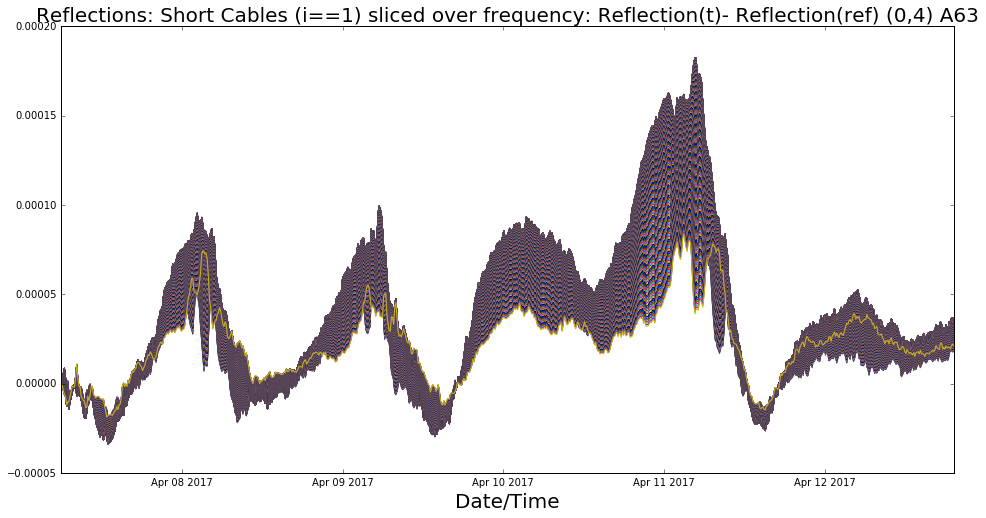

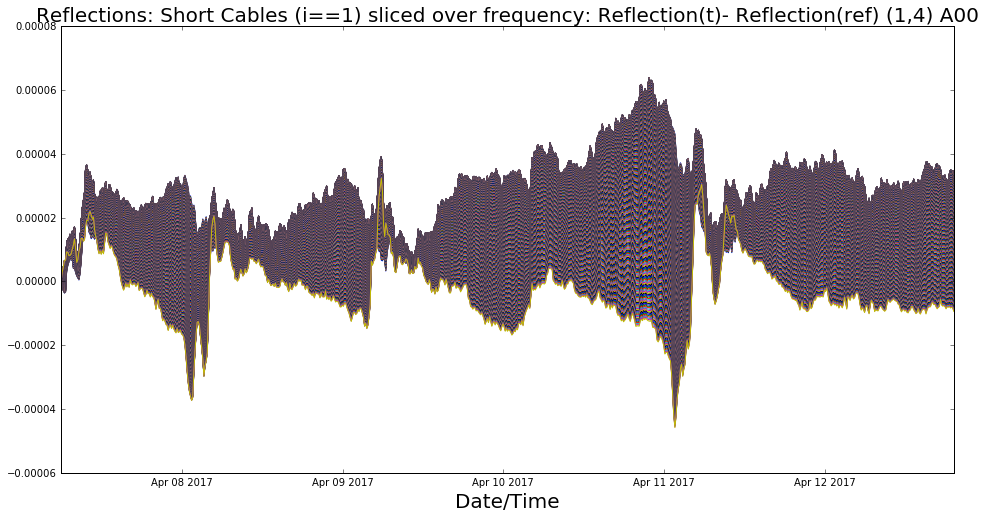

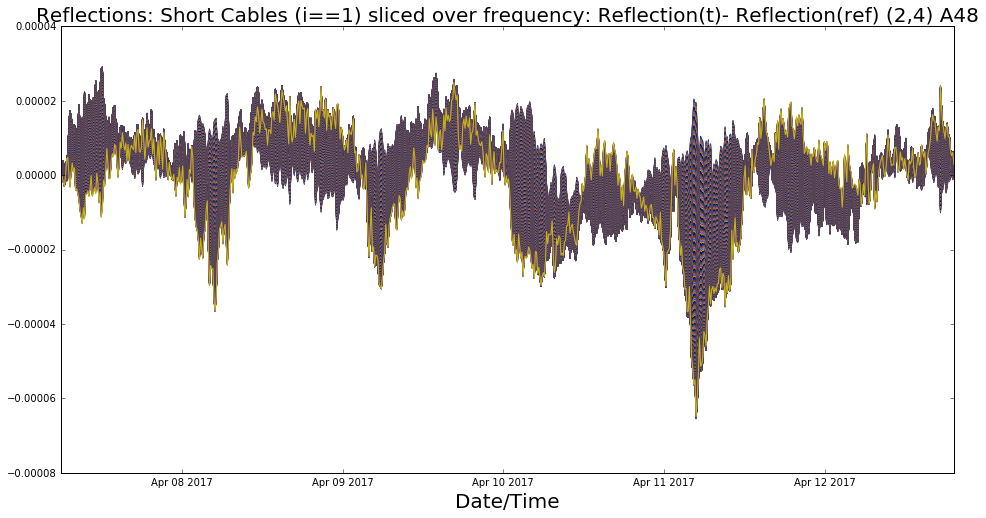

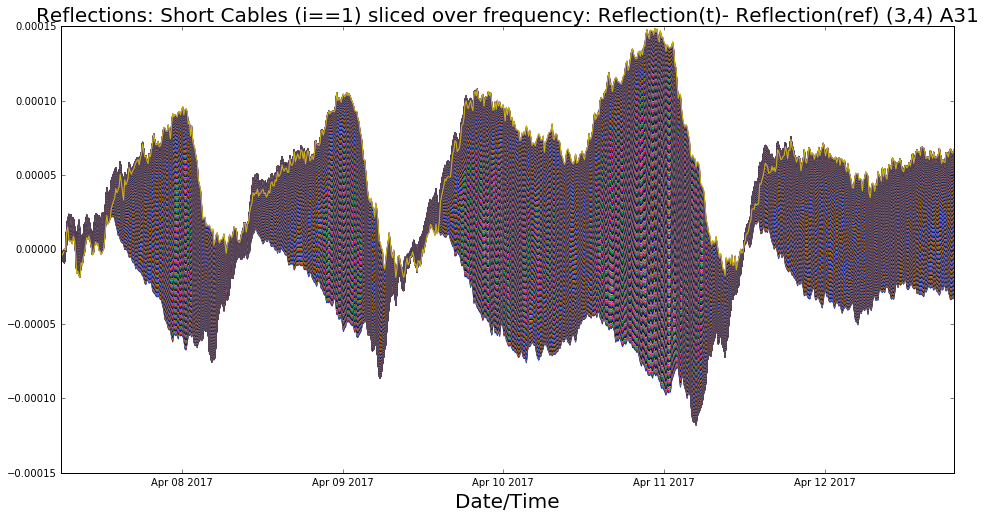

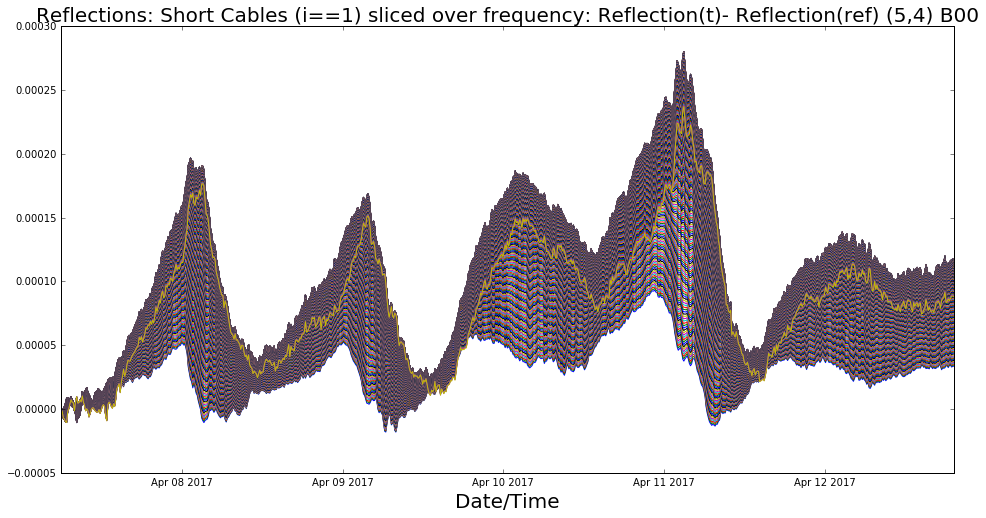

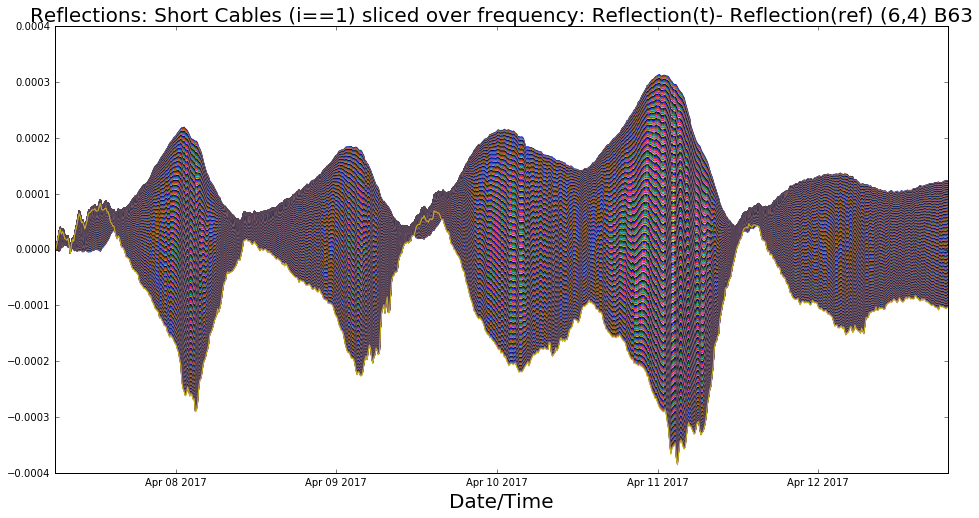

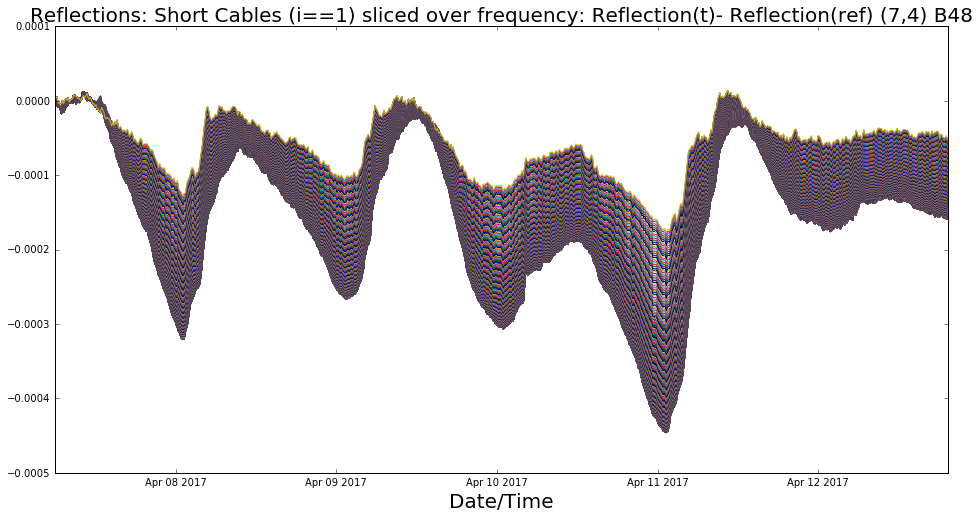

In [278]:
for k in range(len(corr_list)):
    for i in range(len(freq_phase[690:990])):
        plt.figure(k+1)
        plt.plot(date_stamp[0:800],value_all_600[k][:,freq-150+i])
    #plt.plot(time_intercept_model[0:800],-(2*((temp_intercept_model[0:800]+273)/15000 -0.057)+0.006+0.04)+0.003-0.033, 'k',linewidth =4,label= ' Scaled Weather data ')   
    #plt.plot(time_intercept_model[0:800],-(-(2*((temp_intercept_model[0:800]+273)/8000 -0.057)+0.006+0.04)+0.003), 'b',linewidth =4,label= ' Scaled Weather data ')
    plt.title('Reflections: Short Cables (i==1) sliced over frequency: Reflection(t)- Reflection(ref) %s' %(legend_crosscorr[k]), size=20) 
    plt.xlabel('Date/Time', size=20)

# i=2

0


C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\ipykernel\__main__.py:42: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\sidhant\Anaconda3\envs\py3k\lib\site-packages\numpy\core\numeric.py:482: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


1
2
3
4
5
6


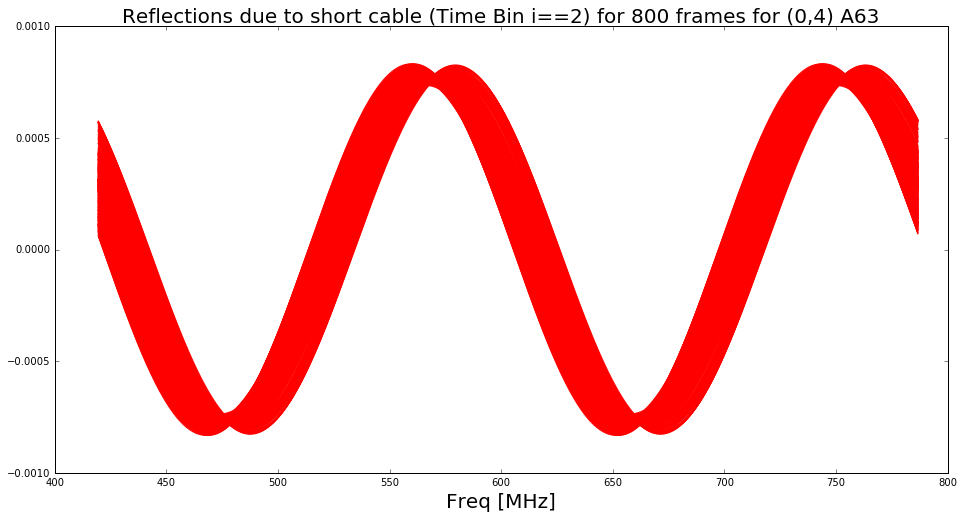

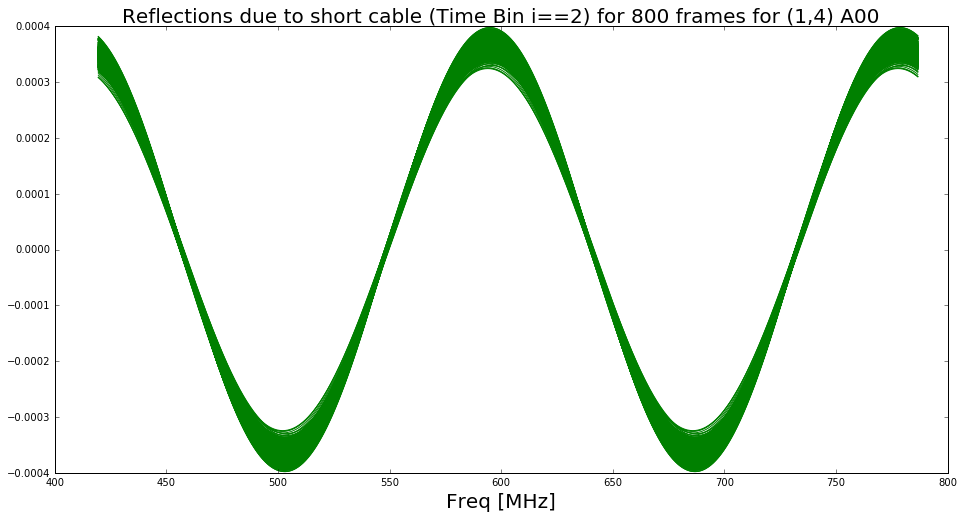

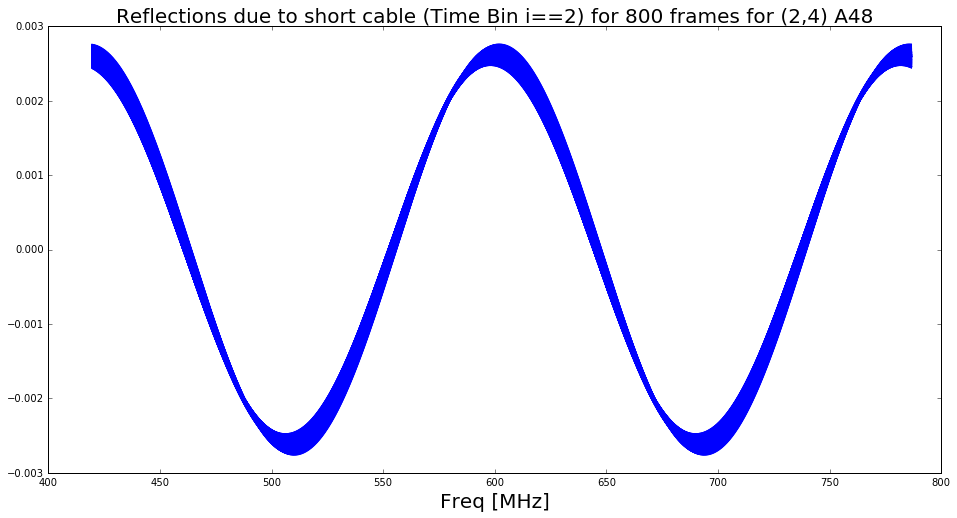

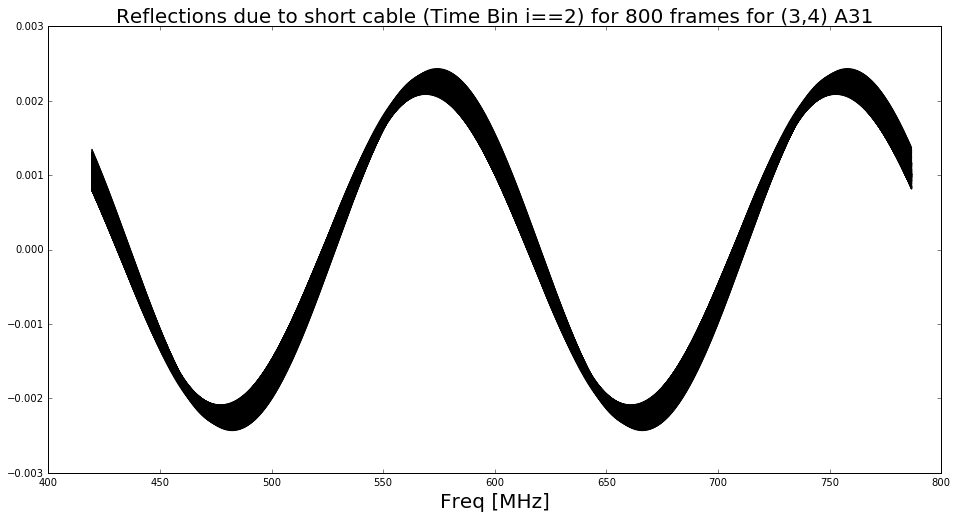

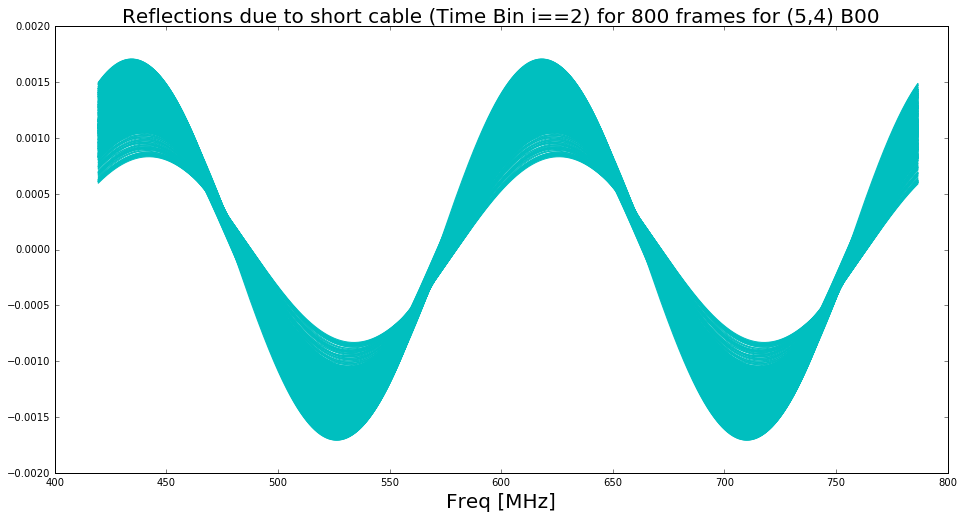

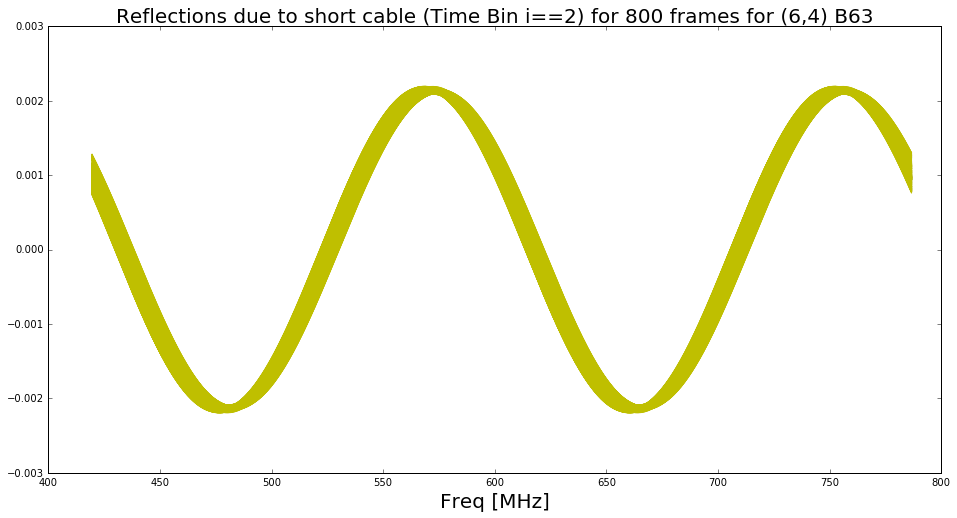

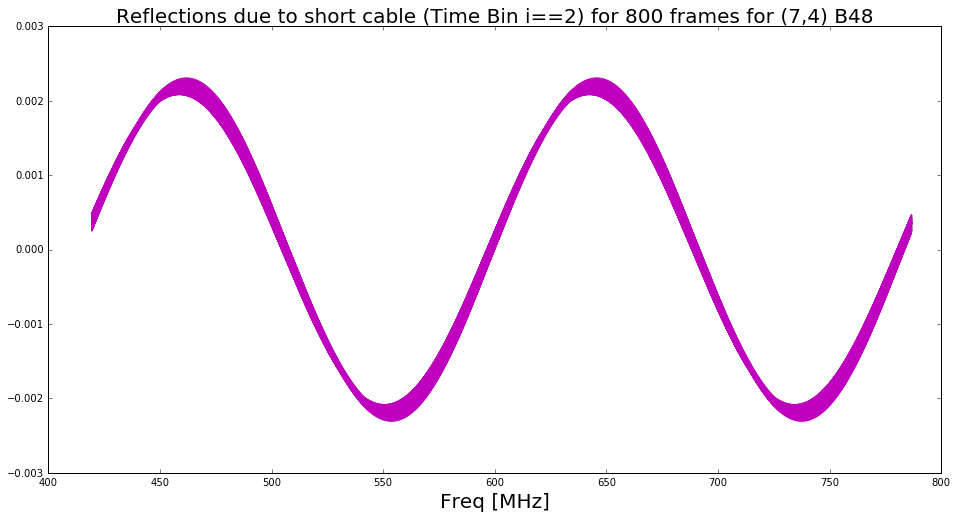

In [279]:
value_all_600 =[]

for i in range(len(corr_list)):
    value_all_600.append([])

for k in range(len(corr_list)):
    print(k)
    value_all_600[k] = np.zeros((800,len(freq_phase[50:990])))
    fft_reflections_ref=[]
    
    for ii in range(800):
        components=[]
        amplitude =[]
        z=np.polyfit(freq_phase[50:990], gain_all[ii,k,:],1)
        p=np.poly1d(z)
        gain_line_sub = gain_all[ii,k,:] - p(freq_phase[50:990])
        gain_all_line_sub.append(gain_line_sub)

        ifft_component = np.fft.ifft(gain_line_sub)  
        ifft_component0 = np.fft.ifft(gain_line_sub) 
        end = len(ifft_component)
        '''
        for i in range(end):
            if np.abs(ifft_component[i]) > 18*np.mean(np.abs(ifft_component)):#-np.mean(np.abs(ifft_component))/2:
                components.append(i)
                amplitude.append(np.abs(ifft_component[i]))
        '''        
        for i in range(end):
            if i==2:
                components.append(i)
                amplitude.append(np.abs(ifft_component[i]))
        
        for i in range(len(ifft_component)):
            if i not in components: 
                ifft_component0[i] = 0
        
        fft_reflections = np.fft.fft(ifft_component0) 
        if ii==0:
            fft_reflections_ref = fft_reflections
        
        for kk in range(len(freq_phase[50:990])):
            value_all_600[k][ii][kk] = fft_reflections[kk] - fft_reflections_ref[kk]
    
        plt.figure(k+1)
        plt.plot(freq_phase[50:990],fft_reflections, color=colors[k])
        plt.title('Reflections due to short cable (Time Bin i==2) for 800 frames for %s' %(legend_crosscorr[k]), size=20)
        plt.xlabel('Freq [MHz]', size=20)
    #plt.savefig('reflection_i==1 %s.png' %(legend_crosscorr[k]))

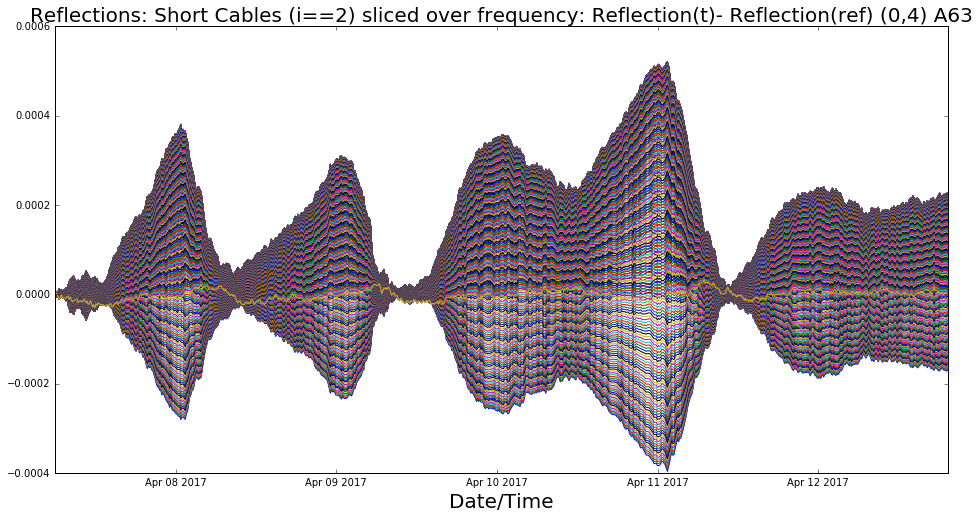

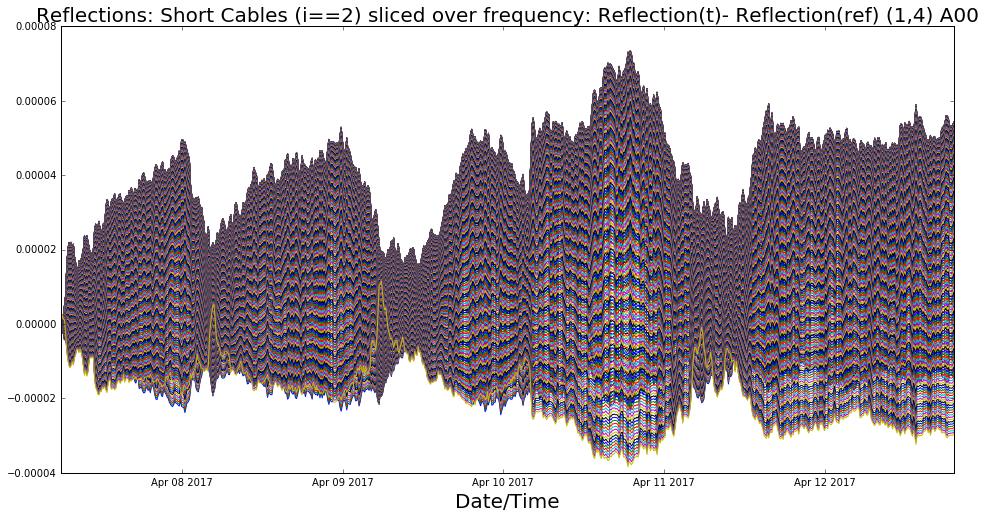

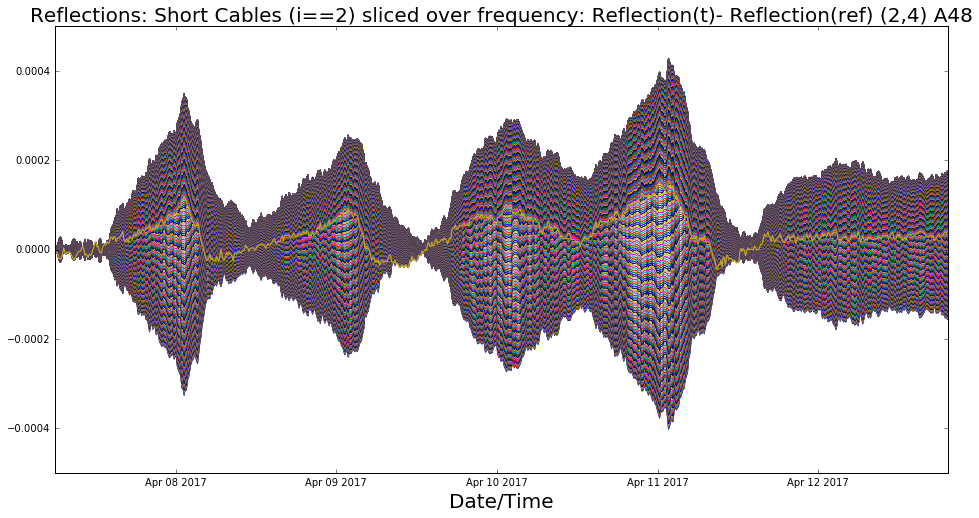

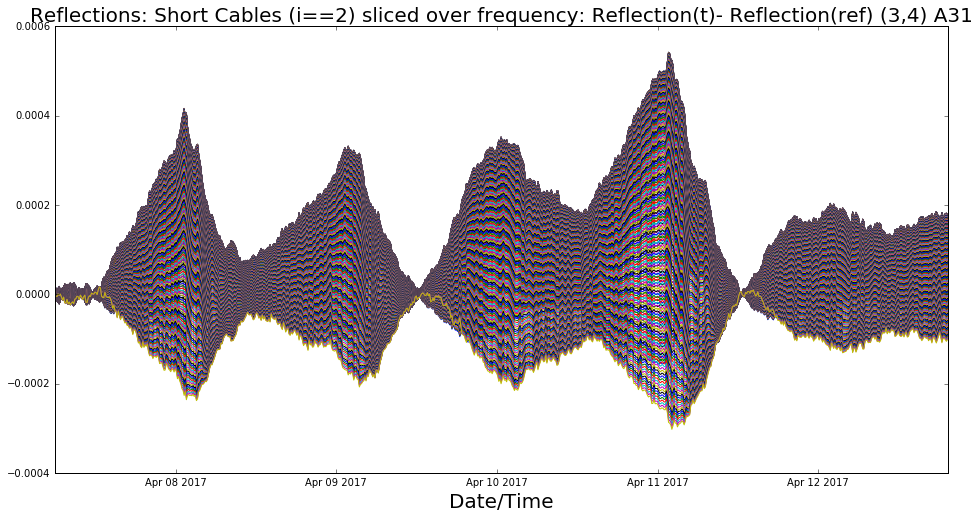

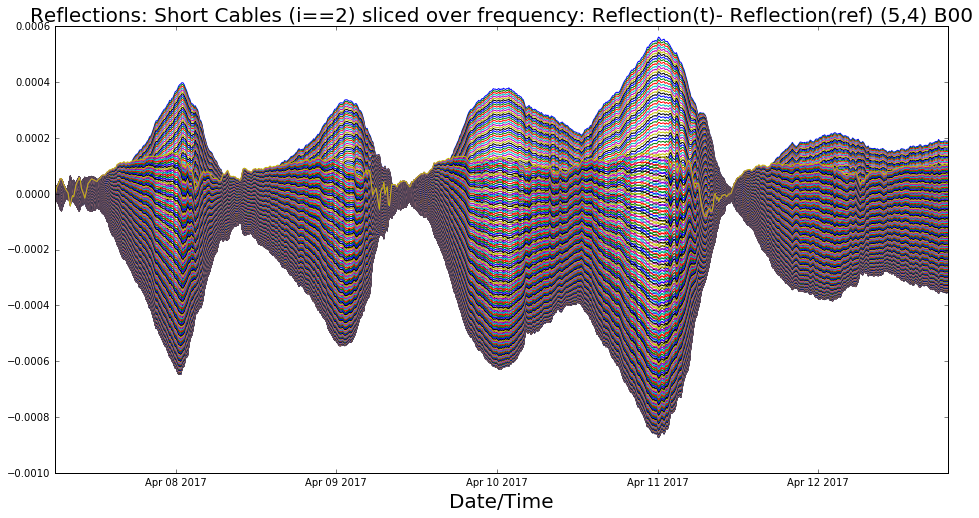

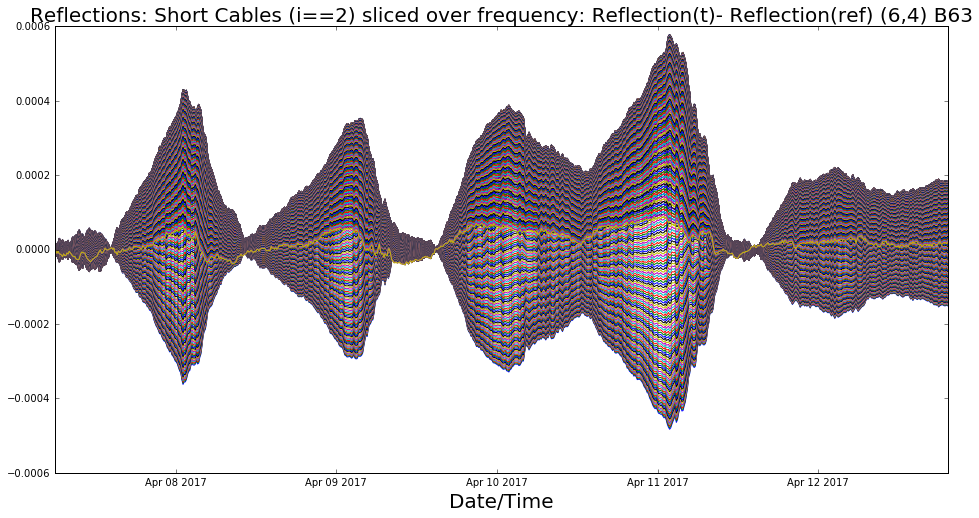

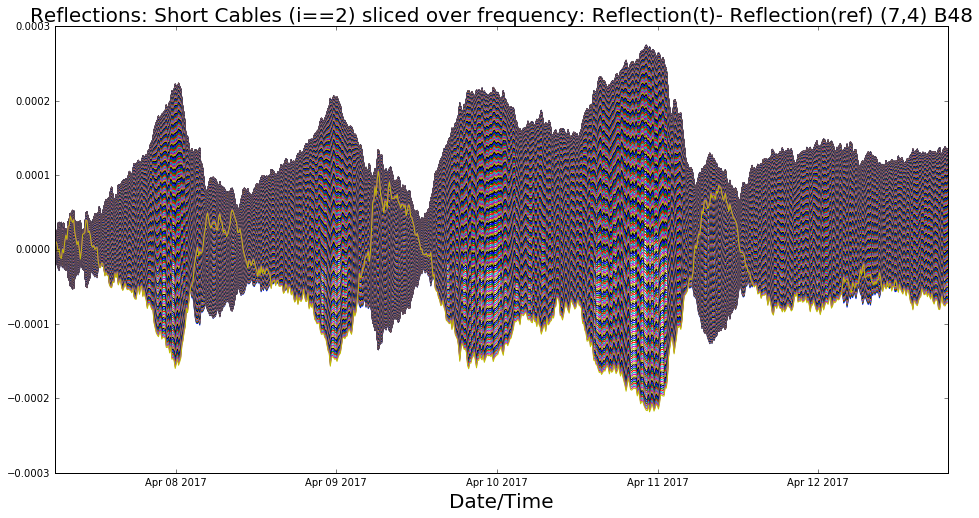

In [280]:
for k in range(len(corr_list)):
    for i in range(len(freq_phase[690:990])):
        plt.figure(k+1)
        plt.plot(date_stamp[0:800],value_all_600[k][:,freq-150+i])
    #plt.plot(time_intercept_model[0:800],-(2*((temp_intercept_model[0:800]+273)/15000 -0.057)+0.006+0.04)+0.003-0.033, 'k',linewidth =4,label= ' Scaled Weather data ')   
    #plt.plot(time_intercept_model[0:800],-(-(2*((temp_intercept_model[0:800]+273)/8000 -0.057)+0.006+0.04)+0.003), 'b',linewidth =4,label= ' Scaled Weather data ')
    plt.title('Reflections: Short Cables (i==2) sliced over frequency: Reflection(t)- Reflection(ref) %s' %(legend_crosscorr[k]), size=20) 
    plt.xlabel('Date/Time', size=20)

In [ ]:
#